### Some code for marker gene screening

In [1]:
import scanpy as sc
import pandas as pd
import numpy as np
import anndata as ad
import seaborn as sns
import pylab as plt
import pickle
from matplotlib import rcParams
sc.set_figure_params(dpi=150, color_map='viridis')
rcParams["image.aspect"] = "equal"

sc.settings.verbosity = 2
sc.logging.print_versions()

-----
anndata     0.7.5
scanpy      1.6.0
sinfo       0.3.1
-----
PIL                 8.1.0
anndata             0.7.5
anyio               NA
asciitree           NA
attr                20.3.0
babel               2.9.0
backcall            0.2.0
brotli              NA
certifi             2020.12.05
cffi                1.14.4
chardet             4.0.0
cloudpickle         1.6.0
colorama            0.4.4
constants           NA
cycler              0.10.0
cython_runtime      NA
dask                2020.12.0
dateutil            2.8.1
decorator           4.4.2
fasteners           NA
get_version         2.1
google              NA
h5py                3.1.0
highs_wrapper       NA
idna                2.10
igraph              0.8.3
ipykernel           5.4.2
ipython_genutils    0.2.0
jedi                0.18.0
jinja2              2.11.2
joblib              1.0.0
json5               NA
jsonschema          3.2.0
jupyter_server      1.2.1
jupyterlab_server   2.1.1
kiwisolver          1.3.1
legacy_api_wra

In [9]:
adata
adata.write('pre_pseudo_adata.h5ad',compression= gizp)

AnnData object with n_obs × n_vars = 2033 × 12094
    obs: 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'percent_mito', 'n_genes', 'leiden', 'major_split', 'mINP', 'GMC', 'iN', 'mN', 'glia', 'astrocyte'
    var: 'n_cells', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'highly_variable', 'means', 'dispersions', 'dispersions_norm'
    uns: 'log1p', 'hvg', 'pca', 'neighbors', 'umap', 'leiden', 'leiden_colors', 'major_split_colors', 'rank_genes_groups', "dendrogram_['leiden']"
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    obsp: 'distances', 'connectivities'

In [2]:
adata = sc.read("pre_pseudo_adata.h5ad")

In [3]:
adata

AnnData object with n_obs × n_vars = 2033 × 12094
    obs: 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'percent_mito', 'n_genes', 'leiden', 'major_split', 'mINP', 'GMC', 'iN', 'mN', 'glia', 'astrocyte'
    var: 'n_cells', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'highly_variable', 'means', 'dispersions', 'dispersions_norm'
    uns: "dendrogram_['leiden']", 'hvg', 'leiden', 'leiden_colors', 'major_split_colors', 'neighbors', 'pca', 'rank_genes_groups', 'umap'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    obsp: 'connectivities', 'distances'

## Pseudotime analysis using Palantir 

#### Unpackaged pseudo time calc

#### Packaged & Normed imputation pseudo time calc

In [4]:
import palantir
from sklearn.preprocessing import minmax_scale

def pseudo_time_calc (adata):
    '''
    calculate gene pseudotime trend with palantir
    normalize imputed with min_max and store as an anndata layer
    '''
    a = adata.to_df()
    result = None

    pca = pd.DataFrame(adata.obsm["X_pca"], index=adata.obs.index)

    dm_res = palantir.utils.run_diffusion_maps(pca, knn=20)
    ms_data = palantir.utils.determine_multiscale_space(dm_res)

    imp_df = palantir.utils.run_magic_imputation(a, dm_res,n_steps=1) 

    start_cell = "TCATGTTGTTCTGACA"
        
    while result is None:
        try:

            pr_res = palantir.core.run_palantir(ms_data, start_cell, 
                                    terminal_states=None,
                                    num_waypoints=500, 
                                    scale_components=True, n_jobs=1)
            adata.obs["pseudotime"] = pr_res.pseudotime[adata.obs.index]
            adata.obs["differentiation_potential"] = pr_res.entropy[adata.obs.index]
            result = pr_res.pseudotime
            pseudo_time_stuff = dict()
            pseudo_time_stuff["imp"] = imp_df
            pseudo_time_stuff["res"] = pr_res
            print("Pseudo time calculation done.")
        except ValueError:
            print("Not converging. Trying again.")
            print()
    # column-wise normalize imputed expression and add to adata layer
    min_max_norm_impdf = pd.DataFrame(index = imp_df.index)
    for index,col in imp_df.iteritems():
        normed = minmax_scale(col)
        min_max_norm_impdf[index] = normed 
    #1 min    
    adata.layers["normed_imp"] = min_max_norm_impdf 
    adata.layers["imp_df"] = imp_df
            
    return pseudo_time_stuff,min_max_norm_impdf,imp_df



# Run the function
pseudotime_dict,normed_imp,imp_df = pseudo_time_calc(adata)
print("2 dicts done.")

findfont: Font family ['Raleway'] not found. Falling back to DejaVu Sans.
findfont: Font family ['Lato'] not found. Falling back to DejaVu Sans.


Determing nearest neighbor graph...
computing neighbors
    finished (0:00:02)


/opt/miniconda3/envs/bioinformatics/lib/python3.8/site-packages/palantir/utils.py:43: FutureWarning: This location for 'distances' is deprecated. It has been moved to .obsp[distances], and will not be accesible here in a future version of anndata.
  kNN = temp.uns["neighbors"]["distances"]


Sampling and flocking waypoints...
Time for determining waypoints: 0.0014967878659566244 minutes
Determining pseudotime...
Shortest path distances using 30-nearest neighbor graph...
Time for shortest paths: 0.031494919459025064 minutes
Iteratively refining the pseudotime...
Correlation at iteration 1: 0.9998
Correlation at iteration 2: 1.0000
Entropy and branch probabilities...
Markov chain construction...
Identification of terminal states...
Computing fundamental matrix and absorption probabilities...
Project results to all cells...
Pseudo time calculation done.
2 dicts done.


In [7]:
from pygam import PoissonGAM,s,f
from sklearn.preprocessing import StandardScaler
from pygam.utils import OptimizationError
import scipy.sparse


full_list_of_genes = adata.var.index.to_list()

def get_pygam_param_and_deritive(pseudo_calc_dict,orig_imp, gene_list,w ,num_spline=6,spline_o=3,lamda= 1):
    '''
    Using Poisson distribution to force things to be positive
    
    
    '''
    x = pseudo_calc_dict["res"].pseudotime
    length = len(x)
    x = x.values.reshape(length,1)
    y = orig_imp
    #param = np.empty([0,20]) #forced to how many paramters
   
    length = len(x)

    gene_not_converge = []
    qualified_genes = []
    
    param = pd.DataFrame(columns=np.arange(200))
    gradient = pd.DataFrame(columns=np.arange(200))

    for i in range(len(gene_list)):
        gam = PoissonGAM(s(0, n_splines = num_spline,spline_order =spline_o ,lam =lamda),fit_intercept=False,verbose = True)
        y_i =y[gene_list[i]].values.reshape(length,1) 
        try:
            
            gam.gridsearch(x,y_i) #,wights = weight

            XX = gam.generate_X_grid(term=0, n=200)
        
            predict_gam = gam.predict(X =XX) # set subzero values to zero for the red line 
            
            ## screen out low expression genes
            count_for_exp_point = np.sum(predict_gam < 0.25)
 
            if count_for_exp_point < 150:   # 75% of 200
                #pos =[predict_gam[25],predict_gam[75],predict_gam[125],predict_gam[175],predict_gam[225],predict_gam[275],predict_gam[325],predict_gam[375],predict_gam[425],predict_gam[475]]
                #pos = np.array(pos).reshape(1,10)
                #param =  np.concatenate((param,pos),axis = 0)
                qualified_genes.append(gene_list[i])
                param = param.append([pd.Series(predict_gam)],ignore_index=True)
                current_gradient  = np.gradient(predict_gam)
                gradient = gradient.append(pd.Series(current_gradient),ignore_index=True)
                
        except OptimizationError:
            gene_not_converge.append(gene_list[i])
            
        if (i%100 == 0):
            print(str(round(100 * i / len(gene_list), 1)) + " % of trends fit")
   
    param.index = qualified_genes
    gradient.index = qualified_genes
            
        
    return param,gradient,qualified_genes


In [8]:
new_param,gradient,qualified_genes = get_pygam_param_and_deritive(pseudotime_dict,normed_imp,full_list_of_genes,w = None)

N/A% (0 of 11) |                         | Elapsed Time: 0:00:00 ETA:  --:--:--/home/wjcao/.local/lib/python3.8/site-packages/pygam/utils.py:78: UserWarning: Could not import Scikit-Sparse or Suite-Sparse.
This will slow down optimization for models with monotonicity/convexity penalties and many splines.
See installation instructions for installing Scikit-Sparse and Suite-Sparse via Conda.
  warnings.warn(msg)
100% (11 of 11) |########################| Elapsed Time: 0:00:00 Time:  0:00:00
N/A% (0 of 11) |                         | Elapsed Time: 0:00:00 ETA:  --:--:--/home/wjcao/.local/lib/python3.8/site-packages/pygam/utils.py:78: UserWarning: Could not import Scikit-Sparse or Suite-Sparse.
This will slow down optimization for models with monotonicity/convexity penalties and many splines.
See installation instructions for installing Scikit-Sparse and Suite-Sparse via Conda.
  warnings.warn(msg)
100% (11 of 11) |########################| Elapsed Time: 0:00:00 Time:  0:00:00
N/A% (0 of 1

0.0 % of trends fit


100% (11 of 11) |########################| Elapsed Time: 0:00:00 Time:  0:00:00
N/A% (0 of 11) |                         | Elapsed Time: 0:00:00 ETA:  --:--:--/home/wjcao/.local/lib/python3.8/site-packages/pygam/utils.py:78: UserWarning: Could not import Scikit-Sparse or Suite-Sparse.
This will slow down optimization for models with monotonicity/convexity penalties and many splines.
See installation instructions for installing Scikit-Sparse and Suite-Sparse via Conda.
  warnings.warn(msg)
100% (11 of 11) |########################| Elapsed Time: 0:00:00 Time:  0:00:00
N/A% (0 of 11) |                         | Elapsed Time: 0:00:00 ETA:  --:--:--/home/wjcao/.local/lib/python3.8/site-packages/pygam/utils.py:78: UserWarning: Could not import Scikit-Sparse or Suite-Sparse.
This will slow down optimization for models with monotonicity/convexity penalties and many splines.
See installation instructions for installing Scikit-Sparse and Suite-Sparse via Conda.
  warnings.warn(msg)
100% (11 of 

0.8 % of trends fit


100% (11 of 11) |########################| Elapsed Time: 0:00:00 Time:  0:00:00
N/A% (0 of 11) |                         | Elapsed Time: 0:00:00 ETA:  --:--:--/home/wjcao/.local/lib/python3.8/site-packages/pygam/utils.py:78: UserWarning: Could not import Scikit-Sparse or Suite-Sparse.
This will slow down optimization for models with monotonicity/convexity penalties and many splines.
See installation instructions for installing Scikit-Sparse and Suite-Sparse via Conda.
  warnings.warn(msg)
100% (11 of 11) |########################| Elapsed Time: 0:00:00 Time:  0:00:00
N/A% (0 of 11) |                         | Elapsed Time: 0:00:00 ETA:  --:--:--/home/wjcao/.local/lib/python3.8/site-packages/pygam/utils.py:78: UserWarning: Could not import Scikit-Sparse or Suite-Sparse.
This will slow down optimization for models with monotonicity/convexity penalties and many splines.
See installation instructions for installing Scikit-Sparse and Suite-Sparse via Conda.
  warnings.warn(msg)
100% (11 of 

1.7 % of trends fit


100% (11 of 11) |########################| Elapsed Time: 0:00:00 Time:  0:00:00
N/A% (0 of 11) |                         | Elapsed Time: 0:00:00 ETA:  --:--:--/home/wjcao/.local/lib/python3.8/site-packages/pygam/utils.py:78: UserWarning: Could not import Scikit-Sparse or Suite-Sparse.
This will slow down optimization for models with monotonicity/convexity penalties and many splines.
See installation instructions for installing Scikit-Sparse and Suite-Sparse via Conda.
  warnings.warn(msg)
100% (11 of 11) |########################| Elapsed Time: 0:00:00 Time:  0:00:00
N/A% (0 of 11) |                         | Elapsed Time: 0:00:00 ETA:  --:--:--/home/wjcao/.local/lib/python3.8/site-packages/pygam/utils.py:78: UserWarning: Could not import Scikit-Sparse or Suite-Sparse.
This will slow down optimization for models with monotonicity/convexity penalties and many splines.
See installation instructions for installing Scikit-Sparse and Suite-Sparse via Conda.
  warnings.warn(msg)
100% (11 of 

2.5 % of trends fit


100% (11 of 11) |########################| Elapsed Time: 0:00:00 Time:  0:00:00
N/A% (0 of 11) |                         | Elapsed Time: 0:00:00 ETA:  --:--:--/home/wjcao/.local/lib/python3.8/site-packages/pygam/utils.py:78: UserWarning: Could not import Scikit-Sparse or Suite-Sparse.
This will slow down optimization for models with monotonicity/convexity penalties and many splines.
See installation instructions for installing Scikit-Sparse and Suite-Sparse via Conda.
  warnings.warn(msg)
100% (11 of 11) |########################| Elapsed Time: 0:00:00 Time:  0:00:00
N/A% (0 of 11) |                         | Elapsed Time: 0:00:00 ETA:  --:--:--/home/wjcao/.local/lib/python3.8/site-packages/pygam/utils.py:78: UserWarning: Could not import Scikit-Sparse or Suite-Sparse.
This will slow down optimization for models with monotonicity/convexity penalties and many splines.
See installation instructions for installing Scikit-Sparse and Suite-Sparse via Conda.
  warnings.warn(msg)
100% (11 of 

3.3 % of trends fit


100% (11 of 11) |########################| Elapsed Time: 0:00:00 Time:  0:00:00
N/A% (0 of 11) |                         | Elapsed Time: 0:00:00 ETA:  --:--:--/home/wjcao/.local/lib/python3.8/site-packages/pygam/utils.py:78: UserWarning: Could not import Scikit-Sparse or Suite-Sparse.
This will slow down optimization for models with monotonicity/convexity penalties and many splines.
See installation instructions for installing Scikit-Sparse and Suite-Sparse via Conda.
  warnings.warn(msg)
100% (11 of 11) |########################| Elapsed Time: 0:00:00 Time:  0:00:00
N/A% (0 of 11) |                         | Elapsed Time: 0:00:00 ETA:  --:--:--/home/wjcao/.local/lib/python3.8/site-packages/pygam/utils.py:78: UserWarning: Could not import Scikit-Sparse or Suite-Sparse.
This will slow down optimization for models with monotonicity/convexity penalties and many splines.
See installation instructions for installing Scikit-Sparse and Suite-Sparse via Conda.
  warnings.warn(msg)
100% (11 of 

4.1 % of trends fit


100% (11 of 11) |########################| Elapsed Time: 0:00:00 Time:  0:00:00
N/A% (0 of 11) |                         | Elapsed Time: 0:00:00 ETA:  --:--:--/home/wjcao/.local/lib/python3.8/site-packages/pygam/utils.py:78: UserWarning: Could not import Scikit-Sparse or Suite-Sparse.
This will slow down optimization for models with monotonicity/convexity penalties and many splines.
See installation instructions for installing Scikit-Sparse and Suite-Sparse via Conda.
  warnings.warn(msg)
100% (11 of 11) |########################| Elapsed Time: 0:00:00 Time:  0:00:00
N/A% (0 of 11) |                         | Elapsed Time: 0:00:00 ETA:  --:--:--/home/wjcao/.local/lib/python3.8/site-packages/pygam/utils.py:78: UserWarning: Could not import Scikit-Sparse or Suite-Sparse.
This will slow down optimization for models with monotonicity/convexity penalties and many splines.
See installation instructions for installing Scikit-Sparse and Suite-Sparse via Conda.
  warnings.warn(msg)
100% (11 of 

5.0 % of trends fit


/home/wjcao/.local/lib/python3.8/site-packages/pygam/pygam.py:1111: RuntimeWarning: divide by zero encountered in double_scalars
  r2['explained_deviance'] = 1. - full_d.sum()/null_d.sum()
/home/wjcao/.local/lib/python3.8/site-packages/pygam/pygam.py:1112: RuntimeWarning: divide by zero encountered in double_scalars
  r2['McFadden'] = full_ll/null_ll
/home/wjcao/.local/lib/python3.8/site-packages/pygam/pygam.py:1113: RuntimeWarning: divide by zero encountered in double_scalars
  r2['McFadden_adj'] = 1. - (full_ll - self.statistics_['edof'])/null_ll
/home/wjcao/.local/lib/python3.8/site-packages/pygam/pygam.py:1111: RuntimeWarning: divide by zero encountered in double_scalars
  r2['explained_deviance'] = 1. - full_d.sum()/null_d.sum()
/home/wjcao/.local/lib/python3.8/site-packages/pygam/pygam.py:1112: RuntimeWarning: divide by zero encountered in double_scalars
  r2['McFadden'] = full_ll/null_ll
/home/wjcao/.local/lib/python3.8/site-packages/pygam/pygam.py:1113: RuntimeWarning: divide b

5.8 % of trends fit


100% (11 of 11) |########################| Elapsed Time: 0:00:00 Time:  0:00:00
N/A% (0 of 11) |                         | Elapsed Time: 0:00:00 ETA:  --:--:--/home/wjcao/.local/lib/python3.8/site-packages/pygam/utils.py:78: UserWarning: Could not import Scikit-Sparse or Suite-Sparse.
This will slow down optimization for models with monotonicity/convexity penalties and many splines.
See installation instructions for installing Scikit-Sparse and Suite-Sparse via Conda.
  warnings.warn(msg)
100% (11 of 11) |########################| Elapsed Time: 0:00:00 Time:  0:00:00
N/A% (0 of 11) |                         | Elapsed Time: 0:00:00 ETA:  --:--:--/home/wjcao/.local/lib/python3.8/site-packages/pygam/utils.py:78: UserWarning: Could not import Scikit-Sparse or Suite-Sparse.
This will slow down optimization for models with monotonicity/convexity penalties and many splines.
See installation instructions for installing Scikit-Sparse and Suite-Sparse via Conda.
  warnings.warn(msg)
100% (11 of 

6.6 % of trends fit


100% (11 of 11) |########################| Elapsed Time: 0:00:00 Time:  0:00:00
N/A% (0 of 11) |                         | Elapsed Time: 0:00:00 ETA:  --:--:--/home/wjcao/.local/lib/python3.8/site-packages/pygam/utils.py:78: UserWarning: Could not import Scikit-Sparse or Suite-Sparse.
This will slow down optimization for models with monotonicity/convexity penalties and many splines.
See installation instructions for installing Scikit-Sparse and Suite-Sparse via Conda.
  warnings.warn(msg)
100% (11 of 11) |########################| Elapsed Time: 0:00:00 Time:  0:00:00
N/A% (0 of 11) |                         | Elapsed Time: 0:00:00 ETA:  --:--:--/home/wjcao/.local/lib/python3.8/site-packages/pygam/utils.py:78: UserWarning: Could not import Scikit-Sparse or Suite-Sparse.
This will slow down optimization for models with monotonicity/convexity penalties and many splines.
See installation instructions for installing Scikit-Sparse and Suite-Sparse via Conda.
  warnings.warn(msg)
100% (11 of 

7.4 % of trends fit


100% (11 of 11) |########################| Elapsed Time: 0:00:00 Time:  0:00:00
N/A% (0 of 11) |                         | Elapsed Time: 0:00:00 ETA:  --:--:--/home/wjcao/.local/lib/python3.8/site-packages/pygam/utils.py:78: UserWarning: Could not import Scikit-Sparse or Suite-Sparse.
This will slow down optimization for models with monotonicity/convexity penalties and many splines.
See installation instructions for installing Scikit-Sparse and Suite-Sparse via Conda.
  warnings.warn(msg)
100% (11 of 11) |########################| Elapsed Time: 0:00:00 Time:  0:00:00
N/A% (0 of 11) |                         | Elapsed Time: 0:00:00 ETA:  --:--:--/home/wjcao/.local/lib/python3.8/site-packages/pygam/utils.py:78: UserWarning: Could not import Scikit-Sparse or Suite-Sparse.
This will slow down optimization for models with monotonicity/convexity penalties and many splines.
See installation instructions for installing Scikit-Sparse and Suite-Sparse via Conda.
  warnings.warn(msg)
100% (11 of 

8.3 % of trends fit


100% (11 of 11) |########################| Elapsed Time: 0:00:00 Time:  0:00:00
N/A% (0 of 11) |                         | Elapsed Time: 0:00:00 ETA:  --:--:--/home/wjcao/.local/lib/python3.8/site-packages/pygam/utils.py:78: UserWarning: Could not import Scikit-Sparse or Suite-Sparse.
This will slow down optimization for models with monotonicity/convexity penalties and many splines.
See installation instructions for installing Scikit-Sparse and Suite-Sparse via Conda.
  warnings.warn(msg)
100% (11 of 11) |########################| Elapsed Time: 0:00:00 Time:  0:00:00
N/A% (0 of 11) |                         | Elapsed Time: 0:00:00 ETA:  --:--:--/home/wjcao/.local/lib/python3.8/site-packages/pygam/utils.py:78: UserWarning: Could not import Scikit-Sparse or Suite-Sparse.
This will slow down optimization for models with monotonicity/convexity penalties and many splines.
See installation instructions for installing Scikit-Sparse and Suite-Sparse via Conda.
  warnings.warn(msg)
100% (11 of 

9.1 % of trends fit


100% (11 of 11) |########################| Elapsed Time: 0:00:00 Time:  0:00:00
N/A% (0 of 11) |                         | Elapsed Time: 0:00:00 ETA:  --:--:--/home/wjcao/.local/lib/python3.8/site-packages/pygam/utils.py:78: UserWarning: Could not import Scikit-Sparse or Suite-Sparse.
This will slow down optimization for models with monotonicity/convexity penalties and many splines.
See installation instructions for installing Scikit-Sparse and Suite-Sparse via Conda.
  warnings.warn(msg)
100% (11 of 11) |########################| Elapsed Time: 0:00:00 Time:  0:00:00
N/A% (0 of 11) |                         | Elapsed Time: 0:00:00 ETA:  --:--:--/home/wjcao/.local/lib/python3.8/site-packages/pygam/utils.py:78: UserWarning: Could not import Scikit-Sparse or Suite-Sparse.
This will slow down optimization for models with monotonicity/convexity penalties and many splines.
See installation instructions for installing Scikit-Sparse and Suite-Sparse via Conda.
  warnings.warn(msg)
100% (11 of 

9.9 % of trends fit


100% (11 of 11) |########################| Elapsed Time: 0:00:00 Time:  0:00:00
N/A% (0 of 11) |                         | Elapsed Time: 0:00:00 ETA:  --:--:--/home/wjcao/.local/lib/python3.8/site-packages/pygam/utils.py:78: UserWarning: Could not import Scikit-Sparse or Suite-Sparse.
This will slow down optimization for models with monotonicity/convexity penalties and many splines.
See installation instructions for installing Scikit-Sparse and Suite-Sparse via Conda.
  warnings.warn(msg)
100% (11 of 11) |########################| Elapsed Time: 0:00:00 Time:  0:00:00
N/A% (0 of 11) |                         | Elapsed Time: 0:00:00 ETA:  --:--:--/home/wjcao/.local/lib/python3.8/site-packages/pygam/utils.py:78: UserWarning: Could not import Scikit-Sparse or Suite-Sparse.
This will slow down optimization for models with monotonicity/convexity penalties and many splines.
See installation instructions for installing Scikit-Sparse and Suite-Sparse via Conda.
  warnings.warn(msg)
100% (11 of 

10.7 % of trends fit


100% (11 of 11) |########################| Elapsed Time: 0:00:00 Time:  0:00:00
N/A% (0 of 11) |                         | Elapsed Time: 0:00:00 ETA:  --:--:--/home/wjcao/.local/lib/python3.8/site-packages/pygam/utils.py:78: UserWarning: Could not import Scikit-Sparse or Suite-Sparse.
This will slow down optimization for models with monotonicity/convexity penalties and many splines.
See installation instructions for installing Scikit-Sparse and Suite-Sparse via Conda.
  warnings.warn(msg)
100% (11 of 11) |########################| Elapsed Time: 0:00:00 Time:  0:00:00
N/A% (0 of 11) |                         | Elapsed Time: 0:00:00 ETA:  --:--:--/home/wjcao/.local/lib/python3.8/site-packages/pygam/utils.py:78: UserWarning: Could not import Scikit-Sparse or Suite-Sparse.
This will slow down optimization for models with monotonicity/convexity penalties and many splines.
See installation instructions for installing Scikit-Sparse and Suite-Sparse via Conda.
  warnings.warn(msg)
100% (11 of 

11.6 % of trends fit


100% (11 of 11) |########################| Elapsed Time: 0:00:00 Time:  0:00:00
N/A% (0 of 11) |                         | Elapsed Time: 0:00:00 ETA:  --:--:--/home/wjcao/.local/lib/python3.8/site-packages/pygam/utils.py:78: UserWarning: Could not import Scikit-Sparse or Suite-Sparse.
This will slow down optimization for models with monotonicity/convexity penalties and many splines.
See installation instructions for installing Scikit-Sparse and Suite-Sparse via Conda.
  warnings.warn(msg)
100% (11 of 11) |########################| Elapsed Time: 0:00:00 Time:  0:00:00
N/A% (0 of 11) |                         | Elapsed Time: 0:00:00 ETA:  --:--:--/home/wjcao/.local/lib/python3.8/site-packages/pygam/utils.py:78: UserWarning: Could not import Scikit-Sparse or Suite-Sparse.
This will slow down optimization for models with monotonicity/convexity penalties and many splines.
See installation instructions for installing Scikit-Sparse and Suite-Sparse via Conda.
  warnings.warn(msg)
100% (11 of 

12.4 % of trends fit


100% (11 of 11) |########################| Elapsed Time: 0:00:00 Time:  0:00:00
N/A% (0 of 11) |                         | Elapsed Time: 0:00:00 ETA:  --:--:--/home/wjcao/.local/lib/python3.8/site-packages/pygam/utils.py:78: UserWarning: Could not import Scikit-Sparse or Suite-Sparse.
This will slow down optimization for models with monotonicity/convexity penalties and many splines.
See installation instructions for installing Scikit-Sparse and Suite-Sparse via Conda.
  warnings.warn(msg)
100% (11 of 11) |########################| Elapsed Time: 0:00:00 Time:  0:00:00
N/A% (0 of 11) |                         | Elapsed Time: 0:00:00 ETA:  --:--:--/home/wjcao/.local/lib/python3.8/site-packages/pygam/utils.py:78: UserWarning: Could not import Scikit-Sparse or Suite-Sparse.
This will slow down optimization for models with monotonicity/convexity penalties and many splines.
See installation instructions for installing Scikit-Sparse and Suite-Sparse via Conda.
  warnings.warn(msg)
100% (11 of 

13.2 % of trends fit


100% (11 of 11) |########################| Elapsed Time: 0:00:00 Time:  0:00:00
N/A% (0 of 11) |                         | Elapsed Time: 0:00:00 ETA:  --:--:--/home/wjcao/.local/lib/python3.8/site-packages/pygam/utils.py:78: UserWarning: Could not import Scikit-Sparse or Suite-Sparse.
This will slow down optimization for models with monotonicity/convexity penalties and many splines.
See installation instructions for installing Scikit-Sparse and Suite-Sparse via Conda.
  warnings.warn(msg)
100% (11 of 11) |########################| Elapsed Time: 0:00:00 Time:  0:00:00
N/A% (0 of 11) |                         | Elapsed Time: 0:00:00 ETA:  --:--:--/home/wjcao/.local/lib/python3.8/site-packages/pygam/utils.py:78: UserWarning: Could not import Scikit-Sparse or Suite-Sparse.
This will slow down optimization for models with monotonicity/convexity penalties and many splines.
See installation instructions for installing Scikit-Sparse and Suite-Sparse via Conda.
  warnings.warn(msg)
100% (11 of 

14.1 % of trends fit


100% (11 of 11) |########################| Elapsed Time: 0:00:00 Time:  0:00:00
N/A% (0 of 11) |                         | Elapsed Time: 0:00:00 ETA:  --:--:--/home/wjcao/.local/lib/python3.8/site-packages/pygam/utils.py:78: UserWarning: Could not import Scikit-Sparse or Suite-Sparse.
This will slow down optimization for models with monotonicity/convexity penalties and many splines.
See installation instructions for installing Scikit-Sparse and Suite-Sparse via Conda.
  warnings.warn(msg)
100% (11 of 11) |########################| Elapsed Time: 0:00:00 Time:  0:00:00
N/A% (0 of 11) |                         | Elapsed Time: 0:00:00 ETA:  --:--:--/home/wjcao/.local/lib/python3.8/site-packages/pygam/utils.py:78: UserWarning: Could not import Scikit-Sparse or Suite-Sparse.
This will slow down optimization for models with monotonicity/convexity penalties and many splines.
See installation instructions for installing Scikit-Sparse and Suite-Sparse via Conda.
  warnings.warn(msg)
100% (11 of 

14.9 % of trends fit


100% (11 of 11) |########################| Elapsed Time: 0:00:00 Time:  0:00:00
N/A% (0 of 11) |                         | Elapsed Time: 0:00:00 ETA:  --:--:--/home/wjcao/.local/lib/python3.8/site-packages/pygam/utils.py:78: UserWarning: Could not import Scikit-Sparse or Suite-Sparse.
This will slow down optimization for models with monotonicity/convexity penalties and many splines.
See installation instructions for installing Scikit-Sparse and Suite-Sparse via Conda.
  warnings.warn(msg)
100% (11 of 11) |########################| Elapsed Time: 0:00:00 Time:  0:00:00
N/A% (0 of 11) |                         | Elapsed Time: 0:00:00 ETA:  --:--:--/home/wjcao/.local/lib/python3.8/site-packages/pygam/utils.py:78: UserWarning: Could not import Scikit-Sparse or Suite-Sparse.
This will slow down optimization for models with monotonicity/convexity penalties and many splines.
See installation instructions for installing Scikit-Sparse and Suite-Sparse via Conda.
  warnings.warn(msg)
100% (11 of 

15.7 % of trends fit


100% (11 of 11) |########################| Elapsed Time: 0:00:00 Time:  0:00:00
N/A% (0 of 11) |                         | Elapsed Time: 0:00:00 ETA:  --:--:--/home/wjcao/.local/lib/python3.8/site-packages/pygam/utils.py:78: UserWarning: Could not import Scikit-Sparse or Suite-Sparse.
This will slow down optimization for models with monotonicity/convexity penalties and many splines.
See installation instructions for installing Scikit-Sparse and Suite-Sparse via Conda.
  warnings.warn(msg)
100% (11 of 11) |########################| Elapsed Time: 0:00:00 Time:  0:00:00
N/A% (0 of 11) |                         | Elapsed Time: 0:00:00 ETA:  --:--:--/home/wjcao/.local/lib/python3.8/site-packages/pygam/utils.py:78: UserWarning: Could not import Scikit-Sparse or Suite-Sparse.
This will slow down optimization for models with monotonicity/convexity penalties and many splines.
See installation instructions for installing Scikit-Sparse and Suite-Sparse via Conda.
  warnings.warn(msg)
100% (11 of 

16.5 % of trends fit


/home/wjcao/.local/lib/python3.8/site-packages/pygam/pygam.py:1111: RuntimeWarning: divide by zero encountered in double_scalars
  r2['explained_deviance'] = 1. - full_d.sum()/null_d.sum()
/home/wjcao/.local/lib/python3.8/site-packages/pygam/pygam.py:1112: RuntimeWarning: divide by zero encountered in double_scalars
  r2['McFadden'] = full_ll/null_ll
/home/wjcao/.local/lib/python3.8/site-packages/pygam/pygam.py:1113: RuntimeWarning: divide by zero encountered in double_scalars
  r2['McFadden_adj'] = 1. - (full_ll - self.statistics_['edof'])/null_ll
/home/wjcao/.local/lib/python3.8/site-packages/pygam/pygam.py:1111: RuntimeWarning: divide by zero encountered in double_scalars
  r2['explained_deviance'] = 1. - full_d.sum()/null_d.sum()
/home/wjcao/.local/lib/python3.8/site-packages/pygam/pygam.py:1112: RuntimeWarning: divide by zero encountered in double_scalars
  r2['McFadden'] = full_ll/null_ll
/home/wjcao/.local/lib/python3.8/site-packages/pygam/pygam.py:1113: RuntimeWarning: divide b

17.4 % of trends fit


100% (11 of 11) |########################| Elapsed Time: 0:00:00 Time:  0:00:00
N/A% (0 of 11) |                         | Elapsed Time: 0:00:00 ETA:  --:--:--/home/wjcao/.local/lib/python3.8/site-packages/pygam/utils.py:78: UserWarning: Could not import Scikit-Sparse or Suite-Sparse.
This will slow down optimization for models with monotonicity/convexity penalties and many splines.
See installation instructions for installing Scikit-Sparse and Suite-Sparse via Conda.
  warnings.warn(msg)
100% (11 of 11) |########################| Elapsed Time: 0:00:00 Time:  0:00:00
N/A% (0 of 11) |                         | Elapsed Time: 0:00:00 ETA:  --:--:--/home/wjcao/.local/lib/python3.8/site-packages/pygam/utils.py:78: UserWarning: Could not import Scikit-Sparse or Suite-Sparse.
This will slow down optimization for models with monotonicity/convexity penalties and many splines.
See installation instructions for installing Scikit-Sparse and Suite-Sparse via Conda.
  warnings.warn(msg)
100% (11 of 

18.2 % of trends fit


100% (11 of 11) |########################| Elapsed Time: 0:00:00 Time:  0:00:00
N/A% (0 of 11) |                         | Elapsed Time: 0:00:00 ETA:  --:--:--/home/wjcao/.local/lib/python3.8/site-packages/pygam/utils.py:78: UserWarning: Could not import Scikit-Sparse or Suite-Sparse.
This will slow down optimization for models with monotonicity/convexity penalties and many splines.
See installation instructions for installing Scikit-Sparse and Suite-Sparse via Conda.
  warnings.warn(msg)
100% (11 of 11) |########################| Elapsed Time: 0:00:00 Time:  0:00:00
N/A% (0 of 11) |                         | Elapsed Time: 0:00:00 ETA:  --:--:--/home/wjcao/.local/lib/python3.8/site-packages/pygam/utils.py:78: UserWarning: Could not import Scikit-Sparse or Suite-Sparse.
This will slow down optimization for models with monotonicity/convexity penalties and many splines.
See installation instructions for installing Scikit-Sparse and Suite-Sparse via Conda.
  warnings.warn(msg)
100% (11 of 

19.0 % of trends fit


/home/wjcao/.local/lib/python3.8/site-packages/pygam/pygam.py:1111: RuntimeWarning: divide by zero encountered in double_scalars
  r2['explained_deviance'] = 1. - full_d.sum()/null_d.sum()
/home/wjcao/.local/lib/python3.8/site-packages/pygam/pygam.py:1112: RuntimeWarning: divide by zero encountered in double_scalars
  r2['McFadden'] = full_ll/null_ll
/home/wjcao/.local/lib/python3.8/site-packages/pygam/pygam.py:1113: RuntimeWarning: divide by zero encountered in double_scalars
  r2['McFadden_adj'] = 1. - (full_ll - self.statistics_['edof'])/null_ll
/home/wjcao/.local/lib/python3.8/site-packages/pygam/pygam.py:1111: RuntimeWarning: divide by zero encountered in double_scalars
  r2['explained_deviance'] = 1. - full_d.sum()/null_d.sum()
/home/wjcao/.local/lib/python3.8/site-packages/pygam/pygam.py:1112: RuntimeWarning: divide by zero encountered in double_scalars
  r2['McFadden'] = full_ll/null_ll
/home/wjcao/.local/lib/python3.8/site-packages/pygam/pygam.py:1113: RuntimeWarning: divide b

19.8 % of trends fit


100% (11 of 11) |########################| Elapsed Time: 0:00:00 Time:  0:00:00
N/A% (0 of 11) |                         | Elapsed Time: 0:00:00 ETA:  --:--:--/home/wjcao/.local/lib/python3.8/site-packages/pygam/utils.py:78: UserWarning: Could not import Scikit-Sparse or Suite-Sparse.
This will slow down optimization for models with monotonicity/convexity penalties and many splines.
See installation instructions for installing Scikit-Sparse and Suite-Sparse via Conda.
  warnings.warn(msg)
100% (11 of 11) |########################| Elapsed Time: 0:00:00 Time:  0:00:00
N/A% (0 of 11) |                         | Elapsed Time: 0:00:00 ETA:  --:--:--/home/wjcao/.local/lib/python3.8/site-packages/pygam/utils.py:78: UserWarning: Could not import Scikit-Sparse or Suite-Sparse.
This will slow down optimization for models with monotonicity/convexity penalties and many splines.
See installation instructions for installing Scikit-Sparse and Suite-Sparse via Conda.
  warnings.warn(msg)
100% (11 of 

20.7 % of trends fit


100% (11 of 11) |########################| Elapsed Time: 0:00:00 Time:  0:00:00
N/A% (0 of 11) |                         | Elapsed Time: 0:00:00 ETA:  --:--:--/home/wjcao/.local/lib/python3.8/site-packages/pygam/utils.py:78: UserWarning: Could not import Scikit-Sparse or Suite-Sparse.
This will slow down optimization for models with monotonicity/convexity penalties and many splines.
See installation instructions for installing Scikit-Sparse and Suite-Sparse via Conda.
  warnings.warn(msg)
100% (11 of 11) |########################| Elapsed Time: 0:00:00 Time:  0:00:00
N/A% (0 of 11) |                         | Elapsed Time: 0:00:00 ETA:  --:--:--/home/wjcao/.local/lib/python3.8/site-packages/pygam/utils.py:78: UserWarning: Could not import Scikit-Sparse or Suite-Sparse.
This will slow down optimization for models with monotonicity/convexity penalties and many splines.
See installation instructions for installing Scikit-Sparse and Suite-Sparse via Conda.
  warnings.warn(msg)
100% (11 of 

21.5 % of trends fit


100% (11 of 11) |########################| Elapsed Time: 0:00:00 Time:  0:00:00
N/A% (0 of 11) |                         | Elapsed Time: 0:00:00 ETA:  --:--:--/home/wjcao/.local/lib/python3.8/site-packages/pygam/utils.py:78: UserWarning: Could not import Scikit-Sparse or Suite-Sparse.
This will slow down optimization for models with monotonicity/convexity penalties and many splines.
See installation instructions for installing Scikit-Sparse and Suite-Sparse via Conda.
  warnings.warn(msg)
100% (11 of 11) |########################| Elapsed Time: 0:00:00 Time:  0:00:00
N/A% (0 of 11) |                         | Elapsed Time: 0:00:00 ETA:  --:--:--/home/wjcao/.local/lib/python3.8/site-packages/pygam/utils.py:78: UserWarning: Could not import Scikit-Sparse or Suite-Sparse.
This will slow down optimization for models with monotonicity/convexity penalties and many splines.
See installation instructions for installing Scikit-Sparse and Suite-Sparse via Conda.
  warnings.warn(msg)
100% (11 of 

22.3 % of trends fit


100% (11 of 11) |########################| Elapsed Time: 0:00:00 Time:  0:00:00
N/A% (0 of 11) |                         | Elapsed Time: 0:00:00 ETA:  --:--:--/home/wjcao/.local/lib/python3.8/site-packages/pygam/utils.py:78: UserWarning: Could not import Scikit-Sparse or Suite-Sparse.
This will slow down optimization for models with monotonicity/convexity penalties and many splines.
See installation instructions for installing Scikit-Sparse and Suite-Sparse via Conda.
  warnings.warn(msg)
100% (11 of 11) |########################| Elapsed Time: 0:00:00 Time:  0:00:00
N/A% (0 of 11) |                         | Elapsed Time: 0:00:00 ETA:  --:--:--/home/wjcao/.local/lib/python3.8/site-packages/pygam/utils.py:78: UserWarning: Could not import Scikit-Sparse or Suite-Sparse.
This will slow down optimization for models with monotonicity/convexity penalties and many splines.
See installation instructions for installing Scikit-Sparse and Suite-Sparse via Conda.
  warnings.warn(msg)
100% (11 of 

23.2 % of trends fit


100% (11 of 11) |########################| Elapsed Time: 0:00:00 Time:  0:00:00
N/A% (0 of 11) |                         | Elapsed Time: 0:00:00 ETA:  --:--:--/home/wjcao/.local/lib/python3.8/site-packages/pygam/utils.py:78: UserWarning: Could not import Scikit-Sparse or Suite-Sparse.
This will slow down optimization for models with monotonicity/convexity penalties and many splines.
See installation instructions for installing Scikit-Sparse and Suite-Sparse via Conda.
  warnings.warn(msg)
100% (11 of 11) |########################| Elapsed Time: 0:00:00 Time:  0:00:00
N/A% (0 of 11) |                         | Elapsed Time: 0:00:00 ETA:  --:--:--/home/wjcao/.local/lib/python3.8/site-packages/pygam/utils.py:78: UserWarning: Could not import Scikit-Sparse or Suite-Sparse.
This will slow down optimization for models with monotonicity/convexity penalties and many splines.
See installation instructions for installing Scikit-Sparse and Suite-Sparse via Conda.
  warnings.warn(msg)
100% (11 of 

24.0 % of trends fit


100% (11 of 11) |########################| Elapsed Time: 0:00:00 Time:  0:00:00
N/A% (0 of 11) |                         | Elapsed Time: 0:00:00 ETA:  --:--:--/home/wjcao/.local/lib/python3.8/site-packages/pygam/utils.py:78: UserWarning: Could not import Scikit-Sparse or Suite-Sparse.
This will slow down optimization for models with monotonicity/convexity penalties and many splines.
See installation instructions for installing Scikit-Sparse and Suite-Sparse via Conda.
  warnings.warn(msg)
100% (11 of 11) |########################| Elapsed Time: 0:00:00 Time:  0:00:00
N/A% (0 of 11) |                         | Elapsed Time: 0:00:00 ETA:  --:--:--/home/wjcao/.local/lib/python3.8/site-packages/pygam/utils.py:78: UserWarning: Could not import Scikit-Sparse or Suite-Sparse.
This will slow down optimization for models with monotonicity/convexity penalties and many splines.
See installation instructions for installing Scikit-Sparse and Suite-Sparse via Conda.
  warnings.warn(msg)
100% (11 of 

24.8 % of trends fit


100% (11 of 11) |########################| Elapsed Time: 0:00:00 Time:  0:00:00
N/A% (0 of 11) |                         | Elapsed Time: 0:00:00 ETA:  --:--:--/home/wjcao/.local/lib/python3.8/site-packages/pygam/utils.py:78: UserWarning: Could not import Scikit-Sparse or Suite-Sparse.
This will slow down optimization for models with monotonicity/convexity penalties and many splines.
See installation instructions for installing Scikit-Sparse and Suite-Sparse via Conda.
  warnings.warn(msg)
100% (11 of 11) |########################| Elapsed Time: 0:00:00 Time:  0:00:00
N/A% (0 of 11) |                         | Elapsed Time: 0:00:00 ETA:  --:--:--/home/wjcao/.local/lib/python3.8/site-packages/pygam/utils.py:78: UserWarning: Could not import Scikit-Sparse or Suite-Sparse.
This will slow down optimization for models with monotonicity/convexity penalties and many splines.
See installation instructions for installing Scikit-Sparse and Suite-Sparse via Conda.
  warnings.warn(msg)
100% (11 of 

25.6 % of trends fit


100% (11 of 11) |########################| Elapsed Time: 0:00:00 Time:  0:00:00
N/A% (0 of 11) |                         | Elapsed Time: 0:00:00 ETA:  --:--:--/home/wjcao/.local/lib/python3.8/site-packages/pygam/utils.py:78: UserWarning: Could not import Scikit-Sparse or Suite-Sparse.
This will slow down optimization for models with monotonicity/convexity penalties and many splines.
See installation instructions for installing Scikit-Sparse and Suite-Sparse via Conda.
  warnings.warn(msg)
100% (11 of 11) |########################| Elapsed Time: 0:00:00 Time:  0:00:00
N/A% (0 of 11) |                         | Elapsed Time: 0:00:00 ETA:  --:--:--/home/wjcao/.local/lib/python3.8/site-packages/pygam/utils.py:78: UserWarning: Could not import Scikit-Sparse or Suite-Sparse.
This will slow down optimization for models with monotonicity/convexity penalties and many splines.
See installation instructions for installing Scikit-Sparse and Suite-Sparse via Conda.
  warnings.warn(msg)
100% (11 of 

26.5 % of trends fit


100% (11 of 11) |########################| Elapsed Time: 0:00:00 Time:  0:00:00
N/A% (0 of 11) |                         | Elapsed Time: 0:00:00 ETA:  --:--:--/home/wjcao/.local/lib/python3.8/site-packages/pygam/utils.py:78: UserWarning: Could not import Scikit-Sparse or Suite-Sparse.
This will slow down optimization for models with monotonicity/convexity penalties and many splines.
See installation instructions for installing Scikit-Sparse and Suite-Sparse via Conda.
  warnings.warn(msg)
100% (11 of 11) |########################| Elapsed Time: 0:00:00 Time:  0:00:00
N/A% (0 of 11) |                         | Elapsed Time: 0:00:00 ETA:  --:--:--/home/wjcao/.local/lib/python3.8/site-packages/pygam/utils.py:78: UserWarning: Could not import Scikit-Sparse or Suite-Sparse.
This will slow down optimization for models with monotonicity/convexity penalties and many splines.
See installation instructions for installing Scikit-Sparse and Suite-Sparse via Conda.
  warnings.warn(msg)
100% (11 of 

27.3 % of trends fit


100% (11 of 11) |########################| Elapsed Time: 0:00:00 Time:  0:00:00
N/A% (0 of 11) |                         | Elapsed Time: 0:00:00 ETA:  --:--:--/home/wjcao/.local/lib/python3.8/site-packages/pygam/utils.py:78: UserWarning: Could not import Scikit-Sparse or Suite-Sparse.
This will slow down optimization for models with monotonicity/convexity penalties and many splines.
See installation instructions for installing Scikit-Sparse and Suite-Sparse via Conda.
  warnings.warn(msg)
100% (11 of 11) |########################| Elapsed Time: 0:00:00 Time:  0:00:00
N/A% (0 of 11) |                         | Elapsed Time: 0:00:00 ETA:  --:--:--/home/wjcao/.local/lib/python3.8/site-packages/pygam/utils.py:78: UserWarning: Could not import Scikit-Sparse or Suite-Sparse.
This will slow down optimization for models with monotonicity/convexity penalties and many splines.
See installation instructions for installing Scikit-Sparse and Suite-Sparse via Conda.
  warnings.warn(msg)
100% (11 of 

28.1 % of trends fit


100% (11 of 11) |########################| Elapsed Time: 0:00:00 Time:  0:00:00
N/A% (0 of 11) |                         | Elapsed Time: 0:00:00 ETA:  --:--:--/home/wjcao/.local/lib/python3.8/site-packages/pygam/utils.py:78: UserWarning: Could not import Scikit-Sparse or Suite-Sparse.
This will slow down optimization for models with monotonicity/convexity penalties and many splines.
See installation instructions for installing Scikit-Sparse and Suite-Sparse via Conda.
  warnings.warn(msg)
100% (11 of 11) |########################| Elapsed Time: 0:00:00 Time:  0:00:00
N/A% (0 of 11) |                         | Elapsed Time: 0:00:00 ETA:  --:--:--/home/wjcao/.local/lib/python3.8/site-packages/pygam/utils.py:78: UserWarning: Could not import Scikit-Sparse or Suite-Sparse.
This will slow down optimization for models with monotonicity/convexity penalties and many splines.
See installation instructions for installing Scikit-Sparse and Suite-Sparse via Conda.
  warnings.warn(msg)
/home/wjcao/

28.9 % of trends fit


/home/wjcao/.local/lib/python3.8/site-packages/pygam/pygam.py:1111: RuntimeWarning: divide by zero encountered in double_scalars
  r2['explained_deviance'] = 1. - full_d.sum()/null_d.sum()
/home/wjcao/.local/lib/python3.8/site-packages/pygam/pygam.py:1112: RuntimeWarning: divide by zero encountered in double_scalars
  r2['McFadden'] = full_ll/null_ll
/home/wjcao/.local/lib/python3.8/site-packages/pygam/pygam.py:1113: RuntimeWarning: divide by zero encountered in double_scalars
  r2['McFadden_adj'] = 1. - (full_ll - self.statistics_['edof'])/null_ll
/home/wjcao/.local/lib/python3.8/site-packages/pygam/pygam.py:1111: RuntimeWarning: divide by zero encountered in double_scalars
  r2['explained_deviance'] = 1. - full_d.sum()/null_d.sum()
/home/wjcao/.local/lib/python3.8/site-packages/pygam/pygam.py:1112: RuntimeWarning: divide by zero encountered in double_scalars
  r2['McFadden'] = full_ll/null_ll
/home/wjcao/.local/lib/python3.8/site-packages/pygam/pygam.py:1113: RuntimeWarning: divide b

29.8 % of trends fit


100% (11 of 11) |########################| Elapsed Time: 0:00:00 Time:  0:00:00
N/A% (0 of 11) |                         | Elapsed Time: 0:00:00 ETA:  --:--:--/home/wjcao/.local/lib/python3.8/site-packages/pygam/utils.py:78: UserWarning: Could not import Scikit-Sparse or Suite-Sparse.
This will slow down optimization for models with monotonicity/convexity penalties and many splines.
See installation instructions for installing Scikit-Sparse and Suite-Sparse via Conda.
  warnings.warn(msg)
100% (11 of 11) |########################| Elapsed Time: 0:00:00 Time:  0:00:00
N/A% (0 of 11) |                         | Elapsed Time: 0:00:00 ETA:  --:--:--/home/wjcao/.local/lib/python3.8/site-packages/pygam/utils.py:78: UserWarning: Could not import Scikit-Sparse or Suite-Sparse.
This will slow down optimization for models with monotonicity/convexity penalties and many splines.
See installation instructions for installing Scikit-Sparse and Suite-Sparse via Conda.
  warnings.warn(msg)
100% (11 of 

30.6 % of trends fit


100% (11 of 11) |########################| Elapsed Time: 0:00:00 Time:  0:00:00
N/A% (0 of 11) |                         | Elapsed Time: 0:00:00 ETA:  --:--:--/home/wjcao/.local/lib/python3.8/site-packages/pygam/utils.py:78: UserWarning: Could not import Scikit-Sparse or Suite-Sparse.
This will slow down optimization for models with monotonicity/convexity penalties and many splines.
See installation instructions for installing Scikit-Sparse and Suite-Sparse via Conda.
  warnings.warn(msg)
100% (11 of 11) |########################| Elapsed Time: 0:00:00 Time:  0:00:00
N/A% (0 of 11) |                         | Elapsed Time: 0:00:00 ETA:  --:--:--/home/wjcao/.local/lib/python3.8/site-packages/pygam/utils.py:78: UserWarning: Could not import Scikit-Sparse or Suite-Sparse.
This will slow down optimization for models with monotonicity/convexity penalties and many splines.
See installation instructions for installing Scikit-Sparse and Suite-Sparse via Conda.
  warnings.warn(msg)
100% (11 of 

31.4 % of trends fit


100% (11 of 11) |########################| Elapsed Time: 0:00:00 Time:  0:00:00
N/A% (0 of 11) |                         | Elapsed Time: 0:00:00 ETA:  --:--:--/home/wjcao/.local/lib/python3.8/site-packages/pygam/utils.py:78: UserWarning: Could not import Scikit-Sparse or Suite-Sparse.
This will slow down optimization for models with monotonicity/convexity penalties and many splines.
See installation instructions for installing Scikit-Sparse and Suite-Sparse via Conda.
  warnings.warn(msg)
100% (11 of 11) |########################| Elapsed Time: 0:00:00 Time:  0:00:00
N/A% (0 of 11) |                         | Elapsed Time: 0:00:00 ETA:  --:--:--/home/wjcao/.local/lib/python3.8/site-packages/pygam/utils.py:78: UserWarning: Could not import Scikit-Sparse or Suite-Sparse.
This will slow down optimization for models with monotonicity/convexity penalties and many splines.
See installation instructions for installing Scikit-Sparse and Suite-Sparse via Conda.
  warnings.warn(msg)
100% (11 of 

32.2 % of trends fit


100% (11 of 11) |########################| Elapsed Time: 0:00:00 Time:  0:00:00
N/A% (0 of 11) |                         | Elapsed Time: 0:00:00 ETA:  --:--:--/home/wjcao/.local/lib/python3.8/site-packages/pygam/utils.py:78: UserWarning: Could not import Scikit-Sparse or Suite-Sparse.
This will slow down optimization for models with monotonicity/convexity penalties and many splines.
See installation instructions for installing Scikit-Sparse and Suite-Sparse via Conda.
  warnings.warn(msg)
100% (11 of 11) |########################| Elapsed Time: 0:00:00 Time:  0:00:00
N/A% (0 of 11) |                         | Elapsed Time: 0:00:00 ETA:  --:--:--/home/wjcao/.local/lib/python3.8/site-packages/pygam/utils.py:78: UserWarning: Could not import Scikit-Sparse or Suite-Sparse.
This will slow down optimization for models with monotonicity/convexity penalties and many splines.
See installation instructions for installing Scikit-Sparse and Suite-Sparse via Conda.
  warnings.warn(msg)
100% (11 of 

33.1 % of trends fit


100% (11 of 11) |########################| Elapsed Time: 0:00:00 Time:  0:00:00
N/A% (0 of 11) |                         | Elapsed Time: 0:00:00 ETA:  --:--:--/home/wjcao/.local/lib/python3.8/site-packages/pygam/utils.py:78: UserWarning: Could not import Scikit-Sparse or Suite-Sparse.
This will slow down optimization for models with monotonicity/convexity penalties and many splines.
See installation instructions for installing Scikit-Sparse and Suite-Sparse via Conda.
  warnings.warn(msg)
100% (11 of 11) |########################| Elapsed Time: 0:00:00 Time:  0:00:00
N/A% (0 of 11) |                         | Elapsed Time: 0:00:00 ETA:  --:--:--/home/wjcao/.local/lib/python3.8/site-packages/pygam/utils.py:78: UserWarning: Could not import Scikit-Sparse or Suite-Sparse.
This will slow down optimization for models with monotonicity/convexity penalties and many splines.
See installation instructions for installing Scikit-Sparse and Suite-Sparse via Conda.
  warnings.warn(msg)
100% (11 of 

33.9 % of trends fit


100% (11 of 11) |########################| Elapsed Time: 0:00:00 Time:  0:00:00
N/A% (0 of 11) |                         | Elapsed Time: 0:00:00 ETA:  --:--:--/home/wjcao/.local/lib/python3.8/site-packages/pygam/utils.py:78: UserWarning: Could not import Scikit-Sparse or Suite-Sparse.
This will slow down optimization for models with monotonicity/convexity penalties and many splines.
See installation instructions for installing Scikit-Sparse and Suite-Sparse via Conda.
  warnings.warn(msg)
100% (11 of 11) |########################| Elapsed Time: 0:00:00 Time:  0:00:00
N/A% (0 of 11) |                         | Elapsed Time: 0:00:00 ETA:  --:--:--/home/wjcao/.local/lib/python3.8/site-packages/pygam/utils.py:78: UserWarning: Could not import Scikit-Sparse or Suite-Sparse.
This will slow down optimization for models with monotonicity/convexity penalties and many splines.
See installation instructions for installing Scikit-Sparse and Suite-Sparse via Conda.
  warnings.warn(msg)
100% (11 of 

34.7 % of trends fit


100% (11 of 11) |########################| Elapsed Time: 0:00:00 Time:  0:00:00
N/A% (0 of 11) |                         | Elapsed Time: 0:00:00 ETA:  --:--:--/home/wjcao/.local/lib/python3.8/site-packages/pygam/utils.py:78: UserWarning: Could not import Scikit-Sparse or Suite-Sparse.
This will slow down optimization for models with monotonicity/convexity penalties and many splines.
See installation instructions for installing Scikit-Sparse and Suite-Sparse via Conda.
  warnings.warn(msg)
100% (11 of 11) |########################| Elapsed Time: 0:00:00 Time:  0:00:00
N/A% (0 of 11) |                         | Elapsed Time: 0:00:00 ETA:  --:--:--/home/wjcao/.local/lib/python3.8/site-packages/pygam/utils.py:78: UserWarning: Could not import Scikit-Sparse or Suite-Sparse.
This will slow down optimization for models with monotonicity/convexity penalties and many splines.
See installation instructions for installing Scikit-Sparse and Suite-Sparse via Conda.
  warnings.warn(msg)
100% (11 of 

35.6 % of trends fit


100% (11 of 11) |########################| Elapsed Time: 0:00:00 Time:  0:00:00
N/A% (0 of 11) |                         | Elapsed Time: 0:00:00 ETA:  --:--:--/home/wjcao/.local/lib/python3.8/site-packages/pygam/utils.py:78: UserWarning: Could not import Scikit-Sparse or Suite-Sparse.
This will slow down optimization for models with monotonicity/convexity penalties and many splines.
See installation instructions for installing Scikit-Sparse and Suite-Sparse via Conda.
  warnings.warn(msg)
100% (11 of 11) |########################| Elapsed Time: 0:00:00 Time:  0:00:00
N/A% (0 of 11) |                         | Elapsed Time: 0:00:00 ETA:  --:--:--/home/wjcao/.local/lib/python3.8/site-packages/pygam/utils.py:78: UserWarning: Could not import Scikit-Sparse or Suite-Sparse.
This will slow down optimization for models with monotonicity/convexity penalties and many splines.
See installation instructions for installing Scikit-Sparse and Suite-Sparse via Conda.
  warnings.warn(msg)
100% (11 of 

36.4 % of trends fit


100% (11 of 11) |########################| Elapsed Time: 0:00:00 Time:  0:00:00
N/A% (0 of 11) |                         | Elapsed Time: 0:00:00 ETA:  --:--:--/home/wjcao/.local/lib/python3.8/site-packages/pygam/utils.py:78: UserWarning: Could not import Scikit-Sparse or Suite-Sparse.
This will slow down optimization for models with monotonicity/convexity penalties and many splines.
See installation instructions for installing Scikit-Sparse and Suite-Sparse via Conda.
  warnings.warn(msg)
100% (11 of 11) |########################| Elapsed Time: 0:00:00 Time:  0:00:00
N/A% (0 of 11) |                         | Elapsed Time: 0:00:00 ETA:  --:--:--/home/wjcao/.local/lib/python3.8/site-packages/pygam/utils.py:78: UserWarning: Could not import Scikit-Sparse or Suite-Sparse.
This will slow down optimization for models with monotonicity/convexity penalties and many splines.
See installation instructions for installing Scikit-Sparse and Suite-Sparse via Conda.
  warnings.warn(msg)
100% (11 of 

37.2 % of trends fit


100% (11 of 11) |########################| Elapsed Time: 0:00:00 Time:  0:00:00
N/A% (0 of 11) |                         | Elapsed Time: 0:00:00 ETA:  --:--:--/home/wjcao/.local/lib/python3.8/site-packages/pygam/utils.py:78: UserWarning: Could not import Scikit-Sparse or Suite-Sparse.
This will slow down optimization for models with monotonicity/convexity penalties and many splines.
See installation instructions for installing Scikit-Sparse and Suite-Sparse via Conda.
  warnings.warn(msg)
100% (11 of 11) |########################| Elapsed Time: 0:00:00 Time:  0:00:00
N/A% (0 of 11) |                         | Elapsed Time: 0:00:00 ETA:  --:--:--/home/wjcao/.local/lib/python3.8/site-packages/pygam/utils.py:78: UserWarning: Could not import Scikit-Sparse or Suite-Sparse.
This will slow down optimization for models with monotonicity/convexity penalties and many splines.
See installation instructions for installing Scikit-Sparse and Suite-Sparse via Conda.
  warnings.warn(msg)
100% (11 of 

38.0 % of trends fit


100% (11 of 11) |########################| Elapsed Time: 0:00:00 Time:  0:00:00
N/A% (0 of 11) |                         | Elapsed Time: 0:00:00 ETA:  --:--:--/home/wjcao/.local/lib/python3.8/site-packages/pygam/utils.py:78: UserWarning: Could not import Scikit-Sparse or Suite-Sparse.
This will slow down optimization for models with monotonicity/convexity penalties and many splines.
See installation instructions for installing Scikit-Sparse and Suite-Sparse via Conda.
  warnings.warn(msg)
100% (11 of 11) |########################| Elapsed Time: 0:00:00 Time:  0:00:00
N/A% (0 of 11) |                         | Elapsed Time: 0:00:00 ETA:  --:--:--/home/wjcao/.local/lib/python3.8/site-packages/pygam/utils.py:78: UserWarning: Could not import Scikit-Sparse or Suite-Sparse.
This will slow down optimization for models with monotonicity/convexity penalties and many splines.
See installation instructions for installing Scikit-Sparse and Suite-Sparse via Conda.
  warnings.warn(msg)
100% (11 of 

38.9 % of trends fit


100% (11 of 11) |########################| Elapsed Time: 0:00:00 Time:  0:00:00
N/A% (0 of 11) |                         | Elapsed Time: 0:00:00 ETA:  --:--:--/home/wjcao/.local/lib/python3.8/site-packages/pygam/utils.py:78: UserWarning: Could not import Scikit-Sparse or Suite-Sparse.
This will slow down optimization for models with monotonicity/convexity penalties and many splines.
See installation instructions for installing Scikit-Sparse and Suite-Sparse via Conda.
  warnings.warn(msg)
100% (11 of 11) |########################| Elapsed Time: 0:00:00 Time:  0:00:00
N/A% (0 of 11) |                         | Elapsed Time: 0:00:00 ETA:  --:--:--/home/wjcao/.local/lib/python3.8/site-packages/pygam/utils.py:78: UserWarning: Could not import Scikit-Sparse or Suite-Sparse.
This will slow down optimization for models with monotonicity/convexity penalties and many splines.
See installation instructions for installing Scikit-Sparse and Suite-Sparse via Conda.
  warnings.warn(msg)
100% (11 of 

39.7 % of trends fit


100% (11 of 11) |########################| Elapsed Time: 0:00:00 Time:  0:00:00
N/A% (0 of 11) |                         | Elapsed Time: 0:00:00 ETA:  --:--:--/home/wjcao/.local/lib/python3.8/site-packages/pygam/utils.py:78: UserWarning: Could not import Scikit-Sparse or Suite-Sparse.
This will slow down optimization for models with monotonicity/convexity penalties and many splines.
See installation instructions for installing Scikit-Sparse and Suite-Sparse via Conda.
  warnings.warn(msg)
100% (11 of 11) |########################| Elapsed Time: 0:00:00 Time:  0:00:00
N/A% (0 of 11) |                         | Elapsed Time: 0:00:00 ETA:  --:--:--/home/wjcao/.local/lib/python3.8/site-packages/pygam/utils.py:78: UserWarning: Could not import Scikit-Sparse or Suite-Sparse.
This will slow down optimization for models with monotonicity/convexity penalties and many splines.
See installation instructions for installing Scikit-Sparse and Suite-Sparse via Conda.
  warnings.warn(msg)
100% (11 of 

40.5 % of trends fit


/home/wjcao/.local/lib/python3.8/site-packages/pygam/pygam.py:1111: RuntimeWarning: divide by zero encountered in double_scalars
  r2['explained_deviance'] = 1. - full_d.sum()/null_d.sum()
/home/wjcao/.local/lib/python3.8/site-packages/pygam/pygam.py:1112: RuntimeWarning: divide by zero encountered in double_scalars
  r2['McFadden'] = full_ll/null_ll
/home/wjcao/.local/lib/python3.8/site-packages/pygam/pygam.py:1113: RuntimeWarning: divide by zero encountered in double_scalars
  r2['McFadden_adj'] = 1. - (full_ll - self.statistics_['edof'])/null_ll
/home/wjcao/.local/lib/python3.8/site-packages/pygam/pygam.py:1111: RuntimeWarning: divide by zero encountered in double_scalars
  r2['explained_deviance'] = 1. - full_d.sum()/null_d.sum()
/home/wjcao/.local/lib/python3.8/site-packages/pygam/pygam.py:1112: RuntimeWarning: divide by zero encountered in double_scalars
  r2['McFadden'] = full_ll/null_ll
/home/wjcao/.local/lib/python3.8/site-packages/pygam/pygam.py:1113: RuntimeWarning: divide b

41.3 % of trends fit


100% (11 of 11) |########################| Elapsed Time: 0:00:00 Time:  0:00:00
N/A% (0 of 11) |                         | Elapsed Time: 0:00:00 ETA:  --:--:--/home/wjcao/.local/lib/python3.8/site-packages/pygam/utils.py:78: UserWarning: Could not import Scikit-Sparse or Suite-Sparse.
This will slow down optimization for models with monotonicity/convexity penalties and many splines.
See installation instructions for installing Scikit-Sparse and Suite-Sparse via Conda.
  warnings.warn(msg)
100% (11 of 11) |########################| Elapsed Time: 0:00:00 Time:  0:00:00
N/A% (0 of 11) |                         | Elapsed Time: 0:00:00 ETA:  --:--:--/home/wjcao/.local/lib/python3.8/site-packages/pygam/utils.py:78: UserWarning: Could not import Scikit-Sparse or Suite-Sparse.
This will slow down optimization for models with monotonicity/convexity penalties and many splines.
See installation instructions for installing Scikit-Sparse and Suite-Sparse via Conda.
  warnings.warn(msg)
100% (11 of 

42.2 % of trends fit


100% (11 of 11) |########################| Elapsed Time: 0:00:00 Time:  0:00:00
N/A% (0 of 11) |                         | Elapsed Time: 0:00:00 ETA:  --:--:--/home/wjcao/.local/lib/python3.8/site-packages/pygam/utils.py:78: UserWarning: Could not import Scikit-Sparse or Suite-Sparse.
This will slow down optimization for models with monotonicity/convexity penalties and many splines.
See installation instructions for installing Scikit-Sparse and Suite-Sparse via Conda.
  warnings.warn(msg)
100% (11 of 11) |########################| Elapsed Time: 0:00:00 Time:  0:00:00
N/A% (0 of 11) |                         | Elapsed Time: 0:00:00 ETA:  --:--:--/home/wjcao/.local/lib/python3.8/site-packages/pygam/utils.py:78: UserWarning: Could not import Scikit-Sparse or Suite-Sparse.
This will slow down optimization for models with monotonicity/convexity penalties and many splines.
See installation instructions for installing Scikit-Sparse and Suite-Sparse via Conda.
  warnings.warn(msg)
100% (11 of 

43.0 % of trends fit


100% (11 of 11) |########################| Elapsed Time: 0:00:00 Time:  0:00:00
N/A% (0 of 11) |                         | Elapsed Time: 0:00:00 ETA:  --:--:--/home/wjcao/.local/lib/python3.8/site-packages/pygam/utils.py:78: UserWarning: Could not import Scikit-Sparse or Suite-Sparse.
This will slow down optimization for models with monotonicity/convexity penalties and many splines.
See installation instructions for installing Scikit-Sparse and Suite-Sparse via Conda.
  warnings.warn(msg)
100% (11 of 11) |########################| Elapsed Time: 0:00:00 Time:  0:00:00
N/A% (0 of 11) |                         | Elapsed Time: 0:00:00 ETA:  --:--:--/home/wjcao/.local/lib/python3.8/site-packages/pygam/utils.py:78: UserWarning: Could not import Scikit-Sparse or Suite-Sparse.
This will slow down optimization for models with monotonicity/convexity penalties and many splines.
See installation instructions for installing Scikit-Sparse and Suite-Sparse via Conda.
  warnings.warn(msg)
100% (11 of 

43.8 % of trends fit


100% (11 of 11) |########################| Elapsed Time: 0:00:00 Time:  0:00:00
N/A% (0 of 11) |                         | Elapsed Time: 0:00:00 ETA:  --:--:--/home/wjcao/.local/lib/python3.8/site-packages/pygam/utils.py:78: UserWarning: Could not import Scikit-Sparse or Suite-Sparse.
This will slow down optimization for models with monotonicity/convexity penalties and many splines.
See installation instructions for installing Scikit-Sparse and Suite-Sparse via Conda.
  warnings.warn(msg)
100% (11 of 11) |########################| Elapsed Time: 0:00:00 Time:  0:00:00
N/A% (0 of 11) |                         | Elapsed Time: 0:00:00 ETA:  --:--:--/home/wjcao/.local/lib/python3.8/site-packages/pygam/utils.py:78: UserWarning: Could not import Scikit-Sparse or Suite-Sparse.
This will slow down optimization for models with monotonicity/convexity penalties and many splines.
See installation instructions for installing Scikit-Sparse and Suite-Sparse via Conda.
  warnings.warn(msg)
100% (11 of 

44.7 % of trends fit


100% (11 of 11) |########################| Elapsed Time: 0:00:00 Time:  0:00:00
N/A% (0 of 11) |                         | Elapsed Time: 0:00:00 ETA:  --:--:--/home/wjcao/.local/lib/python3.8/site-packages/pygam/utils.py:78: UserWarning: Could not import Scikit-Sparse or Suite-Sparse.
This will slow down optimization for models with monotonicity/convexity penalties and many splines.
See installation instructions for installing Scikit-Sparse and Suite-Sparse via Conda.
  warnings.warn(msg)
100% (11 of 11) |########################| Elapsed Time: 0:00:00 Time:  0:00:00
N/A% (0 of 11) |                         | Elapsed Time: 0:00:00 ETA:  --:--:--/home/wjcao/.local/lib/python3.8/site-packages/pygam/utils.py:78: UserWarning: Could not import Scikit-Sparse or Suite-Sparse.
This will slow down optimization for models with monotonicity/convexity penalties and many splines.
See installation instructions for installing Scikit-Sparse and Suite-Sparse via Conda.
  warnings.warn(msg)
/home/wjcao/

45.5 % of trends fit


100% (11 of 11) |########################| Elapsed Time: 0:00:00 Time:  0:00:00
N/A% (0 of 11) |                         | Elapsed Time: 0:00:00 ETA:  --:--:--/home/wjcao/.local/lib/python3.8/site-packages/pygam/utils.py:78: UserWarning: Could not import Scikit-Sparse or Suite-Sparse.
This will slow down optimization for models with monotonicity/convexity penalties and many splines.
See installation instructions for installing Scikit-Sparse and Suite-Sparse via Conda.
  warnings.warn(msg)
100% (11 of 11) |########################| Elapsed Time: 0:00:00 Time:  0:00:00
N/A% (0 of 11) |                         | Elapsed Time: 0:00:00 ETA:  --:--:--/home/wjcao/.local/lib/python3.8/site-packages/pygam/utils.py:78: UserWarning: Could not import Scikit-Sparse or Suite-Sparse.
This will slow down optimization for models with monotonicity/convexity penalties and many splines.
See installation instructions for installing Scikit-Sparse and Suite-Sparse via Conda.
  warnings.warn(msg)
100% (11 of 

46.3 % of trends fit


100% (11 of 11) |########################| Elapsed Time: 0:00:00 Time:  0:00:00
N/A% (0 of 11) |                         | Elapsed Time: 0:00:00 ETA:  --:--:--/home/wjcao/.local/lib/python3.8/site-packages/pygam/utils.py:78: UserWarning: Could not import Scikit-Sparse or Suite-Sparse.
This will slow down optimization for models with monotonicity/convexity penalties and many splines.
See installation instructions for installing Scikit-Sparse and Suite-Sparse via Conda.
  warnings.warn(msg)
100% (11 of 11) |########################| Elapsed Time: 0:00:00 Time:  0:00:00
N/A% (0 of 11) |                         | Elapsed Time: 0:00:00 ETA:  --:--:--/home/wjcao/.local/lib/python3.8/site-packages/pygam/utils.py:78: UserWarning: Could not import Scikit-Sparse or Suite-Sparse.
This will slow down optimization for models with monotonicity/convexity penalties and many splines.
See installation instructions for installing Scikit-Sparse and Suite-Sparse via Conda.
  warnings.warn(msg)
100% (11 of 

47.1 % of trends fit


100% (11 of 11) |########################| Elapsed Time: 0:00:00 Time:  0:00:00
N/A% (0 of 11) |                         | Elapsed Time: 0:00:00 ETA:  --:--:--/home/wjcao/.local/lib/python3.8/site-packages/pygam/utils.py:78: UserWarning: Could not import Scikit-Sparse or Suite-Sparse.
This will slow down optimization for models with monotonicity/convexity penalties and many splines.
See installation instructions for installing Scikit-Sparse and Suite-Sparse via Conda.
  warnings.warn(msg)
100% (11 of 11) |########################| Elapsed Time: 0:00:00 Time:  0:00:00
N/A% (0 of 11) |                         | Elapsed Time: 0:00:00 ETA:  --:--:--/home/wjcao/.local/lib/python3.8/site-packages/pygam/utils.py:78: UserWarning: Could not import Scikit-Sparse or Suite-Sparse.
This will slow down optimization for models with monotonicity/convexity penalties and many splines.
See installation instructions for installing Scikit-Sparse and Suite-Sparse via Conda.
  warnings.warn(msg)
100% (11 of 

48.0 % of trends fit


100% (11 of 11) |########################| Elapsed Time: 0:00:00 Time:  0:00:00
N/A% (0 of 11) |                         | Elapsed Time: 0:00:00 ETA:  --:--:--/home/wjcao/.local/lib/python3.8/site-packages/pygam/utils.py:78: UserWarning: Could not import Scikit-Sparse or Suite-Sparse.
This will slow down optimization for models with monotonicity/convexity penalties and many splines.
See installation instructions for installing Scikit-Sparse and Suite-Sparse via Conda.
  warnings.warn(msg)
100% (11 of 11) |########################| Elapsed Time: 0:00:00 Time:  0:00:00
N/A% (0 of 11) |                         | Elapsed Time: 0:00:00 ETA:  --:--:--/home/wjcao/.local/lib/python3.8/site-packages/pygam/utils.py:78: UserWarning: Could not import Scikit-Sparse or Suite-Sparse.
This will slow down optimization for models with monotonicity/convexity penalties and many splines.
See installation instructions for installing Scikit-Sparse and Suite-Sparse via Conda.
  warnings.warn(msg)
100% (11 of 

48.8 % of trends fit


100% (11 of 11) |########################| Elapsed Time: 0:00:00 Time:  0:00:00
N/A% (0 of 11) |                         | Elapsed Time: 0:00:00 ETA:  --:--:--/home/wjcao/.local/lib/python3.8/site-packages/pygam/utils.py:78: UserWarning: Could not import Scikit-Sparse or Suite-Sparse.
This will slow down optimization for models with monotonicity/convexity penalties and many splines.
See installation instructions for installing Scikit-Sparse and Suite-Sparse via Conda.
  warnings.warn(msg)
100% (11 of 11) |########################| Elapsed Time: 0:00:00 Time:  0:00:00
N/A% (0 of 11) |                         | Elapsed Time: 0:00:00 ETA:  --:--:--/home/wjcao/.local/lib/python3.8/site-packages/pygam/utils.py:78: UserWarning: Could not import Scikit-Sparse or Suite-Sparse.
This will slow down optimization for models with monotonicity/convexity penalties and many splines.
See installation instructions for installing Scikit-Sparse and Suite-Sparse via Conda.
  warnings.warn(msg)
100% (11 of 

49.6 % of trends fit


100% (11 of 11) |########################| Elapsed Time: 0:00:00 Time:  0:00:00
N/A% (0 of 11) |                         | Elapsed Time: 0:00:00 ETA:  --:--:--/home/wjcao/.local/lib/python3.8/site-packages/pygam/utils.py:78: UserWarning: Could not import Scikit-Sparse or Suite-Sparse.
This will slow down optimization for models with monotonicity/convexity penalties and many splines.
See installation instructions for installing Scikit-Sparse and Suite-Sparse via Conda.
  warnings.warn(msg)
100% (11 of 11) |########################| Elapsed Time: 0:00:00 Time:  0:00:00
N/A% (0 of 11) |                         | Elapsed Time: 0:00:00 ETA:  --:--:--/home/wjcao/.local/lib/python3.8/site-packages/pygam/utils.py:78: UserWarning: Could not import Scikit-Sparse or Suite-Sparse.
This will slow down optimization for models with monotonicity/convexity penalties and many splines.
See installation instructions for installing Scikit-Sparse and Suite-Sparse via Conda.
  warnings.warn(msg)
/home/wjcao/

50.4 % of trends fit


100% (11 of 11) |########################| Elapsed Time: 0:00:00 Time:  0:00:00
N/A% (0 of 11) |                         | Elapsed Time: 0:00:00 ETA:  --:--:--/home/wjcao/.local/lib/python3.8/site-packages/pygam/utils.py:78: UserWarning: Could not import Scikit-Sparse or Suite-Sparse.
This will slow down optimization for models with monotonicity/convexity penalties and many splines.
See installation instructions for installing Scikit-Sparse and Suite-Sparse via Conda.
  warnings.warn(msg)
100% (11 of 11) |########################| Elapsed Time: 0:00:00 Time:  0:00:00
N/A% (0 of 11) |                         | Elapsed Time: 0:00:00 ETA:  --:--:--/home/wjcao/.local/lib/python3.8/site-packages/pygam/utils.py:78: UserWarning: Could not import Scikit-Sparse or Suite-Sparse.
This will slow down optimization for models with monotonicity/convexity penalties and many splines.
See installation instructions for installing Scikit-Sparse and Suite-Sparse via Conda.
  warnings.warn(msg)
100% (11 of 

51.3 % of trends fit


100% (11 of 11) |########################| Elapsed Time: 0:00:00 Time:  0:00:00
N/A% (0 of 11) |                         | Elapsed Time: 0:00:00 ETA:  --:--:--/home/wjcao/.local/lib/python3.8/site-packages/pygam/utils.py:78: UserWarning: Could not import Scikit-Sparse or Suite-Sparse.
This will slow down optimization for models with monotonicity/convexity penalties and many splines.
See installation instructions for installing Scikit-Sparse and Suite-Sparse via Conda.
  warnings.warn(msg)
100% (11 of 11) |########################| Elapsed Time: 0:00:00 Time:  0:00:00
N/A% (0 of 11) |                         | Elapsed Time: 0:00:00 ETA:  --:--:--/home/wjcao/.local/lib/python3.8/site-packages/pygam/utils.py:78: UserWarning: Could not import Scikit-Sparse or Suite-Sparse.
This will slow down optimization for models with monotonicity/convexity penalties and many splines.
See installation instructions for installing Scikit-Sparse and Suite-Sparse via Conda.
  warnings.warn(msg)
100% (11 of 

52.1 % of trends fit


100% (11 of 11) |########################| Elapsed Time: 0:00:00 Time:  0:00:00
N/A% (0 of 11) |                         | Elapsed Time: 0:00:00 ETA:  --:--:--/home/wjcao/.local/lib/python3.8/site-packages/pygam/utils.py:78: UserWarning: Could not import Scikit-Sparse or Suite-Sparse.
This will slow down optimization for models with monotonicity/convexity penalties and many splines.
See installation instructions for installing Scikit-Sparse and Suite-Sparse via Conda.
  warnings.warn(msg)
100% (11 of 11) |########################| Elapsed Time: 0:00:00 Time:  0:00:00
N/A% (0 of 11) |                         | Elapsed Time: 0:00:00 ETA:  --:--:--/home/wjcao/.local/lib/python3.8/site-packages/pygam/utils.py:78: UserWarning: Could not import Scikit-Sparse or Suite-Sparse.
This will slow down optimization for models with monotonicity/convexity penalties and many splines.
See installation instructions for installing Scikit-Sparse and Suite-Sparse via Conda.
  warnings.warn(msg)
100% (11 of 

52.9 % of trends fit


100% (11 of 11) |########################| Elapsed Time: 0:00:00 Time:  0:00:00
N/A% (0 of 11) |                         | Elapsed Time: 0:00:00 ETA:  --:--:--/home/wjcao/.local/lib/python3.8/site-packages/pygam/utils.py:78: UserWarning: Could not import Scikit-Sparse or Suite-Sparse.
This will slow down optimization for models with monotonicity/convexity penalties and many splines.
See installation instructions for installing Scikit-Sparse and Suite-Sparse via Conda.
  warnings.warn(msg)
100% (11 of 11) |########################| Elapsed Time: 0:00:00 Time:  0:00:00
N/A% (0 of 11) |                         | Elapsed Time: 0:00:00 ETA:  --:--:--/home/wjcao/.local/lib/python3.8/site-packages/pygam/utils.py:78: UserWarning: Could not import Scikit-Sparse or Suite-Sparse.
This will slow down optimization for models with monotonicity/convexity penalties and many splines.
See installation instructions for installing Scikit-Sparse and Suite-Sparse via Conda.
  warnings.warn(msg)
100% (11 of 

53.7 % of trends fit


100% (11 of 11) |########################| Elapsed Time: 0:00:00 Time:  0:00:00
N/A% (0 of 11) |                         | Elapsed Time: 0:00:00 ETA:  --:--:--/home/wjcao/.local/lib/python3.8/site-packages/pygam/utils.py:78: UserWarning: Could not import Scikit-Sparse or Suite-Sparse.
This will slow down optimization for models with monotonicity/convexity penalties and many splines.
See installation instructions for installing Scikit-Sparse and Suite-Sparse via Conda.
  warnings.warn(msg)
100% (11 of 11) |########################| Elapsed Time: 0:00:00 Time:  0:00:00
N/A% (0 of 11) |                         | Elapsed Time: 0:00:00 ETA:  --:--:--/home/wjcao/.local/lib/python3.8/site-packages/pygam/utils.py:78: UserWarning: Could not import Scikit-Sparse or Suite-Sparse.
This will slow down optimization for models with monotonicity/convexity penalties and many splines.
See installation instructions for installing Scikit-Sparse and Suite-Sparse via Conda.
  warnings.warn(msg)
100% (11 of 

54.6 % of trends fit


100% (11 of 11) |########################| Elapsed Time: 0:00:00 Time:  0:00:00
N/A% (0 of 11) |                         | Elapsed Time: 0:00:00 ETA:  --:--:--/home/wjcao/.local/lib/python3.8/site-packages/pygam/utils.py:78: UserWarning: Could not import Scikit-Sparse or Suite-Sparse.
This will slow down optimization for models with monotonicity/convexity penalties and many splines.
See installation instructions for installing Scikit-Sparse and Suite-Sparse via Conda.
  warnings.warn(msg)
100% (11 of 11) |########################| Elapsed Time: 0:00:00 Time:  0:00:00
N/A% (0 of 11) |                         | Elapsed Time: 0:00:00 ETA:  --:--:--/home/wjcao/.local/lib/python3.8/site-packages/pygam/utils.py:78: UserWarning: Could not import Scikit-Sparse or Suite-Sparse.
This will slow down optimization for models with monotonicity/convexity penalties and many splines.
See installation instructions for installing Scikit-Sparse and Suite-Sparse via Conda.
  warnings.warn(msg)
100% (11 of 

55.4 % of trends fit


100% (11 of 11) |########################| Elapsed Time: 0:00:00 Time:  0:00:00
N/A% (0 of 11) |                         | Elapsed Time: 0:00:00 ETA:  --:--:--/home/wjcao/.local/lib/python3.8/site-packages/pygam/utils.py:78: UserWarning: Could not import Scikit-Sparse or Suite-Sparse.
This will slow down optimization for models with monotonicity/convexity penalties and many splines.
See installation instructions for installing Scikit-Sparse and Suite-Sparse via Conda.
  warnings.warn(msg)
/home/wjcao/.local/lib/python3.8/site-packages/pygam/pygam.py:1111: RuntimeWarning: divide by zero encountered in double_scalars
  r2['explained_deviance'] = 1. - full_d.sum()/null_d.sum()
/home/wjcao/.local/lib/python3.8/site-packages/pygam/pygam.py:1112: RuntimeWarning: divide by zero encountered in double_scalars
  r2['McFadden'] = full_ll/null_ll
/home/wjcao/.local/lib/python3.8/site-packages/pygam/pygam.py:1113: RuntimeWarning: divide by zero encountered in double_scalars
  r2['McFadden_adj'] = 1

56.2 % of trends fit


/home/wjcao/.local/lib/python3.8/site-packages/pygam/pygam.py:1111: RuntimeWarning: divide by zero encountered in double_scalars
  r2['explained_deviance'] = 1. - full_d.sum()/null_d.sum()
/home/wjcao/.local/lib/python3.8/site-packages/pygam/pygam.py:1112: RuntimeWarning: divide by zero encountered in double_scalars
  r2['McFadden'] = full_ll/null_ll
/home/wjcao/.local/lib/python3.8/site-packages/pygam/pygam.py:1113: RuntimeWarning: divide by zero encountered in double_scalars
  r2['McFadden_adj'] = 1. - (full_ll - self.statistics_['edof'])/null_ll
/home/wjcao/.local/lib/python3.8/site-packages/pygam/pygam.py:1111: RuntimeWarning: divide by zero encountered in double_scalars
  r2['explained_deviance'] = 1. - full_d.sum()/null_d.sum()
/home/wjcao/.local/lib/python3.8/site-packages/pygam/pygam.py:1112: RuntimeWarning: divide by zero encountered in double_scalars
  r2['McFadden'] = full_ll/null_ll
/home/wjcao/.local/lib/python3.8/site-packages/pygam/pygam.py:1113: RuntimeWarning: divide b

57.1 % of trends fit


100% (11 of 11) |########################| Elapsed Time: 0:00:00 Time:  0:00:00
N/A% (0 of 11) |                         | Elapsed Time: 0:00:00 ETA:  --:--:--/home/wjcao/.local/lib/python3.8/site-packages/pygam/utils.py:78: UserWarning: Could not import Scikit-Sparse or Suite-Sparse.
This will slow down optimization for models with monotonicity/convexity penalties and many splines.
See installation instructions for installing Scikit-Sparse and Suite-Sparse via Conda.
  warnings.warn(msg)
100% (11 of 11) |########################| Elapsed Time: 0:00:00 Time:  0:00:00
N/A% (0 of 11) |                         | Elapsed Time: 0:00:00 ETA:  --:--:--/home/wjcao/.local/lib/python3.8/site-packages/pygam/utils.py:78: UserWarning: Could not import Scikit-Sparse or Suite-Sparse.
This will slow down optimization for models with monotonicity/convexity penalties and many splines.
See installation instructions for installing Scikit-Sparse and Suite-Sparse via Conda.
  warnings.warn(msg)
100% (11 of 

57.9 % of trends fit


100% (11 of 11) |########################| Elapsed Time: 0:00:00 Time:  0:00:00
N/A% (0 of 11) |                         | Elapsed Time: 0:00:00 ETA:  --:--:--/home/wjcao/.local/lib/python3.8/site-packages/pygam/utils.py:78: UserWarning: Could not import Scikit-Sparse or Suite-Sparse.
This will slow down optimization for models with monotonicity/convexity penalties and many splines.
See installation instructions for installing Scikit-Sparse and Suite-Sparse via Conda.
  warnings.warn(msg)
100% (11 of 11) |########################| Elapsed Time: 0:00:00 Time:  0:00:00
N/A% (0 of 11) |                         | Elapsed Time: 0:00:00 ETA:  --:--:--/home/wjcao/.local/lib/python3.8/site-packages/pygam/utils.py:78: UserWarning: Could not import Scikit-Sparse or Suite-Sparse.
This will slow down optimization for models with monotonicity/convexity penalties and many splines.
See installation instructions for installing Scikit-Sparse and Suite-Sparse via Conda.
  warnings.warn(msg)
100% (11 of 

58.7 % of trends fit


/home/wjcao/.local/lib/python3.8/site-packages/pygam/pygam.py:1111: RuntimeWarning: divide by zero encountered in double_scalars
  r2['explained_deviance'] = 1. - full_d.sum()/null_d.sum()
/home/wjcao/.local/lib/python3.8/site-packages/pygam/pygam.py:1112: RuntimeWarning: divide by zero encountered in double_scalars
  r2['McFadden'] = full_ll/null_ll
/home/wjcao/.local/lib/python3.8/site-packages/pygam/pygam.py:1113: RuntimeWarning: divide by zero encountered in double_scalars
  r2['McFadden_adj'] = 1. - (full_ll - self.statistics_['edof'])/null_ll
/home/wjcao/.local/lib/python3.8/site-packages/pygam/pygam.py:1111: RuntimeWarning: divide by zero encountered in double_scalars
  r2['explained_deviance'] = 1. - full_d.sum()/null_d.sum()
/home/wjcao/.local/lib/python3.8/site-packages/pygam/pygam.py:1112: RuntimeWarning: divide by zero encountered in double_scalars
  r2['McFadden'] = full_ll/null_ll
/home/wjcao/.local/lib/python3.8/site-packages/pygam/pygam.py:1113: RuntimeWarning: divide b

59.5 % of trends fit


100% (11 of 11) |########################| Elapsed Time: 0:00:00 Time:  0:00:00
N/A% (0 of 11) |                         | Elapsed Time: 0:00:00 ETA:  --:--:--/home/wjcao/.local/lib/python3.8/site-packages/pygam/utils.py:78: UserWarning: Could not import Scikit-Sparse or Suite-Sparse.
This will slow down optimization for models with monotonicity/convexity penalties and many splines.
See installation instructions for installing Scikit-Sparse and Suite-Sparse via Conda.
  warnings.warn(msg)
100% (11 of 11) |########################| Elapsed Time: 0:00:00 Time:  0:00:00
N/A% (0 of 11) |                         | Elapsed Time: 0:00:00 ETA:  --:--:--/home/wjcao/.local/lib/python3.8/site-packages/pygam/utils.py:78: UserWarning: Could not import Scikit-Sparse or Suite-Sparse.
This will slow down optimization for models with monotonicity/convexity penalties and many splines.
See installation instructions for installing Scikit-Sparse and Suite-Sparse via Conda.
  warnings.warn(msg)
100% (11 of 

60.4 % of trends fit


100% (11 of 11) |########################| Elapsed Time: 0:00:00 Time:  0:00:00
N/A% (0 of 11) |                         | Elapsed Time: 0:00:00 ETA:  --:--:--/home/wjcao/.local/lib/python3.8/site-packages/pygam/utils.py:78: UserWarning: Could not import Scikit-Sparse or Suite-Sparse.
This will slow down optimization for models with monotonicity/convexity penalties and many splines.
See installation instructions for installing Scikit-Sparse and Suite-Sparse via Conda.
  warnings.warn(msg)
100% (11 of 11) |########################| Elapsed Time: 0:00:00 Time:  0:00:00
N/A% (0 of 11) |                         | Elapsed Time: 0:00:00 ETA:  --:--:--/home/wjcao/.local/lib/python3.8/site-packages/pygam/utils.py:78: UserWarning: Could not import Scikit-Sparse or Suite-Sparse.
This will slow down optimization for models with monotonicity/convexity penalties and many splines.
See installation instructions for installing Scikit-Sparse and Suite-Sparse via Conda.
  warnings.warn(msg)
100% (11 of 

61.2 % of trends fit


100% (11 of 11) |########################| Elapsed Time: 0:00:00 Time:  0:00:00
N/A% (0 of 11) |                         | Elapsed Time: 0:00:00 ETA:  --:--:--/home/wjcao/.local/lib/python3.8/site-packages/pygam/utils.py:78: UserWarning: Could not import Scikit-Sparse or Suite-Sparse.
This will slow down optimization for models with monotonicity/convexity penalties and many splines.
See installation instructions for installing Scikit-Sparse and Suite-Sparse via Conda.
  warnings.warn(msg)
100% (11 of 11) |########################| Elapsed Time: 0:00:00 Time:  0:00:00
N/A% (0 of 11) |                         | Elapsed Time: 0:00:00 ETA:  --:--:--/home/wjcao/.local/lib/python3.8/site-packages/pygam/utils.py:78: UserWarning: Could not import Scikit-Sparse or Suite-Sparse.
This will slow down optimization for models with monotonicity/convexity penalties and many splines.
See installation instructions for installing Scikit-Sparse and Suite-Sparse via Conda.
  warnings.warn(msg)
100% (11 of 

62.0 % of trends fit


100% (11 of 11) |########################| Elapsed Time: 0:00:00 Time:  0:00:00
N/A% (0 of 11) |                         | Elapsed Time: 0:00:00 ETA:  --:--:--/home/wjcao/.local/lib/python3.8/site-packages/pygam/utils.py:78: UserWarning: Could not import Scikit-Sparse or Suite-Sparse.
This will slow down optimization for models with monotonicity/convexity penalties and many splines.
See installation instructions for installing Scikit-Sparse and Suite-Sparse via Conda.
  warnings.warn(msg)
100% (11 of 11) |########################| Elapsed Time: 0:00:00 Time:  0:00:00
N/A% (0 of 11) |                         | Elapsed Time: 0:00:00 ETA:  --:--:--/home/wjcao/.local/lib/python3.8/site-packages/pygam/utils.py:78: UserWarning: Could not import Scikit-Sparse or Suite-Sparse.
This will slow down optimization for models with monotonicity/convexity penalties and many splines.
See installation instructions for installing Scikit-Sparse and Suite-Sparse via Conda.
  warnings.warn(msg)
100% (11 of 

62.8 % of trends fit


100% (11 of 11) |########################| Elapsed Time: 0:00:00 Time:  0:00:00
N/A% (0 of 11) |                         | Elapsed Time: 0:00:00 ETA:  --:--:--/home/wjcao/.local/lib/python3.8/site-packages/pygam/utils.py:78: UserWarning: Could not import Scikit-Sparse or Suite-Sparse.
This will slow down optimization for models with monotonicity/convexity penalties and many splines.
See installation instructions for installing Scikit-Sparse and Suite-Sparse via Conda.
  warnings.warn(msg)
100% (11 of 11) |########################| Elapsed Time: 0:00:00 Time:  0:00:00
N/A% (0 of 11) |                         | Elapsed Time: 0:00:00 ETA:  --:--:--/home/wjcao/.local/lib/python3.8/site-packages/pygam/utils.py:78: UserWarning: Could not import Scikit-Sparse or Suite-Sparse.
This will slow down optimization for models with monotonicity/convexity penalties and many splines.
See installation instructions for installing Scikit-Sparse and Suite-Sparse via Conda.
  warnings.warn(msg)
100% (11 of 

63.7 % of trends fit


/home/wjcao/.local/lib/python3.8/site-packages/pygam/pygam.py:1111: RuntimeWarning: divide by zero encountered in double_scalars
  r2['explained_deviance'] = 1. - full_d.sum()/null_d.sum()
/home/wjcao/.local/lib/python3.8/site-packages/pygam/pygam.py:1112: RuntimeWarning: divide by zero encountered in double_scalars
  r2['McFadden'] = full_ll/null_ll
/home/wjcao/.local/lib/python3.8/site-packages/pygam/pygam.py:1113: RuntimeWarning: divide by zero encountered in double_scalars
  r2['McFadden_adj'] = 1. - (full_ll - self.statistics_['edof'])/null_ll
/home/wjcao/.local/lib/python3.8/site-packages/pygam/pygam.py:1111: RuntimeWarning: divide by zero encountered in double_scalars
  r2['explained_deviance'] = 1. - full_d.sum()/null_d.sum()
/home/wjcao/.local/lib/python3.8/site-packages/pygam/pygam.py:1112: RuntimeWarning: divide by zero encountered in double_scalars
  r2['McFadden'] = full_ll/null_ll
/home/wjcao/.local/lib/python3.8/site-packages/pygam/pygam.py:1113: RuntimeWarning: divide b

64.5 % of trends fit


100% (11 of 11) |########################| Elapsed Time: 0:00:00 Time:  0:00:00
N/A% (0 of 11) |                         | Elapsed Time: 0:00:00 ETA:  --:--:--/home/wjcao/.local/lib/python3.8/site-packages/pygam/utils.py:78: UserWarning: Could not import Scikit-Sparse or Suite-Sparse.
This will slow down optimization for models with monotonicity/convexity penalties and many splines.
See installation instructions for installing Scikit-Sparse and Suite-Sparse via Conda.
  warnings.warn(msg)
100% (11 of 11) |########################| Elapsed Time: 0:00:00 Time:  0:00:00
N/A% (0 of 11) |                         | Elapsed Time: 0:00:00 ETA:  --:--:--/home/wjcao/.local/lib/python3.8/site-packages/pygam/utils.py:78: UserWarning: Could not import Scikit-Sparse or Suite-Sparse.
This will slow down optimization for models with monotonicity/convexity penalties and many splines.
See installation instructions for installing Scikit-Sparse and Suite-Sparse via Conda.
  warnings.warn(msg)
100% (11 of 

65.3 % of trends fit


100% (11 of 11) |########################| Elapsed Time: 0:00:00 Time:  0:00:00
N/A% (0 of 11) |                         | Elapsed Time: 0:00:00 ETA:  --:--:--/home/wjcao/.local/lib/python3.8/site-packages/pygam/utils.py:78: UserWarning: Could not import Scikit-Sparse or Suite-Sparse.
This will slow down optimization for models with monotonicity/convexity penalties and many splines.
See installation instructions for installing Scikit-Sparse and Suite-Sparse via Conda.
  warnings.warn(msg)
100% (11 of 11) |########################| Elapsed Time: 0:00:00 Time:  0:00:00
N/A% (0 of 11) |                         | Elapsed Time: 0:00:00 ETA:  --:--:--/home/wjcao/.local/lib/python3.8/site-packages/pygam/utils.py:78: UserWarning: Could not import Scikit-Sparse or Suite-Sparse.
This will slow down optimization for models with monotonicity/convexity penalties and many splines.
See installation instructions for installing Scikit-Sparse and Suite-Sparse via Conda.
  warnings.warn(msg)
100% (11 of 

66.1 % of trends fit


100% (11 of 11) |########################| Elapsed Time: 0:00:00 Time:  0:00:00
N/A% (0 of 11) |                         | Elapsed Time: 0:00:00 ETA:  --:--:--/home/wjcao/.local/lib/python3.8/site-packages/pygam/utils.py:78: UserWarning: Could not import Scikit-Sparse or Suite-Sparse.
This will slow down optimization for models with monotonicity/convexity penalties and many splines.
See installation instructions for installing Scikit-Sparse and Suite-Sparse via Conda.
  warnings.warn(msg)
100% (11 of 11) |########################| Elapsed Time: 0:00:00 Time:  0:00:00
N/A% (0 of 11) |                         | Elapsed Time: 0:00:00 ETA:  --:--:--/home/wjcao/.local/lib/python3.8/site-packages/pygam/utils.py:78: UserWarning: Could not import Scikit-Sparse or Suite-Sparse.
This will slow down optimization for models with monotonicity/convexity penalties and many splines.
See installation instructions for installing Scikit-Sparse and Suite-Sparse via Conda.
  warnings.warn(msg)
100% (11 of 

67.0 % of trends fit


100% (11 of 11) |########################| Elapsed Time: 0:00:00 Time:  0:00:00
N/A% (0 of 11) |                         | Elapsed Time: 0:00:00 ETA:  --:--:--/home/wjcao/.local/lib/python3.8/site-packages/pygam/utils.py:78: UserWarning: Could not import Scikit-Sparse or Suite-Sparse.
This will slow down optimization for models with monotonicity/convexity penalties and many splines.
See installation instructions for installing Scikit-Sparse and Suite-Sparse via Conda.
  warnings.warn(msg)
100% (11 of 11) |########################| Elapsed Time: 0:00:00 Time:  0:00:00
N/A% (0 of 11) |                         | Elapsed Time: 0:00:00 ETA:  --:--:--/home/wjcao/.local/lib/python3.8/site-packages/pygam/utils.py:78: UserWarning: Could not import Scikit-Sparse or Suite-Sparse.
This will slow down optimization for models with monotonicity/convexity penalties and many splines.
See installation instructions for installing Scikit-Sparse and Suite-Sparse via Conda.
  warnings.warn(msg)
100% (11 of 

67.8 % of trends fit


100% (11 of 11) |########################| Elapsed Time: 0:00:00 Time:  0:00:00
N/A% (0 of 11) |                         | Elapsed Time: 0:00:00 ETA:  --:--:--/home/wjcao/.local/lib/python3.8/site-packages/pygam/utils.py:78: UserWarning: Could not import Scikit-Sparse or Suite-Sparse.
This will slow down optimization for models with monotonicity/convexity penalties and many splines.
See installation instructions for installing Scikit-Sparse and Suite-Sparse via Conda.
  warnings.warn(msg)
100% (11 of 11) |########################| Elapsed Time: 0:00:00 Time:  0:00:00
N/A% (0 of 11) |                         | Elapsed Time: 0:00:00 ETA:  --:--:--/home/wjcao/.local/lib/python3.8/site-packages/pygam/utils.py:78: UserWarning: Could not import Scikit-Sparse or Suite-Sparse.
This will slow down optimization for models with monotonicity/convexity penalties and many splines.
See installation instructions for installing Scikit-Sparse and Suite-Sparse via Conda.
  warnings.warn(msg)
100% (11 of 

68.6 % of trends fit


100% (11 of 11) |########################| Elapsed Time: 0:00:00 Time:  0:00:00
N/A% (0 of 11) |                         | Elapsed Time: 0:00:00 ETA:  --:--:--/home/wjcao/.local/lib/python3.8/site-packages/pygam/utils.py:78: UserWarning: Could not import Scikit-Sparse or Suite-Sparse.
This will slow down optimization for models with monotonicity/convexity penalties and many splines.
See installation instructions for installing Scikit-Sparse and Suite-Sparse via Conda.
  warnings.warn(msg)
100% (11 of 11) |########################| Elapsed Time: 0:00:00 Time:  0:00:00
N/A% (0 of 11) |                         | Elapsed Time: 0:00:00 ETA:  --:--:--/home/wjcao/.local/lib/python3.8/site-packages/pygam/utils.py:78: UserWarning: Could not import Scikit-Sparse or Suite-Sparse.
This will slow down optimization for models with monotonicity/convexity penalties and many splines.
See installation instructions for installing Scikit-Sparse and Suite-Sparse via Conda.
  warnings.warn(msg)
100% (11 of 

69.5 % of trends fit


/home/wjcao/.local/lib/python3.8/site-packages/pygam/pygam.py:1111: RuntimeWarning: divide by zero encountered in double_scalars
  r2['explained_deviance'] = 1. - full_d.sum()/null_d.sum()
/home/wjcao/.local/lib/python3.8/site-packages/pygam/pygam.py:1112: RuntimeWarning: divide by zero encountered in double_scalars
  r2['McFadden'] = full_ll/null_ll
/home/wjcao/.local/lib/python3.8/site-packages/pygam/pygam.py:1113: RuntimeWarning: divide by zero encountered in double_scalars
  r2['McFadden_adj'] = 1. - (full_ll - self.statistics_['edof'])/null_ll
/home/wjcao/.local/lib/python3.8/site-packages/pygam/pygam.py:1111: RuntimeWarning: divide by zero encountered in double_scalars
  r2['explained_deviance'] = 1. - full_d.sum()/null_d.sum()
/home/wjcao/.local/lib/python3.8/site-packages/pygam/pygam.py:1112: RuntimeWarning: divide by zero encountered in double_scalars
  r2['McFadden'] = full_ll/null_ll
/home/wjcao/.local/lib/python3.8/site-packages/pygam/pygam.py:1113: RuntimeWarning: divide b

70.3 % of trends fit


100% (11 of 11) |########################| Elapsed Time: 0:00:00 Time:  0:00:00
N/A% (0 of 11) |                         | Elapsed Time: 0:00:00 ETA:  --:--:--/home/wjcao/.local/lib/python3.8/site-packages/pygam/utils.py:78: UserWarning: Could not import Scikit-Sparse or Suite-Sparse.
This will slow down optimization for models with monotonicity/convexity penalties and many splines.
See installation instructions for installing Scikit-Sparse and Suite-Sparse via Conda.
  warnings.warn(msg)
/home/wjcao/.local/lib/python3.8/site-packages/pygam/pygam.py:1111: RuntimeWarning: divide by zero encountered in double_scalars
  r2['explained_deviance'] = 1. - full_d.sum()/null_d.sum()
/home/wjcao/.local/lib/python3.8/site-packages/pygam/pygam.py:1112: RuntimeWarning: divide by zero encountered in double_scalars
  r2['McFadden'] = full_ll/null_ll
/home/wjcao/.local/lib/python3.8/site-packages/pygam/pygam.py:1113: RuntimeWarning: divide by zero encountered in double_scalars
  r2['McFadden_adj'] = 1

71.1 % of trends fit


100% (11 of 11) |########################| Elapsed Time: 0:00:00 Time:  0:00:00
N/A% (0 of 11) |                         | Elapsed Time: 0:00:00 ETA:  --:--:--/home/wjcao/.local/lib/python3.8/site-packages/pygam/utils.py:78: UserWarning: Could not import Scikit-Sparse or Suite-Sparse.
This will slow down optimization for models with monotonicity/convexity penalties and many splines.
See installation instructions for installing Scikit-Sparse and Suite-Sparse via Conda.
  warnings.warn(msg)
100% (11 of 11) |########################| Elapsed Time: 0:00:00 Time:  0:00:00
N/A% (0 of 11) |                         | Elapsed Time: 0:00:00 ETA:  --:--:--/home/wjcao/.local/lib/python3.8/site-packages/pygam/utils.py:78: UserWarning: Could not import Scikit-Sparse or Suite-Sparse.
This will slow down optimization for models with monotonicity/convexity penalties and many splines.
See installation instructions for installing Scikit-Sparse and Suite-Sparse via Conda.
  warnings.warn(msg)
100% (11 of 

71.9 % of trends fit


100% (11 of 11) |########################| Elapsed Time: 0:00:00 Time:  0:00:00
N/A% (0 of 11) |                         | Elapsed Time: 0:00:00 ETA:  --:--:--/home/wjcao/.local/lib/python3.8/site-packages/pygam/utils.py:78: UserWarning: Could not import Scikit-Sparse or Suite-Sparse.
This will slow down optimization for models with monotonicity/convexity penalties and many splines.
See installation instructions for installing Scikit-Sparse and Suite-Sparse via Conda.
  warnings.warn(msg)
100% (11 of 11) |########################| Elapsed Time: 0:00:00 Time:  0:00:00
N/A% (0 of 11) |                         | Elapsed Time: 0:00:00 ETA:  --:--:--/home/wjcao/.local/lib/python3.8/site-packages/pygam/utils.py:78: UserWarning: Could not import Scikit-Sparse or Suite-Sparse.
This will slow down optimization for models with monotonicity/convexity penalties and many splines.
See installation instructions for installing Scikit-Sparse and Suite-Sparse via Conda.
  warnings.warn(msg)
100% (11 of 

72.8 % of trends fit


100% (11 of 11) |########################| Elapsed Time: 0:00:00 Time:  0:00:00
N/A% (0 of 11) |                         | Elapsed Time: 0:00:00 ETA:  --:--:--/home/wjcao/.local/lib/python3.8/site-packages/pygam/utils.py:78: UserWarning: Could not import Scikit-Sparse or Suite-Sparse.
This will slow down optimization for models with monotonicity/convexity penalties and many splines.
See installation instructions for installing Scikit-Sparse and Suite-Sparse via Conda.
  warnings.warn(msg)
100% (11 of 11) |########################| Elapsed Time: 0:00:00 Time:  0:00:00
N/A% (0 of 11) |                         | Elapsed Time: 0:00:00 ETA:  --:--:--/home/wjcao/.local/lib/python3.8/site-packages/pygam/utils.py:78: UserWarning: Could not import Scikit-Sparse or Suite-Sparse.
This will slow down optimization for models with monotonicity/convexity penalties and many splines.
See installation instructions for installing Scikit-Sparse and Suite-Sparse via Conda.
  warnings.warn(msg)
100% (11 of 

73.6 % of trends fit


100% (11 of 11) |########################| Elapsed Time: 0:00:00 Time:  0:00:00
N/A% (0 of 11) |                         | Elapsed Time: 0:00:00 ETA:  --:--:--/home/wjcao/.local/lib/python3.8/site-packages/pygam/utils.py:78: UserWarning: Could not import Scikit-Sparse or Suite-Sparse.
This will slow down optimization for models with monotonicity/convexity penalties and many splines.
See installation instructions for installing Scikit-Sparse and Suite-Sparse via Conda.
  warnings.warn(msg)
100% (11 of 11) |########################| Elapsed Time: 0:00:00 Time:  0:00:00
N/A% (0 of 11) |                         | Elapsed Time: 0:00:00 ETA:  --:--:--/home/wjcao/.local/lib/python3.8/site-packages/pygam/utils.py:78: UserWarning: Could not import Scikit-Sparse or Suite-Sparse.
This will slow down optimization for models with monotonicity/convexity penalties and many splines.
See installation instructions for installing Scikit-Sparse and Suite-Sparse via Conda.
  warnings.warn(msg)
100% (11 of 

74.4 % of trends fit


100% (11 of 11) |########################| Elapsed Time: 0:00:00 Time:  0:00:00
N/A% (0 of 11) |                         | Elapsed Time: 0:00:00 ETA:  --:--:--/home/wjcao/.local/lib/python3.8/site-packages/pygam/utils.py:78: UserWarning: Could not import Scikit-Sparse or Suite-Sparse.
This will slow down optimization for models with monotonicity/convexity penalties and many splines.
See installation instructions for installing Scikit-Sparse and Suite-Sparse via Conda.
  warnings.warn(msg)
100% (11 of 11) |########################| Elapsed Time: 0:00:00 Time:  0:00:00
N/A% (0 of 11) |                         | Elapsed Time: 0:00:00 ETA:  --:--:--/home/wjcao/.local/lib/python3.8/site-packages/pygam/utils.py:78: UserWarning: Could not import Scikit-Sparse or Suite-Sparse.
This will slow down optimization for models with monotonicity/convexity penalties and many splines.
See installation instructions for installing Scikit-Sparse and Suite-Sparse via Conda.
  warnings.warn(msg)
/home/wjcao/

75.2 % of trends fit


/home/wjcao/.local/lib/python3.8/site-packages/pygam/pygam.py:1111: RuntimeWarning: divide by zero encountered in double_scalars
  r2['explained_deviance'] = 1. - full_d.sum()/null_d.sum()
/home/wjcao/.local/lib/python3.8/site-packages/pygam/pygam.py:1112: RuntimeWarning: divide by zero encountered in double_scalars
  r2['McFadden'] = full_ll/null_ll
/home/wjcao/.local/lib/python3.8/site-packages/pygam/pygam.py:1113: RuntimeWarning: divide by zero encountered in double_scalars
  r2['McFadden_adj'] = 1. - (full_ll - self.statistics_['edof'])/null_ll
/home/wjcao/.local/lib/python3.8/site-packages/pygam/pygam.py:1111: RuntimeWarning: divide by zero encountered in double_scalars
  r2['explained_deviance'] = 1. - full_d.sum()/null_d.sum()
/home/wjcao/.local/lib/python3.8/site-packages/pygam/pygam.py:1112: RuntimeWarning: divide by zero encountered in double_scalars
  r2['McFadden'] = full_ll/null_ll
/home/wjcao/.local/lib/python3.8/site-packages/pygam/pygam.py:1113: RuntimeWarning: divide b

76.1 % of trends fit


100% (11 of 11) |########################| Elapsed Time: 0:00:00 Time:  0:00:00
N/A% (0 of 11) |                         | Elapsed Time: 0:00:00 ETA:  --:--:--/home/wjcao/.local/lib/python3.8/site-packages/pygam/utils.py:78: UserWarning: Could not import Scikit-Sparse or Suite-Sparse.
This will slow down optimization for models with monotonicity/convexity penalties and many splines.
See installation instructions for installing Scikit-Sparse and Suite-Sparse via Conda.
  warnings.warn(msg)
100% (11 of 11) |########################| Elapsed Time: 0:00:00 Time:  0:00:00
N/A% (0 of 11) |                         | Elapsed Time: 0:00:00 ETA:  --:--:--/home/wjcao/.local/lib/python3.8/site-packages/pygam/utils.py:78: UserWarning: Could not import Scikit-Sparse or Suite-Sparse.
This will slow down optimization for models with monotonicity/convexity penalties and many splines.
See installation instructions for installing Scikit-Sparse and Suite-Sparse via Conda.
  warnings.warn(msg)
100% (11 of 

76.9 % of trends fit


100% (11 of 11) |########################| Elapsed Time: 0:00:00 Time:  0:00:00
N/A% (0 of 11) |                         | Elapsed Time: 0:00:00 ETA:  --:--:--/home/wjcao/.local/lib/python3.8/site-packages/pygam/utils.py:78: UserWarning: Could not import Scikit-Sparse or Suite-Sparse.
This will slow down optimization for models with monotonicity/convexity penalties and many splines.
See installation instructions for installing Scikit-Sparse and Suite-Sparse via Conda.
  warnings.warn(msg)
100% (11 of 11) |########################| Elapsed Time: 0:00:00 Time:  0:00:00
N/A% (0 of 11) |                         | Elapsed Time: 0:00:00 ETA:  --:--:--/home/wjcao/.local/lib/python3.8/site-packages/pygam/utils.py:78: UserWarning: Could not import Scikit-Sparse or Suite-Sparse.
This will slow down optimization for models with monotonicity/convexity penalties and many splines.
See installation instructions for installing Scikit-Sparse and Suite-Sparse via Conda.
  warnings.warn(msg)
100% (11 of 

77.7 % of trends fit


100% (11 of 11) |########################| Elapsed Time: 0:00:00 Time:  0:00:00
N/A% (0 of 11) |                         | Elapsed Time: 0:00:00 ETA:  --:--:--/home/wjcao/.local/lib/python3.8/site-packages/pygam/utils.py:78: UserWarning: Could not import Scikit-Sparse or Suite-Sparse.
This will slow down optimization for models with monotonicity/convexity penalties and many splines.
See installation instructions for installing Scikit-Sparse and Suite-Sparse via Conda.
  warnings.warn(msg)
100% (11 of 11) |########################| Elapsed Time: 0:00:00 Time:  0:00:00
N/A% (0 of 11) |                         | Elapsed Time: 0:00:00 ETA:  --:--:--/home/wjcao/.local/lib/python3.8/site-packages/pygam/utils.py:78: UserWarning: Could not import Scikit-Sparse or Suite-Sparse.
This will slow down optimization for models with monotonicity/convexity penalties and many splines.
See installation instructions for installing Scikit-Sparse and Suite-Sparse via Conda.
  warnings.warn(msg)
100% (11 of 

78.6 % of trends fit


100% (11 of 11) |########################| Elapsed Time: 0:00:00 Time:  0:00:00
N/A% (0 of 11) |                         | Elapsed Time: 0:00:00 ETA:  --:--:--/home/wjcao/.local/lib/python3.8/site-packages/pygam/utils.py:78: UserWarning: Could not import Scikit-Sparse or Suite-Sparse.
This will slow down optimization for models with monotonicity/convexity penalties and many splines.
See installation instructions for installing Scikit-Sparse and Suite-Sparse via Conda.
  warnings.warn(msg)
100% (11 of 11) |########################| Elapsed Time: 0:00:00 Time:  0:00:00
N/A% (0 of 11) |                         | Elapsed Time: 0:00:00 ETA:  --:--:--/home/wjcao/.local/lib/python3.8/site-packages/pygam/utils.py:78: UserWarning: Could not import Scikit-Sparse or Suite-Sparse.
This will slow down optimization for models with monotonicity/convexity penalties and many splines.
See installation instructions for installing Scikit-Sparse and Suite-Sparse via Conda.
  warnings.warn(msg)
100% (11 of 

79.4 % of trends fit


100% (11 of 11) |########################| Elapsed Time: 0:00:00 Time:  0:00:00
N/A% (0 of 11) |                         | Elapsed Time: 0:00:00 ETA:  --:--:--/home/wjcao/.local/lib/python3.8/site-packages/pygam/utils.py:78: UserWarning: Could not import Scikit-Sparse or Suite-Sparse.
This will slow down optimization for models with monotonicity/convexity penalties and many splines.
See installation instructions for installing Scikit-Sparse and Suite-Sparse via Conda.
  warnings.warn(msg)
100% (11 of 11) |########################| Elapsed Time: 0:00:00 Time:  0:00:00
N/A% (0 of 11) |                         | Elapsed Time: 0:00:00 ETA:  --:--:--/home/wjcao/.local/lib/python3.8/site-packages/pygam/utils.py:78: UserWarning: Could not import Scikit-Sparse or Suite-Sparse.
This will slow down optimization for models with monotonicity/convexity penalties and many splines.
See installation instructions for installing Scikit-Sparse and Suite-Sparse via Conda.
  warnings.warn(msg)
100% (11 of 

80.2 % of trends fit


100% (11 of 11) |########################| Elapsed Time: 0:00:00 Time:  0:00:00
N/A% (0 of 11) |                         | Elapsed Time: 0:00:00 ETA:  --:--:--/home/wjcao/.local/lib/python3.8/site-packages/pygam/utils.py:78: UserWarning: Could not import Scikit-Sparse or Suite-Sparse.
This will slow down optimization for models with monotonicity/convexity penalties and many splines.
See installation instructions for installing Scikit-Sparse and Suite-Sparse via Conda.
  warnings.warn(msg)
100% (11 of 11) |########################| Elapsed Time: 0:00:00 Time:  0:00:00
N/A% (0 of 11) |                         | Elapsed Time: 0:00:00 ETA:  --:--:--/home/wjcao/.local/lib/python3.8/site-packages/pygam/utils.py:78: UserWarning: Could not import Scikit-Sparse or Suite-Sparse.
This will slow down optimization for models with monotonicity/convexity penalties and many splines.
See installation instructions for installing Scikit-Sparse and Suite-Sparse via Conda.
  warnings.warn(msg)
100% (11 of 

81.0 % of trends fit


100% (11 of 11) |########################| Elapsed Time: 0:00:00 Time:  0:00:00
N/A% (0 of 11) |                         | Elapsed Time: 0:00:00 ETA:  --:--:--/home/wjcao/.local/lib/python3.8/site-packages/pygam/utils.py:78: UserWarning: Could not import Scikit-Sparse or Suite-Sparse.
This will slow down optimization for models with monotonicity/convexity penalties and many splines.
See installation instructions for installing Scikit-Sparse and Suite-Sparse via Conda.
  warnings.warn(msg)
100% (11 of 11) |########################| Elapsed Time: 0:00:00 Time:  0:00:00
N/A% (0 of 11) |                         | Elapsed Time: 0:00:00 ETA:  --:--:--/home/wjcao/.local/lib/python3.8/site-packages/pygam/utils.py:78: UserWarning: Could not import Scikit-Sparse or Suite-Sparse.
This will slow down optimization for models with monotonicity/convexity penalties and many splines.
See installation instructions for installing Scikit-Sparse and Suite-Sparse via Conda.
  warnings.warn(msg)
100% (11 of 

81.9 % of trends fit


100% (11 of 11) |########################| Elapsed Time: 0:00:00 Time:  0:00:00
N/A% (0 of 11) |                         | Elapsed Time: 0:00:00 ETA:  --:--:--/home/wjcao/.local/lib/python3.8/site-packages/pygam/utils.py:78: UserWarning: Could not import Scikit-Sparse or Suite-Sparse.
This will slow down optimization for models with monotonicity/convexity penalties and many splines.
See installation instructions for installing Scikit-Sparse and Suite-Sparse via Conda.
  warnings.warn(msg)
100% (11 of 11) |########################| Elapsed Time: 0:00:00 Time:  0:00:00
N/A% (0 of 11) |                         | Elapsed Time: 0:00:00 ETA:  --:--:--/home/wjcao/.local/lib/python3.8/site-packages/pygam/utils.py:78: UserWarning: Could not import Scikit-Sparse or Suite-Sparse.
This will slow down optimization for models with monotonicity/convexity penalties and many splines.
See installation instructions for installing Scikit-Sparse and Suite-Sparse via Conda.
  warnings.warn(msg)
100% (11 of 

82.7 % of trends fit


100% (11 of 11) |########################| Elapsed Time: 0:00:00 Time:  0:00:00
N/A% (0 of 11) |                         | Elapsed Time: 0:00:00 ETA:  --:--:--/home/wjcao/.local/lib/python3.8/site-packages/pygam/utils.py:78: UserWarning: Could not import Scikit-Sparse or Suite-Sparse.
This will slow down optimization for models with monotonicity/convexity penalties and many splines.
See installation instructions for installing Scikit-Sparse and Suite-Sparse via Conda.
  warnings.warn(msg)
100% (11 of 11) |########################| Elapsed Time: 0:00:00 Time:  0:00:00
N/A% (0 of 11) |                         | Elapsed Time: 0:00:00 ETA:  --:--:--/home/wjcao/.local/lib/python3.8/site-packages/pygam/utils.py:78: UserWarning: Could not import Scikit-Sparse or Suite-Sparse.
This will slow down optimization for models with monotonicity/convexity penalties and many splines.
See installation instructions for installing Scikit-Sparse and Suite-Sparse via Conda.
  warnings.warn(msg)
100% (11 of 

83.5 % of trends fit


100% (11 of 11) |########################| Elapsed Time: 0:00:00 Time:  0:00:00
N/A% (0 of 11) |                         | Elapsed Time: 0:00:00 ETA:  --:--:--/home/wjcao/.local/lib/python3.8/site-packages/pygam/utils.py:78: UserWarning: Could not import Scikit-Sparse or Suite-Sparse.
This will slow down optimization for models with monotonicity/convexity penalties and many splines.
See installation instructions for installing Scikit-Sparse and Suite-Sparse via Conda.
  warnings.warn(msg)
/home/wjcao/.local/lib/python3.8/site-packages/pygam/pygam.py:1111: RuntimeWarning: divide by zero encountered in double_scalars
  r2['explained_deviance'] = 1. - full_d.sum()/null_d.sum()
/home/wjcao/.local/lib/python3.8/site-packages/pygam/pygam.py:1112: RuntimeWarning: divide by zero encountered in double_scalars
  r2['McFadden'] = full_ll/null_ll
/home/wjcao/.local/lib/python3.8/site-packages/pygam/pygam.py:1113: RuntimeWarning: divide by zero encountered in double_scalars
  r2['McFadden_adj'] = 1

84.3 % of trends fit


100% (11 of 11) |########################| Elapsed Time: 0:00:00 Time:  0:00:00
N/A% (0 of 11) |                         | Elapsed Time: 0:00:00 ETA:  --:--:--/home/wjcao/.local/lib/python3.8/site-packages/pygam/utils.py:78: UserWarning: Could not import Scikit-Sparse or Suite-Sparse.
This will slow down optimization for models with monotonicity/convexity penalties and many splines.
See installation instructions for installing Scikit-Sparse and Suite-Sparse via Conda.
  warnings.warn(msg)
100% (11 of 11) |########################| Elapsed Time: 0:00:00 Time:  0:00:00
N/A% (0 of 11) |                         | Elapsed Time: 0:00:00 ETA:  --:--:--/home/wjcao/.local/lib/python3.8/site-packages/pygam/utils.py:78: UserWarning: Could not import Scikit-Sparse or Suite-Sparse.
This will slow down optimization for models with monotonicity/convexity penalties and many splines.
See installation instructions for installing Scikit-Sparse and Suite-Sparse via Conda.
  warnings.warn(msg)
100% (11 of 

85.2 % of trends fit


100% (11 of 11) |########################| Elapsed Time: 0:00:00 Time:  0:00:00
N/A% (0 of 11) |                         | Elapsed Time: 0:00:00 ETA:  --:--:--/home/wjcao/.local/lib/python3.8/site-packages/pygam/utils.py:78: UserWarning: Could not import Scikit-Sparse or Suite-Sparse.
This will slow down optimization for models with monotonicity/convexity penalties and many splines.
See installation instructions for installing Scikit-Sparse and Suite-Sparse via Conda.
  warnings.warn(msg)
100% (11 of 11) |########################| Elapsed Time: 0:00:00 Time:  0:00:00
N/A% (0 of 11) |                         | Elapsed Time: 0:00:00 ETA:  --:--:--/home/wjcao/.local/lib/python3.8/site-packages/pygam/utils.py:78: UserWarning: Could not import Scikit-Sparse or Suite-Sparse.
This will slow down optimization for models with monotonicity/convexity penalties and many splines.
See installation instructions for installing Scikit-Sparse and Suite-Sparse via Conda.
  warnings.warn(msg)
100% (11 of 

86.0 % of trends fit


100% (11 of 11) |########################| Elapsed Time: 0:00:00 Time:  0:00:00
N/A% (0 of 11) |                         | Elapsed Time: 0:00:00 ETA:  --:--:--/home/wjcao/.local/lib/python3.8/site-packages/pygam/utils.py:78: UserWarning: Could not import Scikit-Sparse or Suite-Sparse.
This will slow down optimization for models with monotonicity/convexity penalties and many splines.
See installation instructions for installing Scikit-Sparse and Suite-Sparse via Conda.
  warnings.warn(msg)
100% (11 of 11) |########################| Elapsed Time: 0:00:00 Time:  0:00:00
N/A% (0 of 11) |                         | Elapsed Time: 0:00:00 ETA:  --:--:--/home/wjcao/.local/lib/python3.8/site-packages/pygam/utils.py:78: UserWarning: Could not import Scikit-Sparse or Suite-Sparse.
This will slow down optimization for models with monotonicity/convexity penalties and many splines.
See installation instructions for installing Scikit-Sparse and Suite-Sparse via Conda.
  warnings.warn(msg)
100% (11 of 

86.8 % of trends fit


100% (11 of 11) |########################| Elapsed Time: 0:00:00 Time:  0:00:00
N/A% (0 of 11) |                         | Elapsed Time: 0:00:00 ETA:  --:--:--/home/wjcao/.local/lib/python3.8/site-packages/pygam/utils.py:78: UserWarning: Could not import Scikit-Sparse or Suite-Sparse.
This will slow down optimization for models with monotonicity/convexity penalties and many splines.
See installation instructions for installing Scikit-Sparse and Suite-Sparse via Conda.
  warnings.warn(msg)
/home/wjcao/.local/lib/python3.8/site-packages/pygam/pygam.py:1111: RuntimeWarning: divide by zero encountered in double_scalars
  r2['explained_deviance'] = 1. - full_d.sum()/null_d.sum()
/home/wjcao/.local/lib/python3.8/site-packages/pygam/pygam.py:1112: RuntimeWarning: divide by zero encountered in double_scalars
  r2['McFadden'] = full_ll/null_ll
/home/wjcao/.local/lib/python3.8/site-packages/pygam/pygam.py:1113: RuntimeWarning: divide by zero encountered in double_scalars
  r2['McFadden_adj'] = 1

87.6 % of trends fit


/home/wjcao/.local/lib/python3.8/site-packages/pygam/pygam.py:1111: RuntimeWarning: divide by zero encountered in double_scalars
  r2['explained_deviance'] = 1. - full_d.sum()/null_d.sum()
/home/wjcao/.local/lib/python3.8/site-packages/pygam/pygam.py:1112: RuntimeWarning: divide by zero encountered in double_scalars
  r2['McFadden'] = full_ll/null_ll
/home/wjcao/.local/lib/python3.8/site-packages/pygam/pygam.py:1113: RuntimeWarning: divide by zero encountered in double_scalars
  r2['McFadden_adj'] = 1. - (full_ll - self.statistics_['edof'])/null_ll
/home/wjcao/.local/lib/python3.8/site-packages/pygam/pygam.py:1111: RuntimeWarning: divide by zero encountered in double_scalars
  r2['explained_deviance'] = 1. - full_d.sum()/null_d.sum()
/home/wjcao/.local/lib/python3.8/site-packages/pygam/pygam.py:1112: RuntimeWarning: divide by zero encountered in double_scalars
  r2['McFadden'] = full_ll/null_ll
/home/wjcao/.local/lib/python3.8/site-packages/pygam/pygam.py:1113: RuntimeWarning: divide b

88.5 % of trends fit


100% (11 of 11) |########################| Elapsed Time: 0:00:00 Time:  0:00:00
N/A% (0 of 11) |                         | Elapsed Time: 0:00:00 ETA:  --:--:--/home/wjcao/.local/lib/python3.8/site-packages/pygam/utils.py:78: UserWarning: Could not import Scikit-Sparse or Suite-Sparse.
This will slow down optimization for models with monotonicity/convexity penalties and many splines.
See installation instructions for installing Scikit-Sparse and Suite-Sparse via Conda.
  warnings.warn(msg)
100% (11 of 11) |########################| Elapsed Time: 0:00:00 Time:  0:00:00
N/A% (0 of 11) |                         | Elapsed Time: 0:00:00 ETA:  --:--:--/home/wjcao/.local/lib/python3.8/site-packages/pygam/utils.py:78: UserWarning: Could not import Scikit-Sparse or Suite-Sparse.
This will slow down optimization for models with monotonicity/convexity penalties and many splines.
See installation instructions for installing Scikit-Sparse and Suite-Sparse via Conda.
  warnings.warn(msg)
100% (11 of 

89.3 % of trends fit


100% (11 of 11) |########################| Elapsed Time: 0:00:00 Time:  0:00:00
N/A% (0 of 11) |                         | Elapsed Time: 0:00:00 ETA:  --:--:--/home/wjcao/.local/lib/python3.8/site-packages/pygam/utils.py:78: UserWarning: Could not import Scikit-Sparse or Suite-Sparse.
This will slow down optimization for models with monotonicity/convexity penalties and many splines.
See installation instructions for installing Scikit-Sparse and Suite-Sparse via Conda.
  warnings.warn(msg)
100% (11 of 11) |########################| Elapsed Time: 0:00:00 Time:  0:00:00
N/A% (0 of 11) |                         | Elapsed Time: 0:00:00 ETA:  --:--:--/home/wjcao/.local/lib/python3.8/site-packages/pygam/utils.py:78: UserWarning: Could not import Scikit-Sparse or Suite-Sparse.
This will slow down optimization for models with monotonicity/convexity penalties and many splines.
See installation instructions for installing Scikit-Sparse and Suite-Sparse via Conda.
  warnings.warn(msg)
100% (11 of 

90.1 % of trends fit


/home/wjcao/.local/lib/python3.8/site-packages/pygam/pygam.py:1111: RuntimeWarning: divide by zero encountered in double_scalars
  r2['explained_deviance'] = 1. - full_d.sum()/null_d.sum()
/home/wjcao/.local/lib/python3.8/site-packages/pygam/pygam.py:1112: RuntimeWarning: divide by zero encountered in double_scalars
  r2['McFadden'] = full_ll/null_ll
/home/wjcao/.local/lib/python3.8/site-packages/pygam/pygam.py:1113: RuntimeWarning: divide by zero encountered in double_scalars
  r2['McFadden_adj'] = 1. - (full_ll - self.statistics_['edof'])/null_ll
/home/wjcao/.local/lib/python3.8/site-packages/pygam/pygam.py:1111: RuntimeWarning: divide by zero encountered in double_scalars
  r2['explained_deviance'] = 1. - full_d.sum()/null_d.sum()
/home/wjcao/.local/lib/python3.8/site-packages/pygam/pygam.py:1112: RuntimeWarning: divide by zero encountered in double_scalars
  r2['McFadden'] = full_ll/null_ll
/home/wjcao/.local/lib/python3.8/site-packages/pygam/pygam.py:1113: RuntimeWarning: divide b

91.0 % of trends fit


100% (11 of 11) |########################| Elapsed Time: 0:00:00 Time:  0:00:00
N/A% (0 of 11) |                         | Elapsed Time: 0:00:00 ETA:  --:--:--/home/wjcao/.local/lib/python3.8/site-packages/pygam/utils.py:78: UserWarning: Could not import Scikit-Sparse or Suite-Sparse.
This will slow down optimization for models with monotonicity/convexity penalties and many splines.
See installation instructions for installing Scikit-Sparse and Suite-Sparse via Conda.
  warnings.warn(msg)
100% (11 of 11) |########################| Elapsed Time: 0:00:00 Time:  0:00:00
N/A% (0 of 11) |                         | Elapsed Time: 0:00:00 ETA:  --:--:--/home/wjcao/.local/lib/python3.8/site-packages/pygam/utils.py:78: UserWarning: Could not import Scikit-Sparse or Suite-Sparse.
This will slow down optimization for models with monotonicity/convexity penalties and many splines.
See installation instructions for installing Scikit-Sparse and Suite-Sparse via Conda.
  warnings.warn(msg)
100% (11 of 

91.8 % of trends fit


100% (11 of 11) |########################| Elapsed Time: 0:00:00 Time:  0:00:00
N/A% (0 of 11) |                         | Elapsed Time: 0:00:00 ETA:  --:--:--/home/wjcao/.local/lib/python3.8/site-packages/pygam/utils.py:78: UserWarning: Could not import Scikit-Sparse or Suite-Sparse.
This will slow down optimization for models with monotonicity/convexity penalties and many splines.
See installation instructions for installing Scikit-Sparse and Suite-Sparse via Conda.
  warnings.warn(msg)
100% (11 of 11) |########################| Elapsed Time: 0:00:00 Time:  0:00:00
N/A% (0 of 11) |                         | Elapsed Time: 0:00:00 ETA:  --:--:--/home/wjcao/.local/lib/python3.8/site-packages/pygam/utils.py:78: UserWarning: Could not import Scikit-Sparse or Suite-Sparse.
This will slow down optimization for models with monotonicity/convexity penalties and many splines.
See installation instructions for installing Scikit-Sparse and Suite-Sparse via Conda.
  warnings.warn(msg)
/home/wjcao/

92.6 % of trends fit


100% (11 of 11) |########################| Elapsed Time: 0:00:00 Time:  0:00:00
N/A% (0 of 11) |                         | Elapsed Time: 0:00:00 ETA:  --:--:--/home/wjcao/.local/lib/python3.8/site-packages/pygam/utils.py:78: UserWarning: Could not import Scikit-Sparse or Suite-Sparse.
This will slow down optimization for models with monotonicity/convexity penalties and many splines.
See installation instructions for installing Scikit-Sparse and Suite-Sparse via Conda.
  warnings.warn(msg)
100% (11 of 11) |########################| Elapsed Time: 0:00:00 Time:  0:00:00
N/A% (0 of 11) |                         | Elapsed Time: 0:00:00 ETA:  --:--:--/home/wjcao/.local/lib/python3.8/site-packages/pygam/utils.py:78: UserWarning: Could not import Scikit-Sparse or Suite-Sparse.
This will slow down optimization for models with monotonicity/convexity penalties and many splines.
See installation instructions for installing Scikit-Sparse and Suite-Sparse via Conda.
  warnings.warn(msg)
100% (11 of 

93.4 % of trends fit


100% (11 of 11) |########################| Elapsed Time: 0:00:00 Time:  0:00:00
N/A% (0 of 11) |                         | Elapsed Time: 0:00:00 ETA:  --:--:--/home/wjcao/.local/lib/python3.8/site-packages/pygam/utils.py:78: UserWarning: Could not import Scikit-Sparse or Suite-Sparse.
This will slow down optimization for models with monotonicity/convexity penalties and many splines.
See installation instructions for installing Scikit-Sparse and Suite-Sparse via Conda.
  warnings.warn(msg)
100% (11 of 11) |########################| Elapsed Time: 0:00:00 Time:  0:00:00
N/A% (0 of 11) |                         | Elapsed Time: 0:00:00 ETA:  --:--:--/home/wjcao/.local/lib/python3.8/site-packages/pygam/utils.py:78: UserWarning: Could not import Scikit-Sparse or Suite-Sparse.
This will slow down optimization for models with monotonicity/convexity penalties and many splines.
See installation instructions for installing Scikit-Sparse and Suite-Sparse via Conda.
  warnings.warn(msg)
100% (11 of 

94.3 % of trends fit


100% (11 of 11) |########################| Elapsed Time: 0:00:00 Time:  0:00:00
N/A% (0 of 11) |                         | Elapsed Time: 0:00:00 ETA:  --:--:--/home/wjcao/.local/lib/python3.8/site-packages/pygam/utils.py:78: UserWarning: Could not import Scikit-Sparse or Suite-Sparse.
This will slow down optimization for models with monotonicity/convexity penalties and many splines.
See installation instructions for installing Scikit-Sparse and Suite-Sparse via Conda.
  warnings.warn(msg)
100% (11 of 11) |########################| Elapsed Time: 0:00:00 Time:  0:00:00
N/A% (0 of 11) |                         | Elapsed Time: 0:00:00 ETA:  --:--:--/home/wjcao/.local/lib/python3.8/site-packages/pygam/utils.py:78: UserWarning: Could not import Scikit-Sparse or Suite-Sparse.
This will slow down optimization for models with monotonicity/convexity penalties and many splines.
See installation instructions for installing Scikit-Sparse and Suite-Sparse via Conda.
  warnings.warn(msg)
100% (11 of 

95.1 % of trends fit


100% (11 of 11) |########################| Elapsed Time: 0:00:00 Time:  0:00:00
N/A% (0 of 11) |                         | Elapsed Time: 0:00:00 ETA:  --:--:--/home/wjcao/.local/lib/python3.8/site-packages/pygam/utils.py:78: UserWarning: Could not import Scikit-Sparse or Suite-Sparse.
This will slow down optimization for models with monotonicity/convexity penalties and many splines.
See installation instructions for installing Scikit-Sparse and Suite-Sparse via Conda.
  warnings.warn(msg)
100% (11 of 11) |########################| Elapsed Time: 0:00:00 Time:  0:00:00
N/A% (0 of 11) |                         | Elapsed Time: 0:00:00 ETA:  --:--:--/home/wjcao/.local/lib/python3.8/site-packages/pygam/utils.py:78: UserWarning: Could not import Scikit-Sparse or Suite-Sparse.
This will slow down optimization for models with monotonicity/convexity penalties and many splines.
See installation instructions for installing Scikit-Sparse and Suite-Sparse via Conda.
  warnings.warn(msg)
/home/wjcao/

95.9 % of trends fit


100% (11 of 11) |########################| Elapsed Time: 0:00:00 Time:  0:00:00
N/A% (0 of 11) |                         | Elapsed Time: 0:00:00 ETA:  --:--:--/home/wjcao/.local/lib/python3.8/site-packages/pygam/utils.py:78: UserWarning: Could not import Scikit-Sparse or Suite-Sparse.
This will slow down optimization for models with monotonicity/convexity penalties and many splines.
See installation instructions for installing Scikit-Sparse and Suite-Sparse via Conda.
  warnings.warn(msg)
100% (11 of 11) |########################| Elapsed Time: 0:00:00 Time:  0:00:00
N/A% (0 of 11) |                         | Elapsed Time: 0:00:00 ETA:  --:--:--/home/wjcao/.local/lib/python3.8/site-packages/pygam/utils.py:78: UserWarning: Could not import Scikit-Sparse or Suite-Sparse.
This will slow down optimization for models with monotonicity/convexity penalties and many splines.
See installation instructions for installing Scikit-Sparse and Suite-Sparse via Conda.
  warnings.warn(msg)
/home/wjcao/

96.7 % of trends fit


100% (11 of 11) |########################| Elapsed Time: 0:00:00 Time:  0:00:00
N/A% (0 of 11) |                         | Elapsed Time: 0:00:00 ETA:  --:--:--/home/wjcao/.local/lib/python3.8/site-packages/pygam/utils.py:78: UserWarning: Could not import Scikit-Sparse or Suite-Sparse.
This will slow down optimization for models with monotonicity/convexity penalties and many splines.
See installation instructions for installing Scikit-Sparse and Suite-Sparse via Conda.
  warnings.warn(msg)
100% (11 of 11) |########################| Elapsed Time: 0:00:00 Time:  0:00:00
N/A% (0 of 11) |                         | Elapsed Time: 0:00:00 ETA:  --:--:--/home/wjcao/.local/lib/python3.8/site-packages/pygam/utils.py:78: UserWarning: Could not import Scikit-Sparse or Suite-Sparse.
This will slow down optimization for models with monotonicity/convexity penalties and many splines.
See installation instructions for installing Scikit-Sparse and Suite-Sparse via Conda.
  warnings.warn(msg)
100% (11 of 

97.6 % of trends fit


100% (11 of 11) |########################| Elapsed Time: 0:00:00 Time:  0:00:00
N/A% (0 of 11) |                         | Elapsed Time: 0:00:00 ETA:  --:--:--/home/wjcao/.local/lib/python3.8/site-packages/pygam/utils.py:78: UserWarning: Could not import Scikit-Sparse or Suite-Sparse.
This will slow down optimization for models with monotonicity/convexity penalties and many splines.
See installation instructions for installing Scikit-Sparse and Suite-Sparse via Conda.
  warnings.warn(msg)
100% (11 of 11) |########################| Elapsed Time: 0:00:00 Time:  0:00:00
N/A% (0 of 11) |                         | Elapsed Time: 0:00:00 ETA:  --:--:--/home/wjcao/.local/lib/python3.8/site-packages/pygam/utils.py:78: UserWarning: Could not import Scikit-Sparse or Suite-Sparse.
This will slow down optimization for models with monotonicity/convexity penalties and many splines.
See installation instructions for installing Scikit-Sparse and Suite-Sparse via Conda.
  warnings.warn(msg)
100% (11 of 

98.4 % of trends fit


100% (11 of 11) |########################| Elapsed Time: 0:00:00 Time:  0:00:00
N/A% (0 of 11) |                         | Elapsed Time: 0:00:00 ETA:  --:--:--/home/wjcao/.local/lib/python3.8/site-packages/pygam/utils.py:78: UserWarning: Could not import Scikit-Sparse or Suite-Sparse.
This will slow down optimization for models with monotonicity/convexity penalties and many splines.
See installation instructions for installing Scikit-Sparse and Suite-Sparse via Conda.
  warnings.warn(msg)
100% (11 of 11) |########################| Elapsed Time: 0:00:00 Time:  0:00:00
N/A% (0 of 11) |                         | Elapsed Time: 0:00:00 ETA:  --:--:--/home/wjcao/.local/lib/python3.8/site-packages/pygam/utils.py:78: UserWarning: Could not import Scikit-Sparse or Suite-Sparse.
This will slow down optimization for models with monotonicity/convexity penalties and many splines.
See installation instructions for installing Scikit-Sparse and Suite-Sparse via Conda.
  warnings.warn(msg)
100% (11 of 

99.2 % of trends fit


100% (11 of 11) |########################| Elapsed Time: 0:00:00 Time:  0:00:00
N/A% (0 of 11) |                         | Elapsed Time: 0:00:00 ETA:  --:--:--/home/wjcao/.local/lib/python3.8/site-packages/pygam/utils.py:78: UserWarning: Could not import Scikit-Sparse or Suite-Sparse.
This will slow down optimization for models with monotonicity/convexity penalties and many splines.
See installation instructions for installing Scikit-Sparse and Suite-Sparse via Conda.
  warnings.warn(msg)
100% (11 of 11) |########################| Elapsed Time: 0:00:00 Time:  0:00:00
N/A% (0 of 11) |                         | Elapsed Time: 0:00:00 ETA:  --:--:--/home/wjcao/.local/lib/python3.8/site-packages/pygam/utils.py:78: UserWarning: Could not import Scikit-Sparse or Suite-Sparse.
This will slow down optimization for models with monotonicity/convexity penalties and many splines.
See installation instructions for installing Scikit-Sparse and Suite-Sparse via Conda.
  warnings.warn(msg)
100% (11 of 

(array([236., 834., 979., 843., 765., 560., 464., 314., 184.,  21.]),
 array([0.12551866, 0.19705642, 0.26859419, 0.34013195, 0.41166971,
        0.48320748, 0.55474524, 0.62628301, 0.69782077, 0.76935854,
        0.8408963 ]),
 <BarContainer object of 10 artists>)

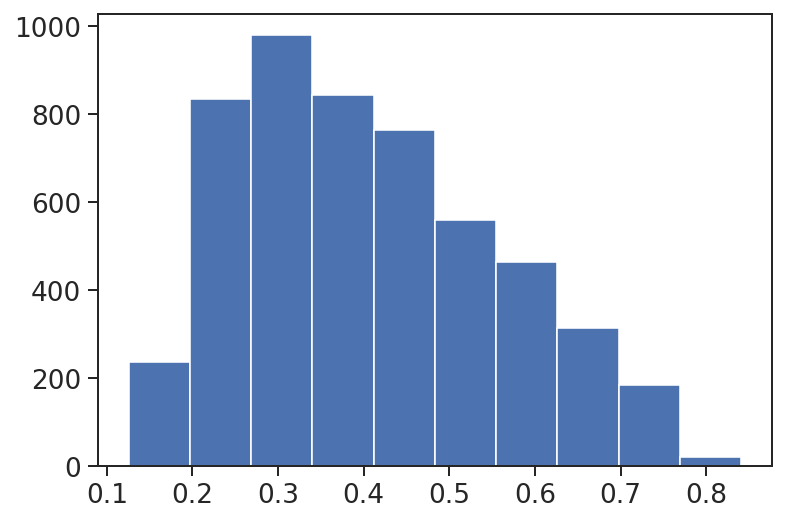

In [75]:
plt.hist(mean_original_exp)

(array([236., 834., 979., 843., 765., 560., 464., 314., 184.,  21.]),
 array([5.93630077e-05, 9.31961996e-05, 1.27029392e-04, 1.60862583e-04,
        1.94695775e-04, 2.28528967e-04, 2.62362159e-04, 2.96195351e-04,
        3.30028543e-04, 3.63861735e-04, 3.97694927e-04]),
 <BarContainer object of 10 artists>)

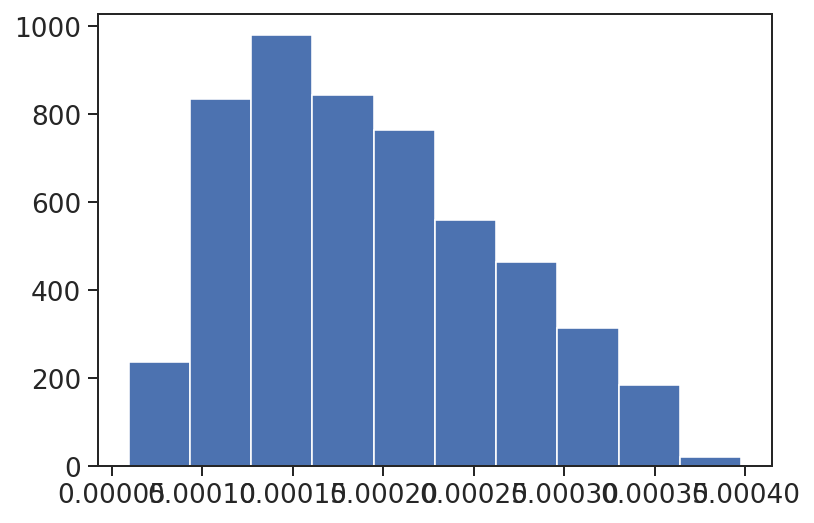

In [81]:
pre_process = mean_original_exp/sum(mean_original_exp)
plt.hist(pre_process)

No handles with labels found to put in legend.


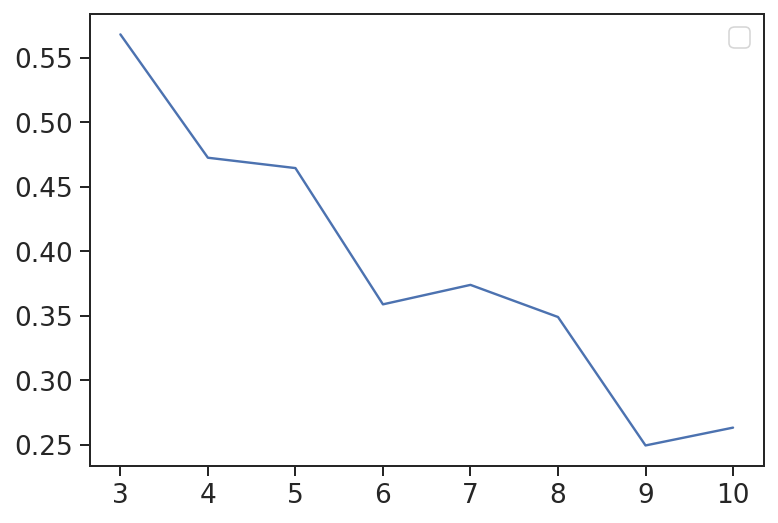

In [84]:
Ks = [3,4,5,6,7,8,9,10]

k_test_score = []
for each in Ks:

    kmeans4 = KMeans(n_clusters=each, random_state=0).fit(full_gradient_pre2_mean)
    
    #param_score.append(metrics.silhouette_score(new_param,kmeans2.labels_) ) 
    k_test_score.append(metrics.silhouette_score(gradient,kmeans4.labels_) ) 

%matplotlib inline
plt.figure()
plt.plot(Ks,k_test_score)


plt.show()

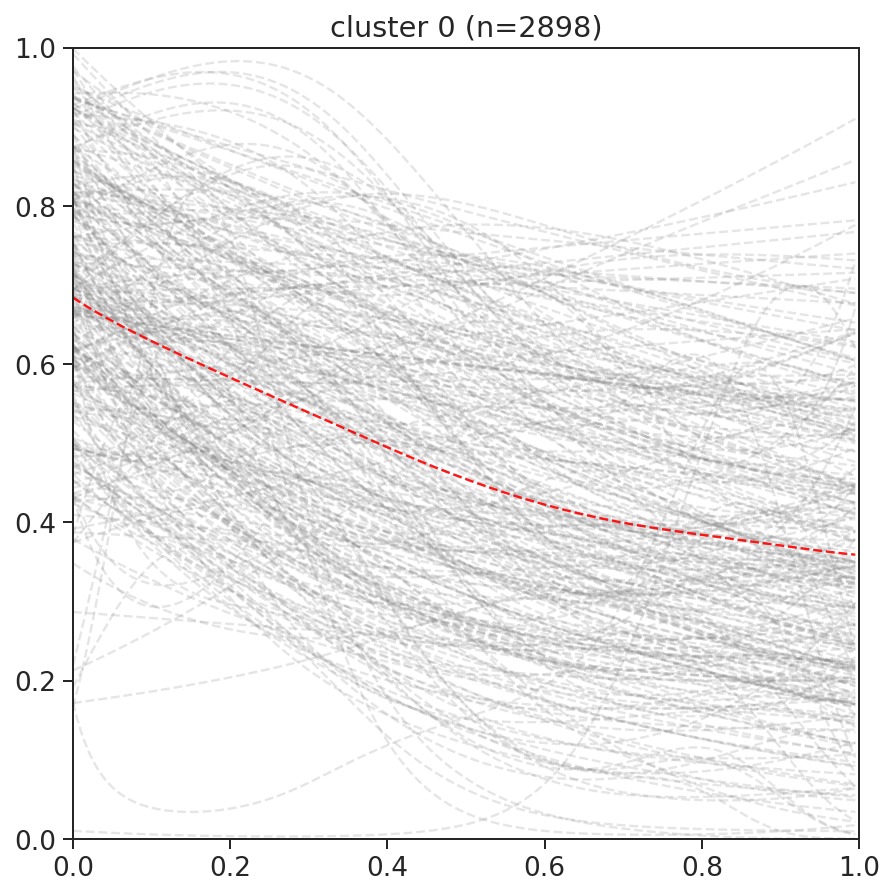

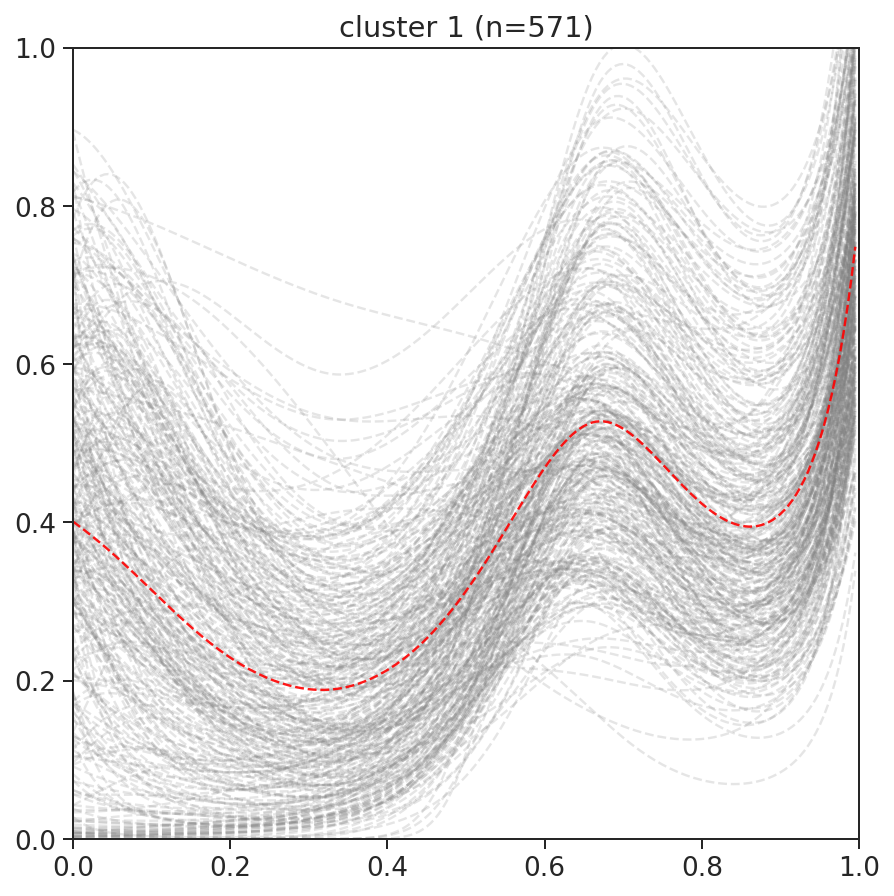

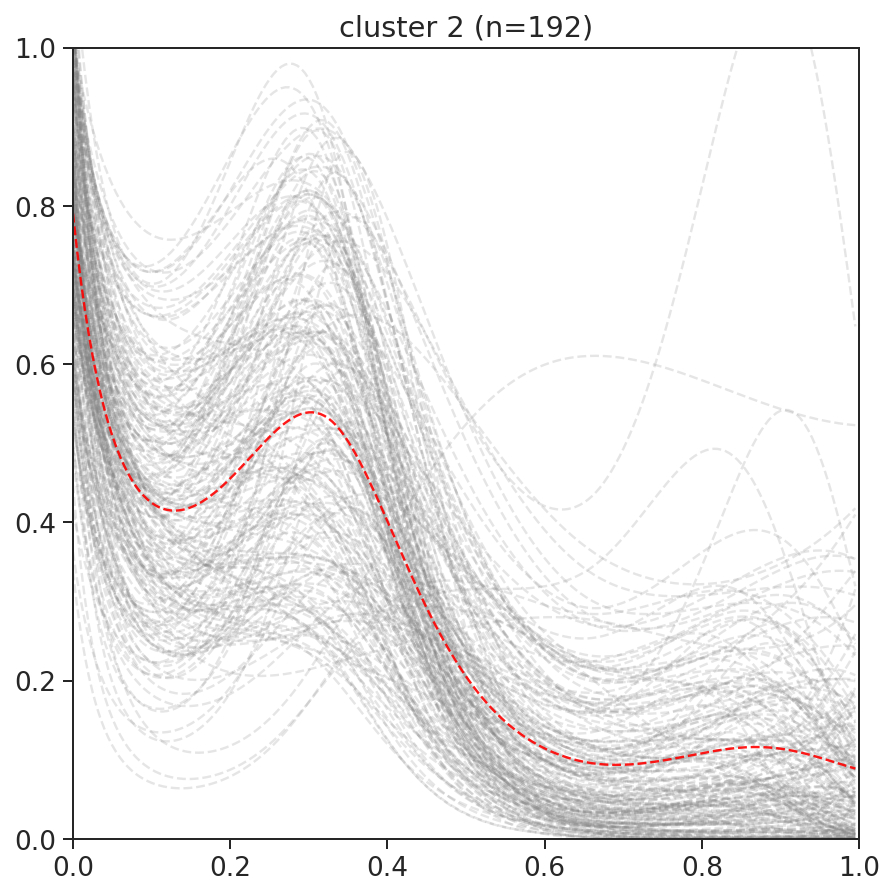

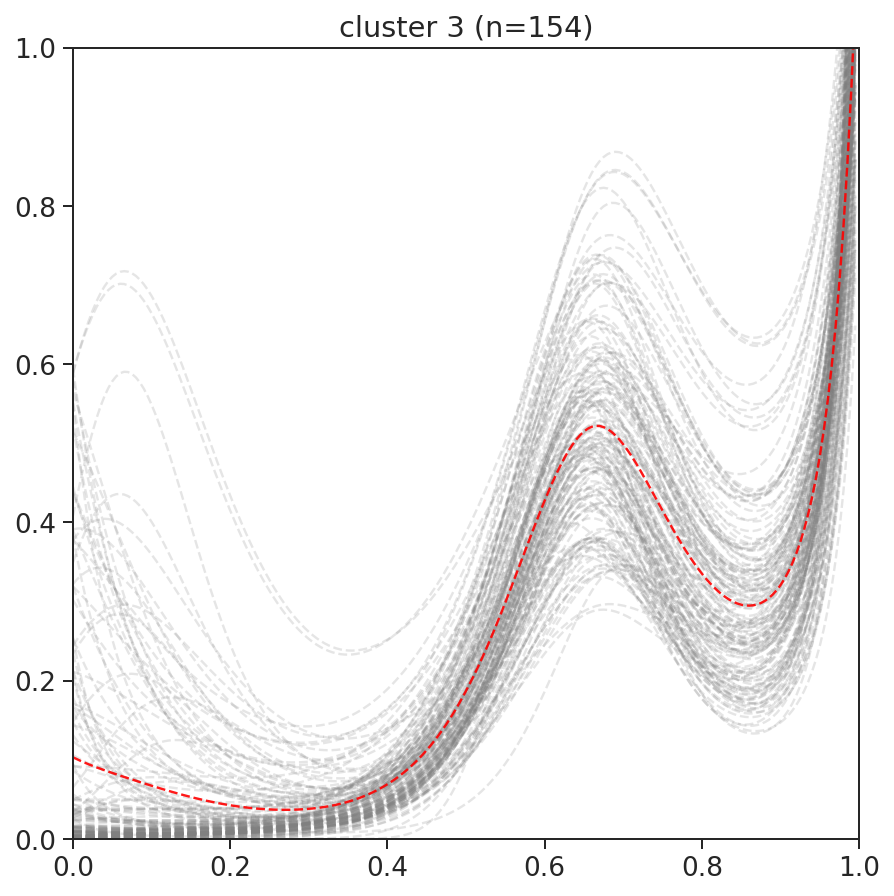

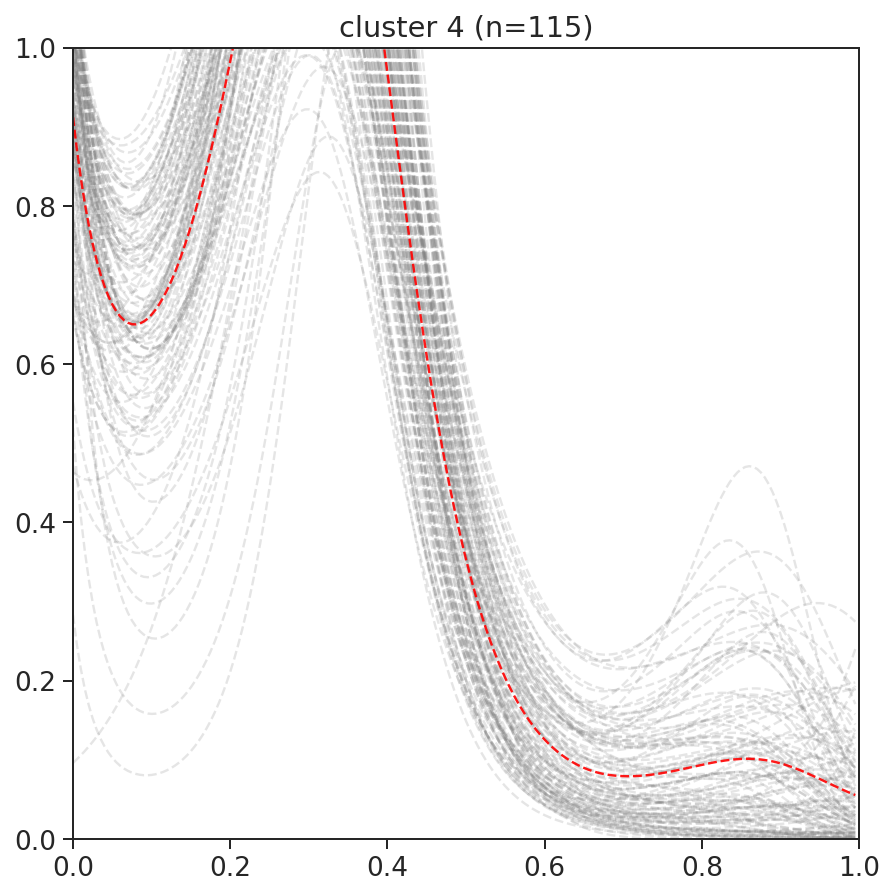

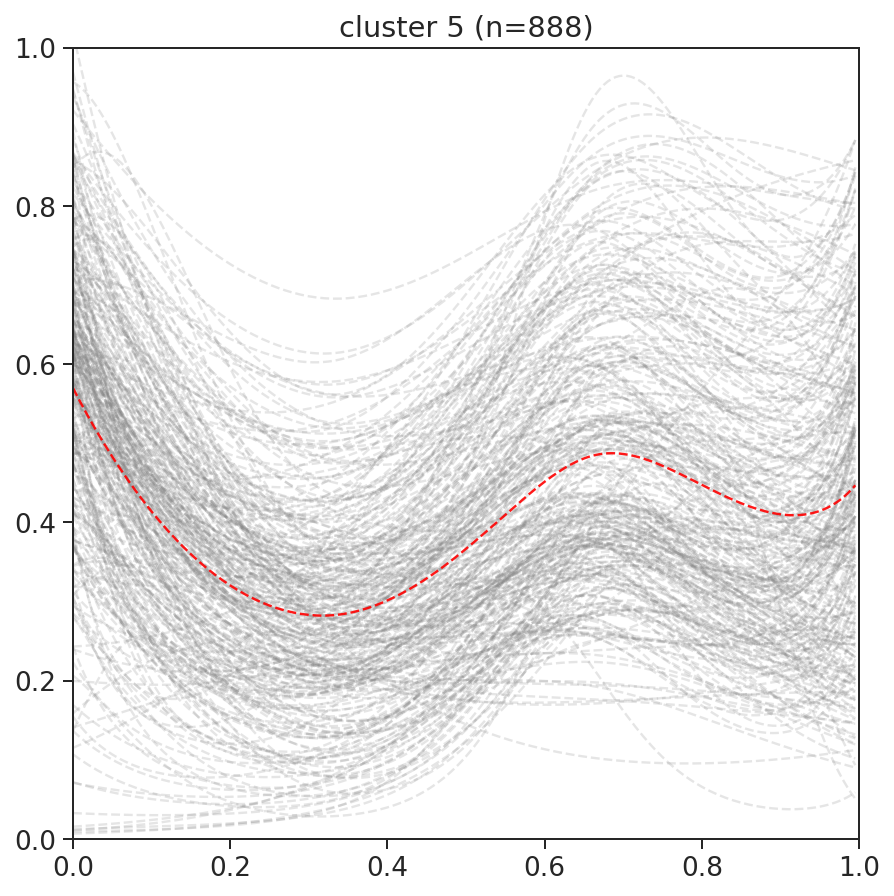

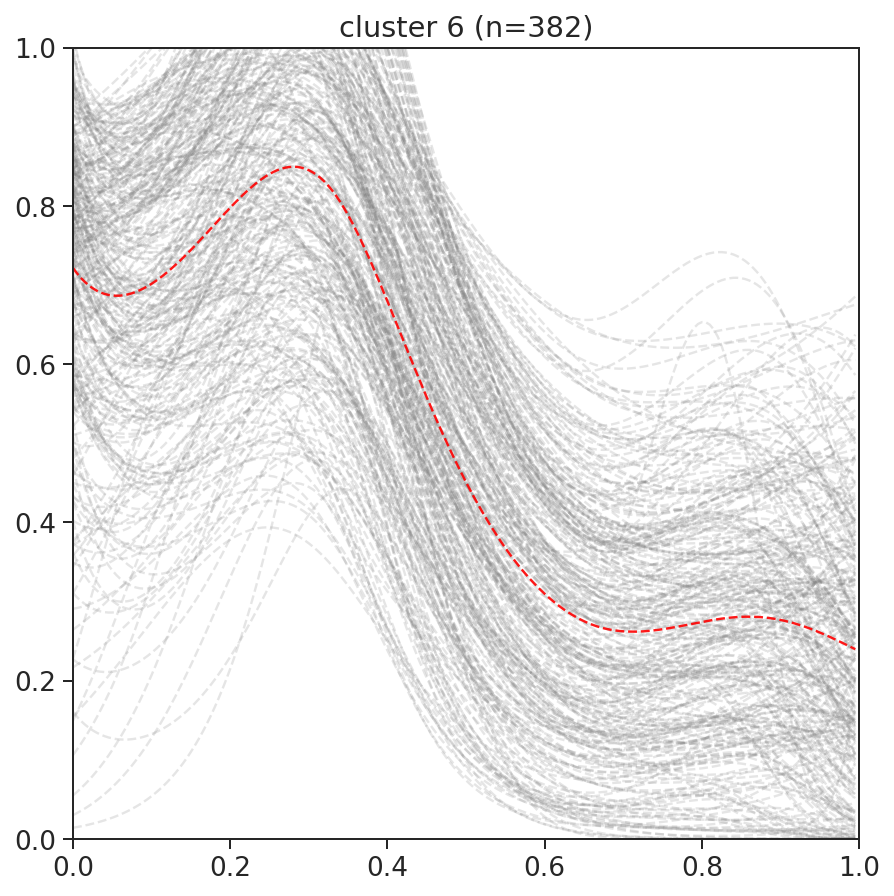

In [83]:
full_gradient_pre2_mean = np.concatenate((gradient,np.array(pre_process2).reshape(5200,1)),axis = 1)

pre2_mean_7k = KMeans(n_clusters=7, random_state=0).fit(full_gradient_pre2_mean)
pre2_mean_7k_label =pd.Series(pre2_mean_7k.labels_, index =qualified_genes)
pre2_7k_means = find_cluster_mean(new_param,pre2_mean_7k_label)
pygam_cluster_plot_v2 (new_param,pre2_mean_7k_label,pre2_7k_means)

In [142]:
from sklearn.mixture import GaussianMixture


gmm = GaussianMixture(n_components=7).fit(minmax_gradient_orig_mean)
gmmlabels = gmm.predict(minmax_gradient_orig_mean)
gmm_cluster =pd.Series(gmmlabels, index =qualified_genes) 
    

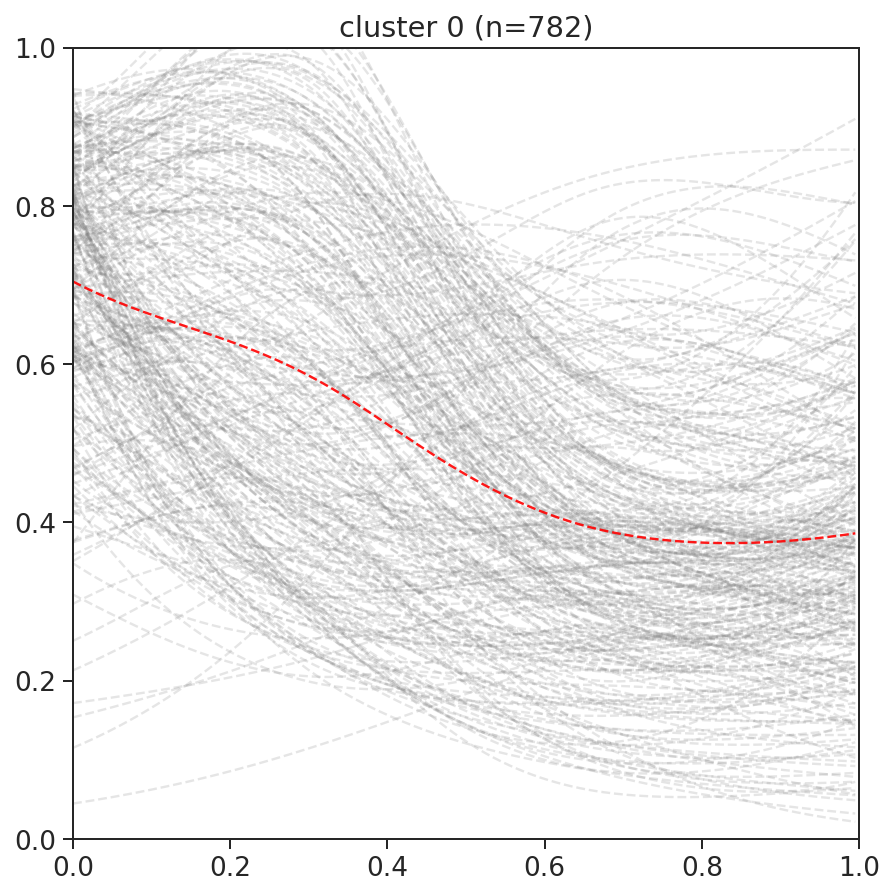

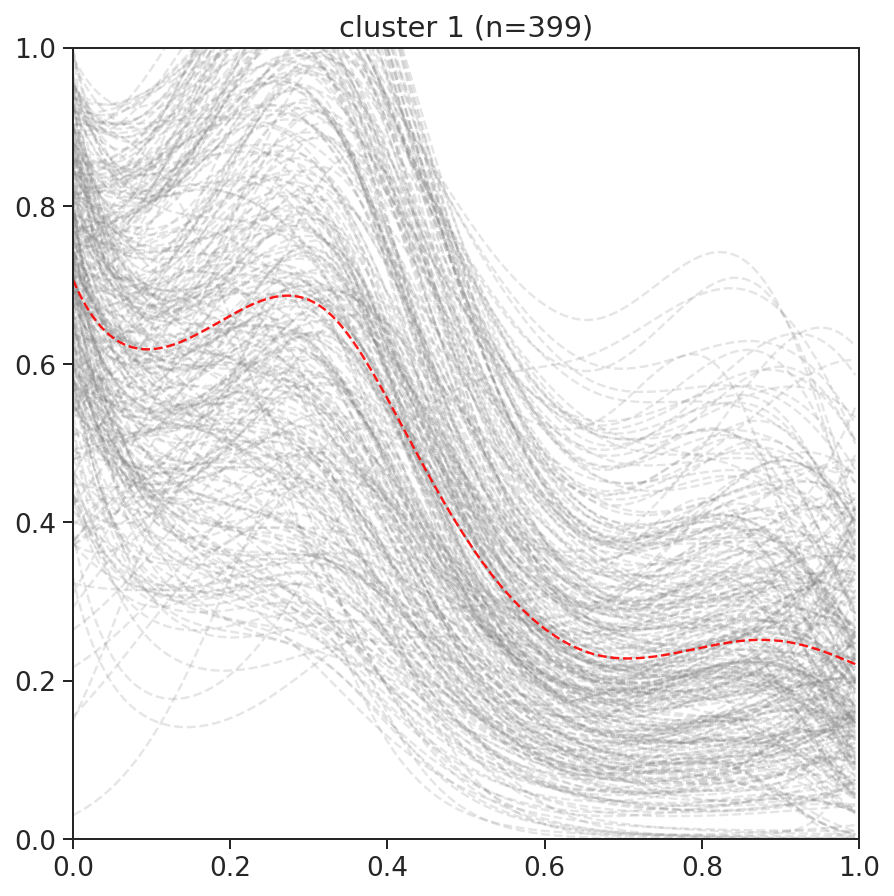

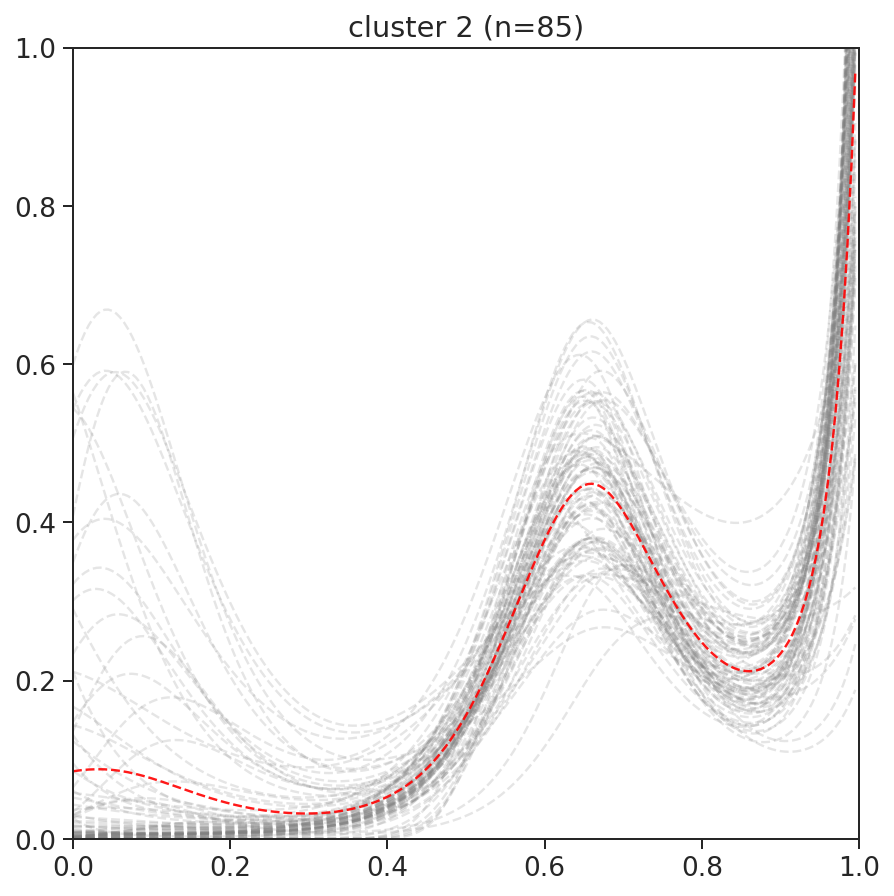

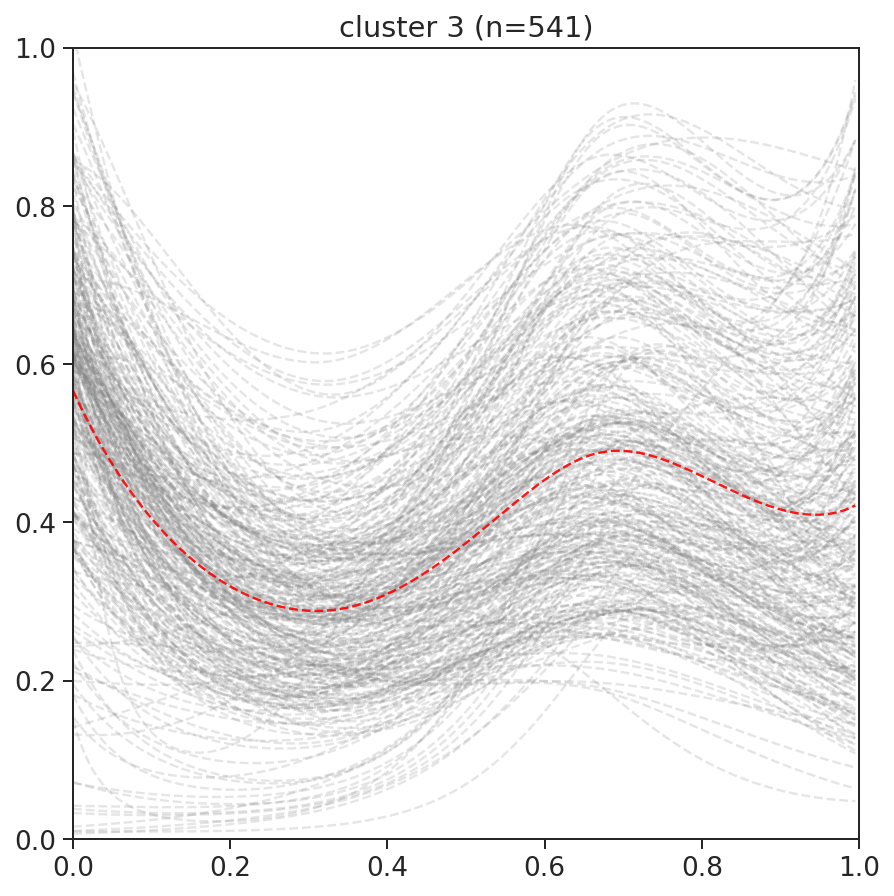

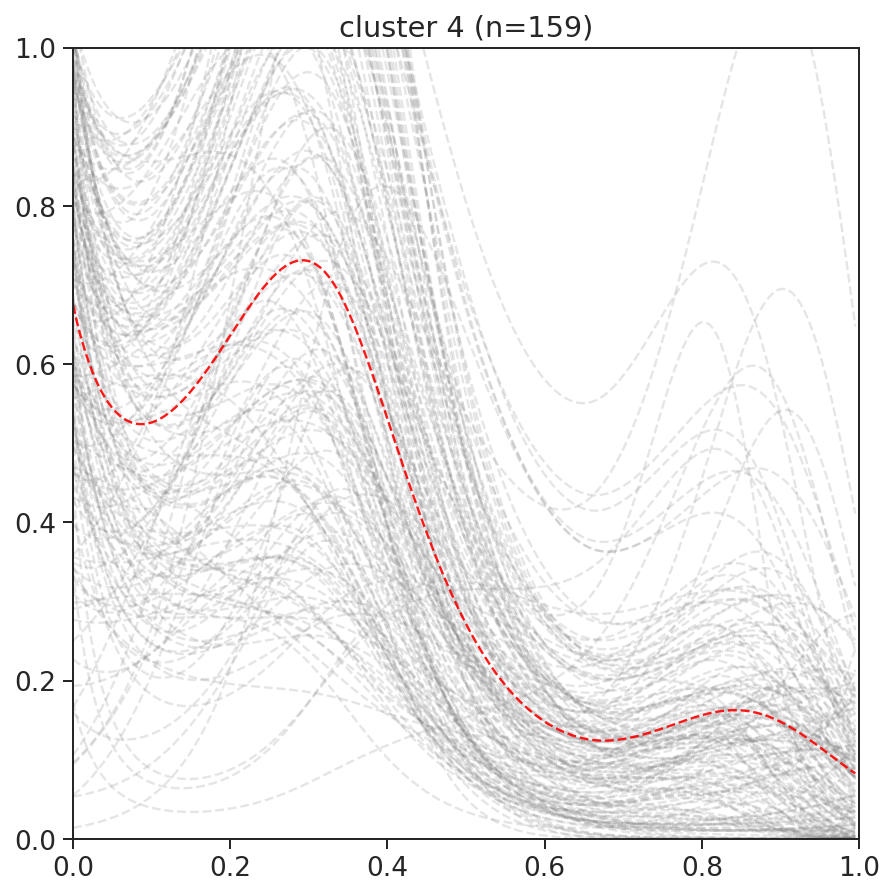

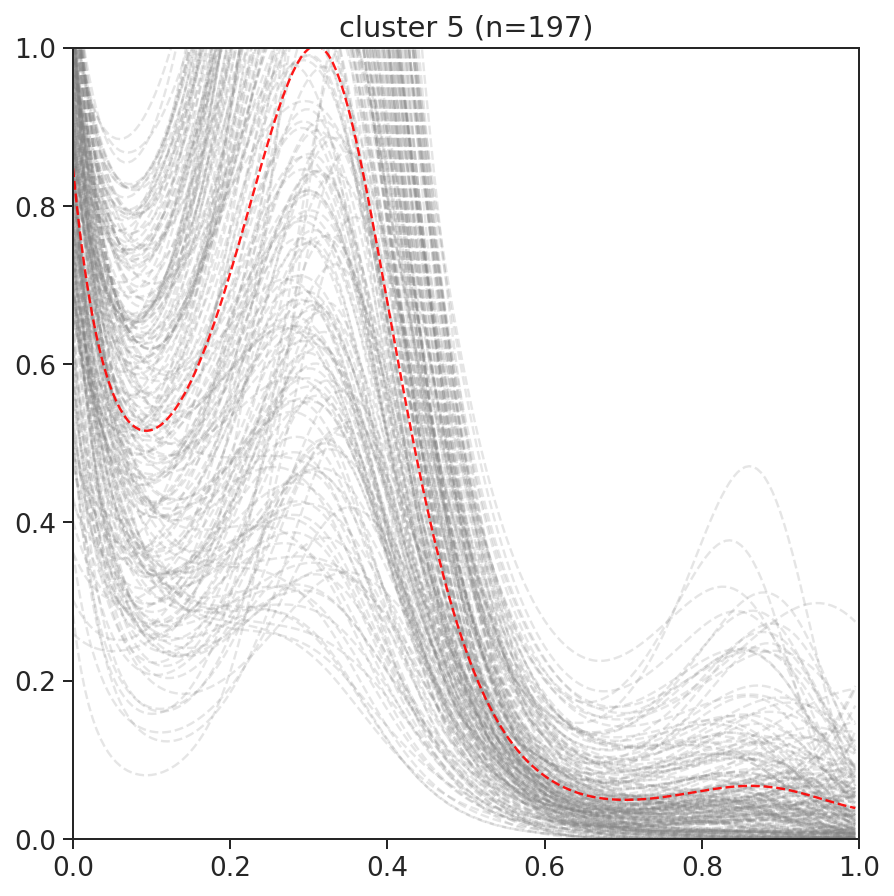

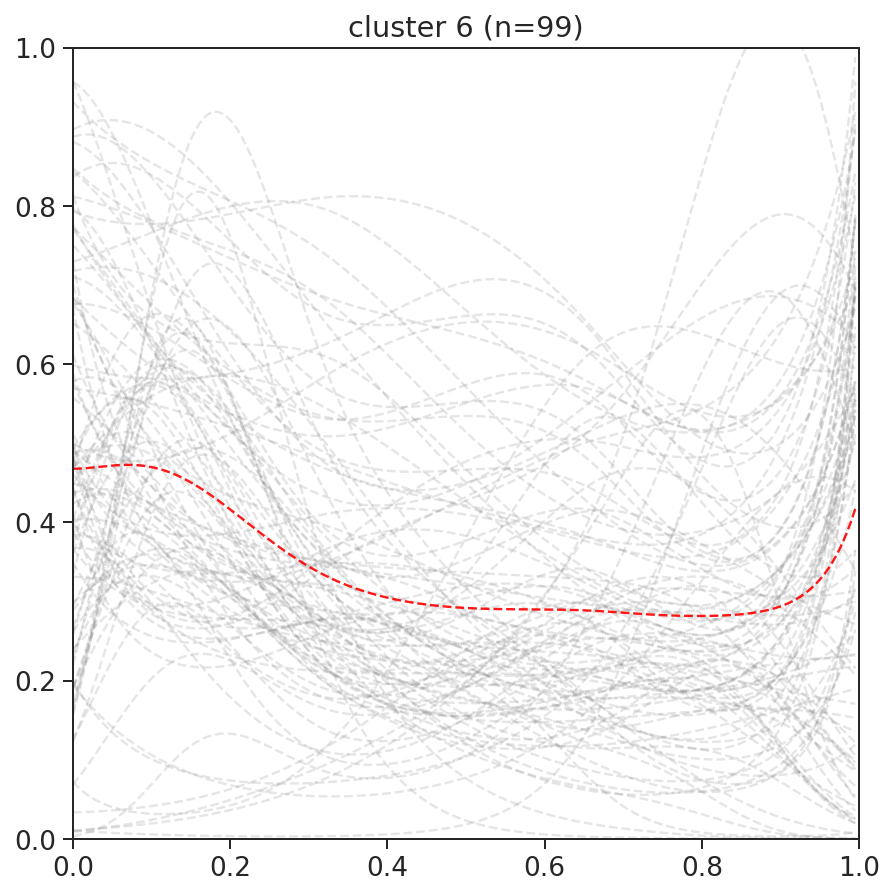

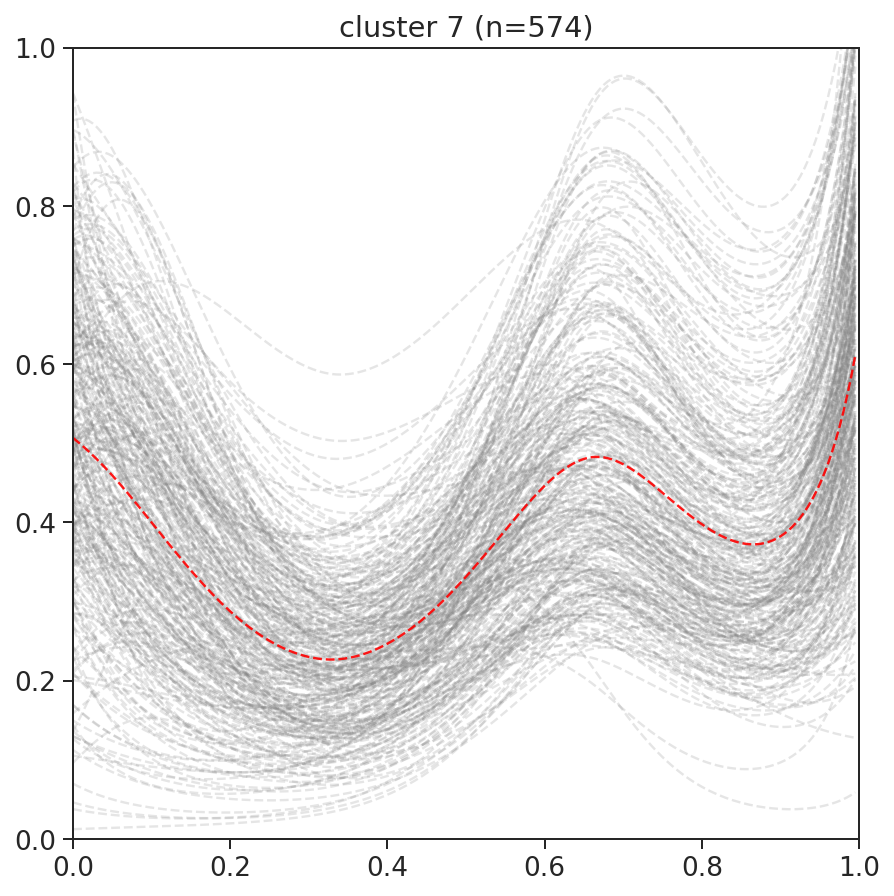

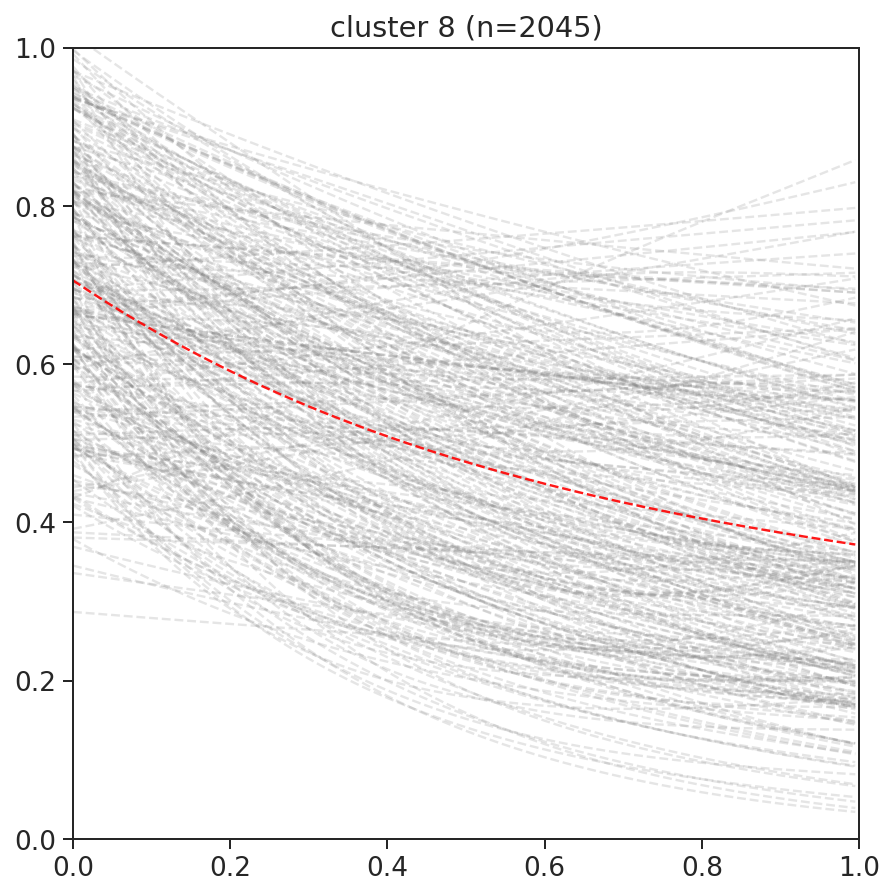

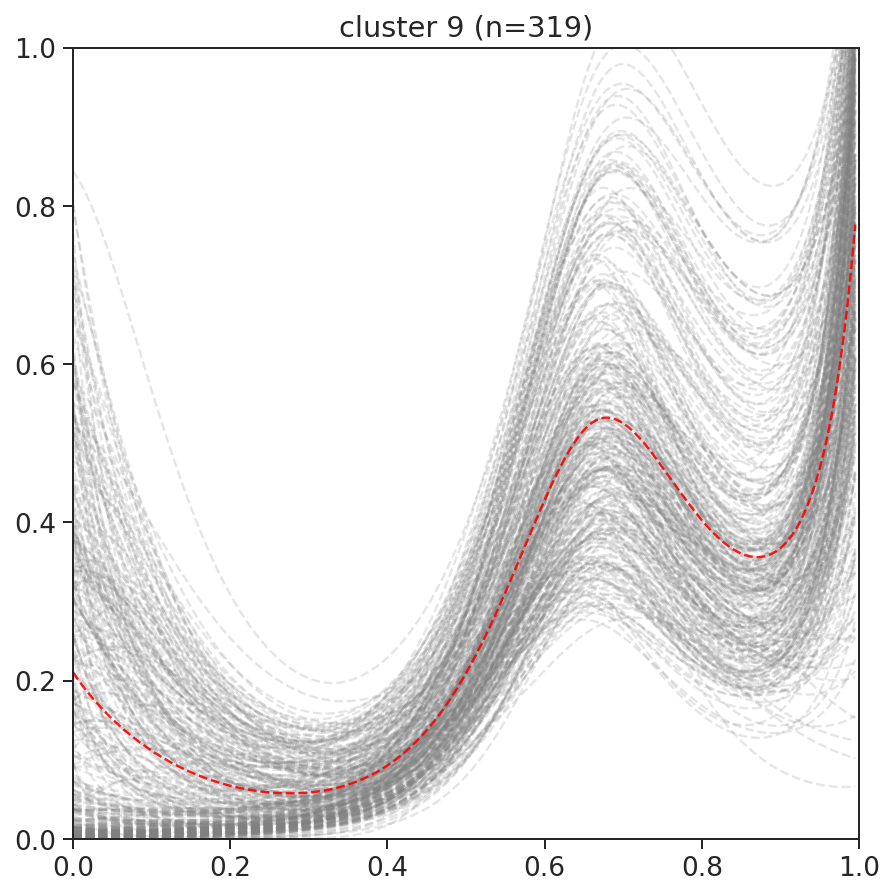

In [146]:
gmm = GaussianMixture(n_components=10).fit(minmax_gradient_orig_mean)
gmmlabels = gmm.predict(minmax_gradient_orig_mean)
gmm_cluster3 =pd.Series(gmmlabels, index =qualified_genes) 

gmm_try3_means = find_cluster_mean(new_param,gmm_cluster3)
pygam_cluster_plot_v2 (new_param,gmm_cluster3,gmm_try3_means)


----

In [379]:
def param_plot(gam_y_values,gene_list):
    n = len(gene_list)
    
    color=iter(cm.rainbow(np.linspace(0,1,n)))   #to generate color
    plt.figure(figsize= (7,5))
    for each in gene_list:
        c=next(color)  # get a different color for each g
        
        ys = gam_y_values.loc[each]
        
        l = len(ys)
        x = np.linspace(0.0, 1.0, num=l, endpoint=False)
        
        plt.plot(x,ys,"--",color = c, alpha = 0.8,label = each) 
    plt.ylim((0,1))
    plt.ylabel('Gene expression level')
    plt.xlabel('Pseudotime')
    plt.legend()
    plt.show()

In [59]:
def find_cluster_mean(imputed_exp,cluster_label):
    genes = cluster_label.index.tolist()
    
    l = imputed_exp.shape[1]
    means = np.empty([0,l])
    
    for c in range(max(cluster_label)+1): 
        
        gene_list = []
        for each in range(len(cluster_label)):
            if cluster_label[each] == c:
                gene_list.append(genes[each])
                
        
        number = len(gene_list)
        
        if number < 300:
            sample = number
        else: 
            sample = 300
            
        samples = np.empty([0,l])
        
        for i in range(sample):  # len(gene_list) to plot all genes in the cluster #need to change this number according to cluster size

            each = gene_list[i]
            each = np.array(imputed_exp.loc[each]).reshape(1,l)
            samples = np.concatenate((samples,each),axis = 0)

            
        samples = np.mean(samples, axis=0).reshape(1,l)
        
        means =  np.concatenate((means,samples),axis = 0)   
    return means
    

In [132]:
# ok pack into function : )

highly_variable = adata.var['highly_variable'][adata.var['highly_variable'] == True].index.tolist()


def pairs_from_each_cluster(normed_imp,cluster_label,highly_variable,c = 0,exp_cut_off = 0.25,trending_cut_off_high = 0.75,trending_cut_off_low = 0.45):
    '''
    need to explain the function here later...
    gene_in_cluster: a list of genes that were clustered together 

    '''
    
    gene_in_cluster = []
    gene_in_high_variable = []
    for each in range(len(cluster_label)):
    #loop thru each gene
        if cluster_label[each] == c:
            gene_in_cluster.append(cluster_label.index[each])
            if cluster_label.index[each] in highly_variable:
                gene_in_high_variable.append(cluster_label.index[each])
        #plt.figure(figsize=(7,7))
    
    
    length = len(gene_in_high_variable)
    pairs_find = []
    gene_info = dict()
    for num1 in range(length):
        pocky = gene_in_cluster[num1]
        pocky = normed_imp.loc[(normed_imp[pocky] >= exp_cut_off)].index.tolist()
        #in_inp = len(set(pocky).intersection(set(INP)))
        
        if len(pocky) == 0:
            continue
        gene_info[gene_in_cluster[num1]] = {"exp in cell":len(pocky)}
        #if in_inp/len(pocky) > 0.75:  # filter out gene mostly expressed in INP
            #continue
        
        for num2 in range(num1+1,length):
            oreo = gene_in_cluster[num2]
            oreo = normed_imp.loc[(normed_imp[oreo] >= exp_cut_off)].index.tolist()
            if len(oreo) == 0:
                continue
            
            merge = set(pocky)|set(oreo)
            inter = set(pocky).intersection(set(oreo))
            if len(inter) == 0:
                continue
            
            inter_in_pocky = set(pocky).intersection(inter)
            percent_pocky = len(inter_in_pocky)/len(pocky)
            inter_in_oreo = set(oreo).intersection(inter)
            percent_oreo = len(inter_in_oreo)/len(oreo)
            #if (percent_pocky > 0.75) or (percent_oreo > 0.75): #filter out pairs where most intersection in one gene
                #continue
                
            
            #in_inp = len(set(inter).intersection(set(INP))) #filter out pairs where most intersection in INP
            #if in_inp/len(inter) > 0.75:
                #continue
            
            if trending_cut_off_high> len(inter)/len(merge) > trending_cut_off_low:
                pairs_find.append((gene_in_cluster[num1],gene_in_cluster[num2],len(inter),len(merge),len(inter)/len(merge)))
            
    


    return pairs_find, gene_info

In [109]:
cluster0_4k_pairs,cluster0_4k_gene_info = pairs_from_each_cluster(normed_imp,g_4k_cluster,highly_variable,c = 0)

In [145]:
def leiden_cell_type_dict (adata):
    '''
    return a dictionary key = leiden cell type ; value = cell_ids that is in the leiden cell type
    '''
    numer_of_leiden_type  = adata.obs['leiden'].unique()
    
    leiden_cell_type = dict()
    for each in numer_of_leiden_type:
        cells_ids = adata[adata.obs['leiden'] == each].obs.index 
        leiden_cell_type[each] = cells_ids.tolist()
        
    return leiden_cell_type
        
leiden_cellids_dict = leiden_cell_type_dict (adata)

In [187]:
def each_cluster_spread_cell_filter(normed_imp,cluster_label,highly_variable,leiden_cellids_dict,c = 0,exp_cut_off = 0.1):
    '''
    find genes that are expressed in all cell types
    leiden_cellids_dict: dictionary from "leiden_cell_type_dict" function
    

    '''

    widely_spread = []
    partialy_exp = []
    
    
    gene_in_cluster = []
    gene_in_high_variable = []
    
    for each in range(len(cluster_label)):

        if cluster_label[each] == c:
            gene_in_cluster.append(cluster_label.index[each])
            if cluster_label.index[each] in highly_variable:
                gene_in_high_variable.append(cluster_label.index[each])
        
    
    
    length = len(gene_in_high_variable)
    
    for num1 in range(length):
        pocky = gene_in_high_variable[num1]
        pocky = normed_imp.loc[(normed_imp[pocky] >= exp_cut_off)].index.tolist()
        
        if len(pocky) == 0:
            continue
        
        leiden_check = 0
        for each in leiden_cellids_dict:
            all_ids = leiden_cellids_dict[each]
            num_all_ids = len(all_ids)
            num_exped = len(set(pocky).intersection(set(all_ids)))
            if num_exped/num_all_ids > 0.05:
                leiden_check +=1
        
        if leiden_check > 10:   #0.75*16 = 12
            widely_spread.append(gene_in_high_variable[num1])
            
        else:
            partialy_exp.append(gene_in_high_variable[num1])
            

    return widely_spread, partialy_exp



In [188]:
c2_widely_exp_test,c2_part_exp_test = each_cluster_spread_cell_filter(normed_imp,g_4k_cluster,highly_variable,leiden_cellids_dict,c = 2,exp_cut_off = 0.2)

In [ ]:
c2_part_exp_edges_v2 = []
for each in c2_part_exp_paris_v2:

    twin = (each[0],each[1])
    c2_part_exp_edges_v2.append(twin)
c2_part_exp_edges_graph_v2 = nx.Graph()
c2_part_exp_edges_graph_v2.add_edges_from(c1_edges)
plt.figure(figsize=(22, 22))
nx.draw(c2_part_exp_edges_graph, with_labels=True, font_weight='bold')
plt.show()
plt.savefig("c2_part_exp_edges_v2.pdf")

In [212]:
with open("c2_part_exp_paris.txt", "w") as f:
    for g in c2_part_exp_paris:
        f.write(str(g) +"\n")

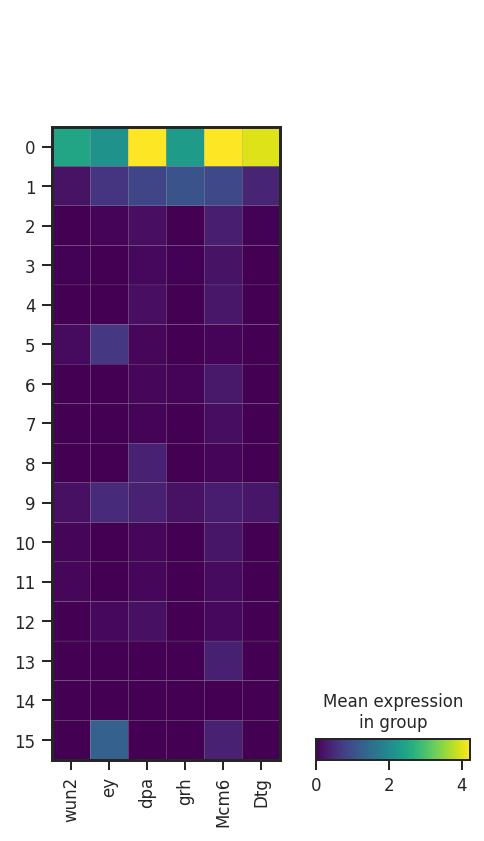

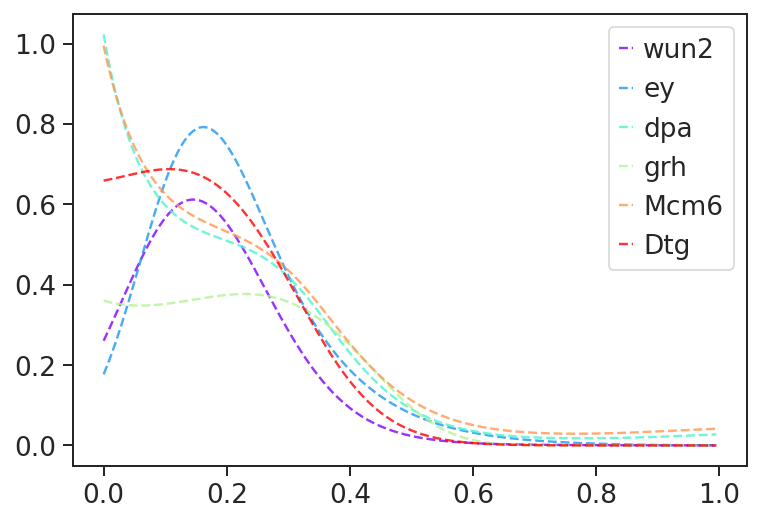

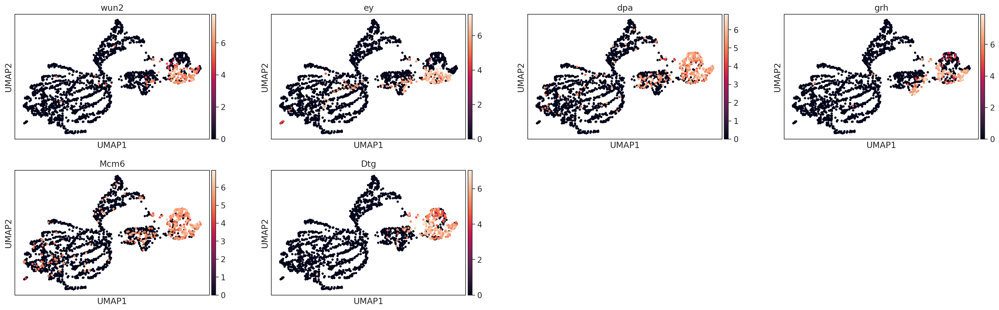

In [275]:
small_network = ["wun2","ey","dpa","grh",'Mcm6',"Dtg"]
sc.pl.matrixplot(adata,small_network, groupby='leiden')
param_plot(new_param,small_network)
sc.pl.umap(adata, color=small_network, wspace=0.2, legend_loc="on data")

---

end states: Index(['TGTTACTGTACATTGC'], dtype='object')

TGTTACTGTACATTGC
Time for processing TGTTACTGTACATTGC: 0.004712196191151937 minutes


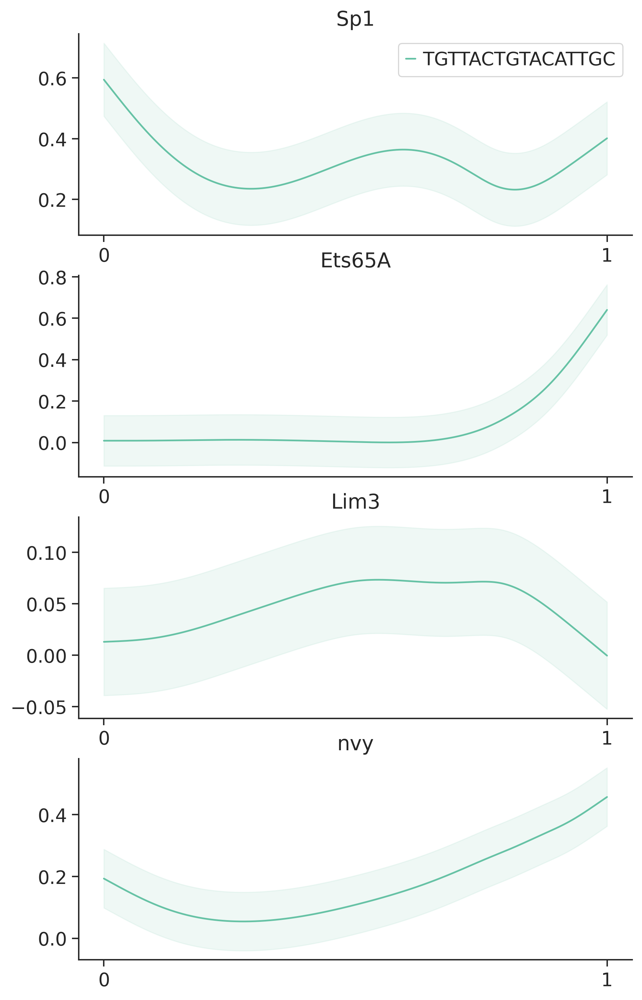

In [5]:
#validation of pseudotime calc
print("end states:",pseudotime_dict['res'].branch_probs.columns)
print()
end_point = pseudotime_dict['res'].branch_probs.columns[0] 

gene_list_validation = ["Sp1", "Ets65A", "Lim3", "nvy"]
gene_trends_validation = palantir.presults.compute_gene_trends(pseudotime_dict['res'], normed_imp.loc[:,gene_list_validation],n_jobs=1)
palantir.plot.plot_gene_trends(gene_trends_validation)

In [10]:
### code relates to cell type
cell_type_list  = adata.obs['leiden'].unique()

def find_gene_mean_exp_for_cell_type(cell_type_list,normed_df):
    i = 0
    leiden_type_gene_exp_dict= {}
    for each_cate in cell_type_list:
        print("category: ",each_cate)
        leiden_type_cells = adata[adata.obs['leiden'] == each_cate].obs.index     #get cells in each category
        leiden_type_gene_exp = normed_df.loc[leiden_type_cells]    #get gene exp for those cells
        gene_exp_dict = leiden_type_gene_exp.mean(axis = 0).to_dict()
        leiden_type_gene_exp_dict['leiden_type_'+str(i)] = gene_exp_dict
        i+=1
    return leiden_type_gene_exp_dict

In [ ]:
### pair validation plot

from scipy.stats import gaussian_kde

def pseudo_time_weight_plot_threshold_kde (pseudo_time_stuff,gene_list,weight,num_spline=6,spline_o=3,lamda= 0.6,thre = 0.7,yu=6.0,yd = -1):
    pr_res = pseudo_time_stuff["res"]
    imp_df = pseudo_time_stuff["imp"]
    x = pr_res.pseudotime  #pseudo time for 2033 cells
    x = x.values.reshape(len(x),1)   #cuz one feature, array size(2033,) will run into error
    
    for i in range(len(gene_list)):
        g = gene_list[i]
        #print(g)
        y = imp_df[g]  #magic imputed data for "Sp1"
        gam = LinearGAM(s(0, n_splines = num_spline,spline_order =spline_o ,lam =lamda))
        gam.gridsearch(x,y,weights = weight)
        
        list_x = x.tolist()
        crop_x = []
        crop_y = []
        for j in range (len(y)):
            if weight[j] >= thre:
                crop_x.append(list_x[j][0])
                crop_y.append(y[j])
        #kde part
        xy = np.vstack([crop_x,crop_y])
        z = gaussian_kde(xy)(xy)
        

        plt.figure(figsize=(3,3))
        xx = gam.generate_X_grid(term = 0)
        
        predict_gam = gam.predict(X =xx) # set subzero values to zero for the red line 
        sub_z_index = predict_gam<0
        predict_gam[sub_z_index] = 0
        
        conf = gam.confidence_intervals(X =xx,width = 0.95)  # set subzero confidence values to zero for the red line
        sub_z_index = conf<0
        conf[sub_z_index] = 0
        
        plt.figure(figsize= (6,3))

        plt.plot(xx,predict_gam,'r--')  #plt.plot(xx,gam.predict(X =xx),'r--')
        plt.plot(xx,conf,c = "b",ls="--")   #plt.plot(xx,gam.confidence_intervals(X =xx,width = 0.95),c = "b",ls="--")
        #plt.scatter(crop_x,crop_y,facecolor = 'gray',edgecolor = 'none',alpha = 0.2)
        sns.scatterplot(x = crop_x,y = crop_y,hue = z,legend=None, palette = 'inferno',marker = '.',linewidth = 0,alpha = 0.6)
        
        n = plt.Normalize(z.min(),z.max())
        sm = plt.cm.ScalarMappable(cmap = 'inferno',norm = n)
        sm.set_array([])
        plt.colorbar(sm).set_label(label = 'point density',size = 12)
        height = yu+0.5
        bottom = yd-0.5
        plt.ylim(bottom,height)
        
        #plt.title(g)
        plt.title(g+", "+str(num_spline)+" splines")